In [1]:
# importing the needed packages

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import ticker, cm
import seaborn as sns

from scipy.stats import zscore

from math import ceil
from collections import Counter

from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, OneHotEncoder
from sklearn.impute import KNNImputer
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import DBSCAN, KMeans
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_score, silhouette_samples, calinski_harabasz_score, davies_bouldin_score

import missingno as msno
import plotly.express as px

import textwrap

from yellowbrick.cluster import InterclusterDistance

import graphviz

<div class="alert alert-block alert-info">

# Hotel Customer Segmentation
    
</div>

- Ana Sofia Mendes, number: 20220687
- Ana Sofia Mendonça, number: 20220678
- Beatriz Sousa, number: 20220674
- Sofia Vieira, number: 20220676
- Vasco Fontoura, number: 20220556

**GOAL**: Identify customer segments.

Some code was adapted from our projects for Data Mining Curricular Unit.

<a id = "toc"></a>

1. [Data Understanding](#data-understanding)
2. [Data Preparation](#data-preparation)
3. [Modelling](#modelling)
4. [Evaluation](#evaluation)

<a id = "data-understanding"></a>
    
## 1. Data Understanding

<a id = "understanding-index"></a>

- [1.1. Import the datasets](#import-datasets)
- [1.2. Copy the datasets](#copy-datasets)
- [1.3. Variable types](#variable-types)
- [1.4. Descriptive statistics](#descriptive-statistics)
- [1.5. Visualizations](#visualizations)

[Back to TOC](#toc)

<a id = "import-datasets"></a>

### 1.1. Import the datasets

[Back to Data Understanding](#understanding-index)

In [2]:
# importing the dataset, using Pandas function read_csv

df = pd.read_csv('Case1_HotelCustomerSegmentation.csv', sep = ';')
df

,ID,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
0,1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.00,82.3,1,...,0,0,0,0,0,0,0,0,0,0
1,2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.00,53.0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.00,0.0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.00,60.0,0,...,0,0,0,0,0,0,0,0,0,0
4,5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.00,0.0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111728,111729,DEU,31.0,36,0x2F59F0E86596B861C3303585FDB7F090B1B2D70442C5...,0x86AC02B9393E7F58354BA4193D792C07DB91D4BE27C7...,0,0.00,0.0,0,...,0,0,0,0,1,0,0,0,0,0
111729,111730,BRA,43.0,36,0x2708B9F11C95F384129152CDF0830B566F02D42B87AC...,0xE87DEB08B0D7D0BDC590949FF04AAA893018BD8EB714...,170,755.25,20.0,0,...,0,0,0,0,1,0,0,0,0,0
111730,111731,BRA,37.0,36,0xEF5F6AAA6120F2AC49179E16FD12477C243A8F4FC504...,0x74B9B5A554F5F660371E56D4CE4C1D4C3DC80AE71D68...,0,0.00,0.0,0,...,0,0,0,0,1,0,0,0,0,0
111731,111732,DEU,48.0,36,0xC70AE03F615CB96B0C84CF29419C2DDFE8EC64B77104...,0xF589C016E6988AECD3E3BE793E7D606BBDB6B6D4795C...,66,708.00,185.0,0,...,0,0,0,0,0,0,0,0,0,0


The `ID` uniquely identifies each one of the observations, so should be the index on the Pandas dataframe.

In [3]:
df.set_index('ID', inplace = True)
df

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.00,82.3,1,0,...,0,0,0,0,0,0,0,0,0,0
2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.00,53.0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.00,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.00,60.0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.00,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111729,DEU,31.0,36,0x2F59F0E86596B861C3303585FDB7F090B1B2D70442C5...,0x86AC02B9393E7F58354BA4193D792C07DB91D4BE27C7...,0,0.00,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
111730,BRA,43.0,36,0x2708B9F11C95F384129152CDF0830B566F02D42B87AC...,0xE87DEB08B0D7D0BDC590949FF04AAA893018BD8EB714...,170,755.25,20.0,0,0,...,0,0,0,0,1,0,0,0,0,0
111731,BRA,37.0,36,0xEF5F6AAA6120F2AC49179E16FD12477C243A8F4FC504...,0x74B9B5A554F5F660371E56D4CE4C1D4C3DC80AE71D68...,0,0.00,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0


<a id = "copy-datasets"></a>

### 1.2. Copy the datasets

[Back to Data Understanding](#understanding-index)

A copy of the original dataset should be created, because during the preprocessing stage we usually try different things, so we should have a copy before doing something wrong with the original data.

In [4]:
df_original = df.copy()

Firstly, we start by checking the shape of our dataset.

In [5]:
df.shape

(111733, 28)

<a id = "variable-types"></a>

### 1.3. Variable types

[Back to Data Understanding](#understanding-index)

In [6]:
# checking the data types of the variables of the dataset and if there are any missing values

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 111733 entries, 1 to 111733
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Nationality           111733 non-null  object 
 1   Age                   107561 non-null  float64
 2   DaysSinceCreation     111733 non-null  int64  
 3   NameHash              111733 non-null  object 
 4   DocIDHash             110732 non-null  object 
 5   AverageLeadTime       111733 non-null  int64  
 6   LodgingRevenue        111733 non-null  float64
 7   OtherRevenue          111733 non-null  float64
 8   BookingsCanceled      111733 non-null  int64  
 9   BookingsNoShowed      111733 non-null  int64  
 10  BookingsCheckedIn     111733 non-null  int64  
 11  PersonsNights         111733 non-null  int64  
 12  RoomNights            111733 non-null  int64  
 13  DistributionChannel   111733 non-null  object 
 14  MarketSegment         111733 non-null  object 
 15  

From this information, it can be seen that variables `Age` and `DocIDHash` have missing values. Regarding the type of the variables, everything seems fine.

<a id = "descriptive-statistics"></a>

### 1.4. Descriptive statistics

[Back to Data Understanding](#understanding-index)

In [7]:
# getting the main descriptive statistics only for the numerical variables

df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,107561.0,45.639191,17.244952,-10.0,33.0,47.0,58.0,123.00
DaysSinceCreation,111733.0,595.026599,374.657382,36.0,288.0,522.0,889.0,1385.00
AverageLeadTime,111733.0,60.833147,85.115320,-1.0,0.0,21.0,95.0,588.00
LodgingRevenue,111733.0,283.851283,379.131556,0.0,0.0,208.0,393.3,21781.00
OtherRevenue,111733.0,64.682802,123.580715,0.0,0.0,31.0,84.0,8859.25
BookingsCanceled,111733.0,0.002282,0.080631,0.0,0.0,0.0,0.0,15.00
BookingsNoShowed,111733.0,0.000600,0.028217,0.0,0.0,0.0,0.0,3.00
BookingsCheckedIn,111733.0,0.737607,0.730889,0.0,0.0,1.0,1.0,76.00
PersonsNights,111733.0,4.328318,4.630739,0.0,0.0,4.0,6.0,116.00
RoomNights,111733.0,2.203825,2.301637,0.0,0.0,2.0,3.0,185.00


The first problem that can be noticed is the maximum value of the variable `Age`, as 123 years does not seem like a reasonable value for the age of the customer. Also, the minimum value of `Age` is impossible, maybe due to a imputation error.

`LodgingRevenue` and `OtherRevenue` have outliers, due to the Bill Gates effect, as the maximum value seems true, but really different from the majority of the other ones.

`AverageLeadTime` also has an incoherence (in the minimum value), since it cannot take negative values, so that should be addressed during the data processing phase.

`BookingsCheckedIn`, `PersonsNights` and `RoomNights` have highly skewed distributions, as it can be seen in the difference between the third quartile and the maximum value. 

Regarding the other statistics of the variables everything seems fine.

In [8]:
# getting the main descriptive statistics for the remaining cathegorical variables

df.describe(include = ['O']).T

,count,unique,top,freq
Nationality,111733,199,FRA,16516
NameHash,111733,107584,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,75
DocIDHash,110732,103480,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,3032
DistributionChannel,111733,4,Travel Agent/Operator,91019
MarketSegment,111733,7,Other,63680


From this information, it can be concluded that the majority of the customers are French, normally make bookings at the hotel through a travel agent/operator, and belong the the classification 'other' currently in the market segmentation. 

It can be seen that there are almost 200 different nationalities. If we are going to transform this variable into a numeric one using One Hot Encoding, 198 categories will be created, which can be problematic because of the "Curse of Dimensionality". So, one solution can be group the nationalities according to geographic regions.

As `DocIDHash` should be unique for each observation, and being the Hash code presented above repeated 3000 times, we interpreted this as a missing value, that should be enconded properly.

In [9]:
# checcking value counts for categorical variables

df['DistributionChannel'].value_counts()

Travel Agent/Operator    91019
Direct                   16883
Corporate                 3135
GDS Systems                696
Name: DistributionChannel, dtype: int64

In [10]:
# checcking value counts for categorical variables

df['MarketSegment'].value_counts()

Other                    63680
Direct                   16363
Travel Agent/Operator    16353
Groups                   11461
Corporate                 2931
Complementary              657
Aviation                   288
Name: MarketSegment, dtype: int64

Regarding variable `DistributionChannel` the category 'GDS Systems' is not as well represented as 'Travel Agent/Operator', and as for `MarketSegment` the same happens with 'Aviation' and 'Complementary'. 

In [11]:
# exploration of categorical variables: cross table of MarketSegment and DistributionChannel

market_vs_distribution = pd.crosstab(index = df['MarketSegment'], columns = df['DistributionChannel'])
market_vs_distribution

DistributionChannel,Corporate,Direct,GDS Systems,Travel Agent/Operator
MarketSegment,,,,
Aviation,281,0,0,7
Complementary,19,510,0,128
Corporate,2204,51,2,674
Direct,13,15970,7,373
Groups,482,171,5,10803
Other,37,151,677,62815
Travel Agent/Operator,99,30,5,16219


It is useful to analyse together the two categorical variables `DistributionChannel` and `MarketSegment`, because it seems that they give redundant information. The majority of the dataset is considered to be from the  market segment 'Other' and usually uses 'Travel Agent/Operator' method as their channel to make bookings at the hotel. 

<a id = "incoherences"></a>

### 1.5. Incoherences

[Back to Data Understanding](#understanding-index)

If `RoomNights` is different from 0, then `PersonNights` should be different from 0 as well, and vice-versa. So they should be deleted. 

In [12]:
# room nights and person nights should both be 0 or neither be 0 

df[((df['PersonsNights'] == 0) & (df['RoomNights'] != 0)) | ((df['PersonsNights'] != 0) & (df['RoomNights'] == 0))]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
43674,NLD,33.0,641,0x65E5986F79B75C8A171FEEA2E534AAD806D5ACB083D6...,0x67D8A25C96313AEF8A5842A87F2F6AB29DE01DAC80BE...,41,267.0,109.0,0,0,...,0,0,0,0,0,1,0,0,0,0
80037,BRA,35.0,336,0x0596170AE19299CB3CEBA98BC2FAF9BF5333031C6A32...,0x8186236B5A280E296DC622D0B419BBEBB5BC8E1D4338...,63,242.0,24.0,0,0,...,0,0,0,1,1,0,0,0,0,0
85781,USA,67.0,259,0xD0C14D44BB72D7FA9673B2EE2EE9C8021EBDF81A7EF0...,0x420A533D66150B9173FAB8F5AF0DB8C54EBDFA001663...,1,314.4,141.1,0,0,...,0,0,0,0,1,0,0,0,0,0
90375,DEU,52.0,214,0xFC913F891030DD576FDA085E7859D44AB7EE8B000D59...,0x050B3FEBB73D2924810D9C068846F14550B03BCFDC7C...,36,2514.0,103.5,0,0,...,0,0,0,0,0,0,0,0,0,0


Customers that never cancelled, never "no-showed", and never actually checked-in are an incoherences, and could be linked to situations where the employees needed to make adjustments of previous transactions (previous stays), or the customers only registered in the hotel (through the website or loyalty program) but never actually made a booking. We decided that these customers are not suited for customer segmentation, however we should consider that these customers, specially the more recent ones, had incentives to come to the hotel's website and register themselves or look for additional information. So, we can address them with a more general marketing approach, or a questionaire.

In [13]:
# people that are not "active" customers (have never been to the hotel)

df[(df['BookingsCanceled'] == 0) & (df['BookingsNoShowed'] == 0) & (df['BookingsCheckedIn'] == 0)]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,JPN,50.0,1385,0x94DB830C90A6DA2331968CFC9448AB9A3CE07D7CFEDD...,0x47E5E4B21585F1FD956C768E730604241B380EDFEA68...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,FRA,43.0,1385,0x44BB41EF2D87698E75B6FBB77A8815BF48DAA912C140...,0x6C456E45A78A20BC794137AE326A81D587B6528B3944...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
11,IRL,28.0,1385,0x606584F7B9D6A1905BF9B7ED7B7EBE5DF17DF22FECDF...,0xCA46CD508DB3DB2085374141177E07ECEC4B724AE41C...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111724,ITA,56.0,37,0x82277FA4AD074DA9786E64E977C94FEF1C2E47CD6212...,0x5ED6055421E857EA3496D4C75FA2237ACD353DB1B64B...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
111726,PAN,60.0,37,0xAA3529E305173010BADE927C7015FA091C3883D257E9...,0xDC47997245A7B9ACF9D4974149D2100CEB00981A2F03...,0,0.0,0.0,0,0,...,0,0,0,0,0,1,1,0,0,0
111729,DEU,31.0,36,0x2F59F0E86596B861C3303585FDB7F090B1B2D70442C5...,0x86AC02B9393E7F58354BA4193D792C07DB91D4BE27C7...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0


We expect that all customers who have made at least a check-in, have positive values for `RoomNights` and `PersonsNights`.

In [14]:
df[(df['BookingsCheckedIn'] > 0) & ((df['RoomNights'] == 0) & (df['PersonsNights'] == 0))]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,


As we can see, lots of children (ages between 0 and 12) are present in the dataset with a profile for themselves. This is a problem, as the objective of this project is to build a customer segmentation and use it to improve the marketing strategy of the hotel. Since we cannot contact these customers, it does not make sense to use them to build the clustering solution. However, we think that with improvements in the dataset itself we can use these profiles to address the parents and accomodate their needs.

In [15]:
df[df['Age'] <= 12]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
35,PRT,4.0,1385,0xD01C4194E347210450E554E5862B791E1DF97238D0DA...,0xB8795BBF0ECC91EBA93C4D34FDC7EE1D04602ECE7172...,0,0.0,0.0,0,0,...,0,0,0,1,0,0,0,0,0,0
82,ESP,4.0,1384,0x56A42753E724C20D97AFC90256FBB406DBEAADD0DBD8...,0xDC0D71D5D2B392DDC83D0065D409681BE9C745ECE97B...,103,653.4,759.6,0,0,...,0,0,0,1,1,0,0,0,0,0
88,ESP,7.0,1384,0xF12F01F9738A807C082A3C58E0B6BCB986D515999726...,0x8840ED8674C90FD4FADDB7C5B687FAC0334EBAFD4E0E...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
118,FRA,11.0,1384,0x1C40278B68CB7CFF59BEEDE27F37EF3FA9230461DDEB...,0xF7380D7E0BA62854874FC5655A7514CE06DA0E5C9648...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
120,FRA,4.0,1384,0x66F4F4697641AD4C2DA372552BBE33662B551AC7770A...,0x252DB51755BF69EA791597ECD2C6DD7F0029CAAEF9D1...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111445,LBN,12.0,39,0x2D30FE8D6F1AF852806FBA2197E9B95EF7737011A904...,0x1B95C70E28C6C0E9301EA6777C451749413A62FCAF26...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
111472,ESP,9.0,39,0xFBA21B216BB35BDEA3951B1EF9BAD6E694B3D92FD586...,0x37E063AB2F610E5E0F2129C1C61E8CCA960C1DC21CC6...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
111495,ESP,8.0,39,0x26113DE7770BFACD12DD3AB50C5761386EC4CAB5C58D...,0x6077B7E310A86FA92B563BB989C3E14333C3FBC0146A...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0


In [16]:
# # WHAT TO DO?

# df[(df['SRCrib'] == 1) & (df['Age'] < 5)].T

<a id = "visualizations"></a>

### 1.6. Visualizations

- [1.6.1. Bar plots](#bar-plots)
- [1.6.2. Histograms](#histograms)
- [1.6.3. Box plots](#box-plots)
- [1.6.4. Numerical variables relationships](#numerical-relationships)

[Back to Data Understanding](#understanding-index)

In [17]:
# defining metric and non-metric features (drop_metric are the variables that will not be included in the visualizations of categorical variables)
# NameHash and DocIDHash will not be plotted as they are almost unique identifiers of the observations

metric_features = ['Age', 'DaysSinceCreation', 'AverageLeadTime', 'LodgingRevenue', 'OtherRevenue', 'BookingsCanceled', 'BookingsNoShowed', 'BookingsCheckedIn', 'PersonsNights', 'RoomNights']
drop_metric = metric_features + ['NameHash', 'DocIDHash']
non_metric_features = df.columns.drop(drop_metric).to_list()

<a id = "bar-plots"></a>

#### 1.6.1. Bar plots

In [18]:
# code adapted from https://stackoverflow.com/questions/31749448/how-to-add-percentages-on-top-of-grouped-bars

def plot_bar(data, nmf, lines, fig_size):
    """
    function that plots a count plot for each non-metric feature
    """
    
    # preparing the figure by create individual axes where each box plot will be placed
    fig, axes = plt.subplots(lines, ceil(len(nmf) / lines), figsize = fig_size, constrained_layout = True)

    # ploting the data
    # iterating across axes objects and associating each box plot:
    for ax, feat in zip(axes.flatten(), nmf):
        graph = sns.countplot(x = data[feat], color = '#8d99ae', ax = ax, order = data[feat].value_counts(ascending = True).index)
        ax.tick_params(axis = 'x', rotation = 45, size = 10)
        ax.set_ylabel('')
        
        for p in graph.patches:
            percentage = '{:.1f}%'.format(100 * p.get_height() / float(len(data)))
            x = p.get_x() + p.get_width() / 2 - 0.20
            y = p.get_y() + p.get_height()
            graph.annotate(percentage, (x, y), size = 10)

    fig.suptitle('Bar plots for all categorical variables', fontsize = 12)

    # showing the plot
    plt.show()

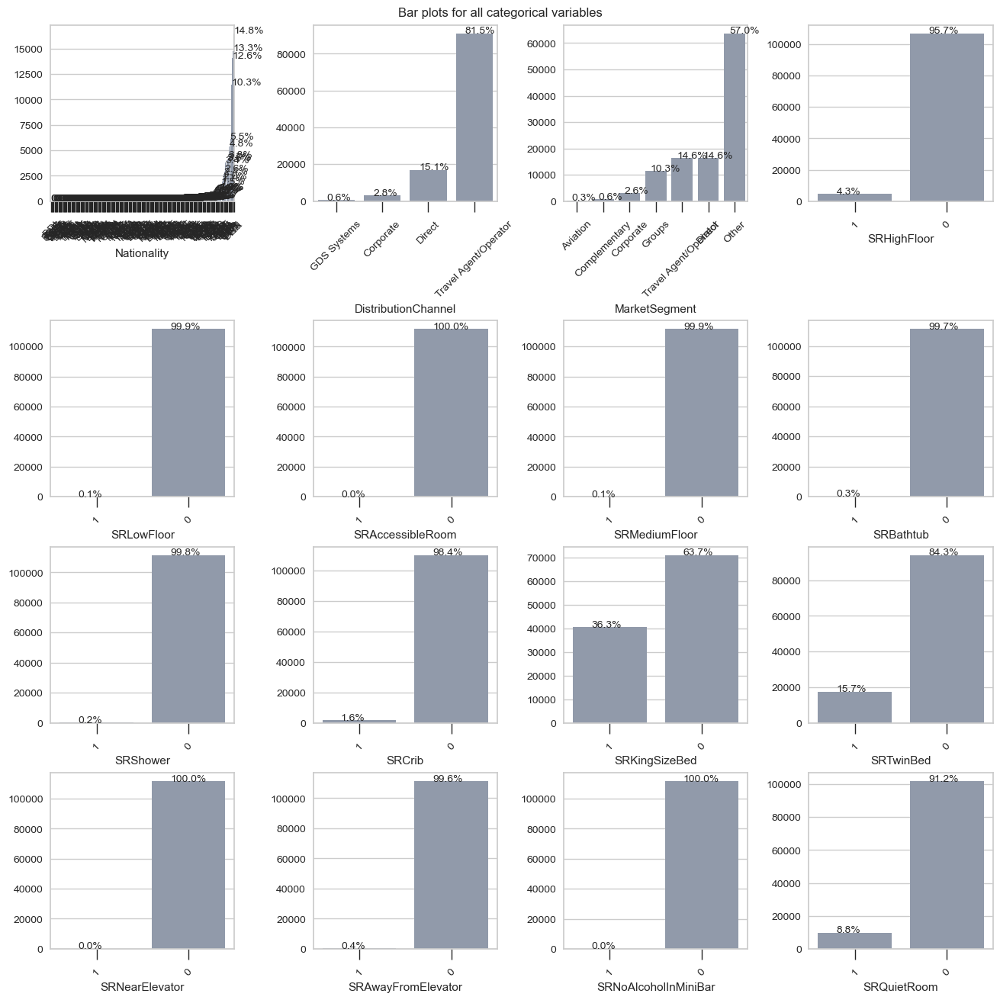

In [19]:
plot_bar(df, non_metric_features, 4, (13, 13))

As it can be seen in the first plot, it is impossible to distinguish the different categories in the nationality because there are almost 200 unique values for this variable (as noted before). So, the nationalities should be grouped into different geographic regions.

Most of the customers do not care about wether the room is in the lower floor or the middle floor, however there are some customers who prefer the high floor. None of the customers decided to request an accessible room, a room near the elevator or no alcohol in the mini bar. 

Regarding the bathroom, some customers specifically asked for a bathtub or for a shower, but they are not really relevant (as their percentage is really small). 

Some customers had preferences regarding the beds, and also the presence of a crib (maybe indicating that they are staying with baby). Also, the silence seems to be an important request for 8.8% of the customers.

The binary variables that have the same value for 99% (or higher) of the dataset will not be considered in the final customer segmentation, as they will not provide useful information for dividing the customers into groups.

<a id = "histograms"></a>

#### 1.6.2. Histograms

Ploting all numeric variables' histograms in one figure, to see some insights.

In [20]:
def plot_histogram(data, mf, lines):
    """
    function that plots a histogram for each numerical feature
    input lines: is to determine the number of lines to configure the plot
    """
    # preparing the figure by creating individual axes where each histogram will be placed
    fig, axes = plt.subplots(lines, ceil(len(mf) / lines), figsize = (15, 6), constrained_layout = True)

    # ploting the data
    # iterating across axes objects and associate each histogram:
    for ax, feat in zip(axes.flatten(), mf):
        ax.hist(data[feat], bins = 20, color = '#8d99ae')
        ax.set_xlabel(feat, fontsize = 10)

    fig.suptitle('Histograms with 20 bins for all numeric variables', fontsize = 12)

    # showing the plot
    plt.show()

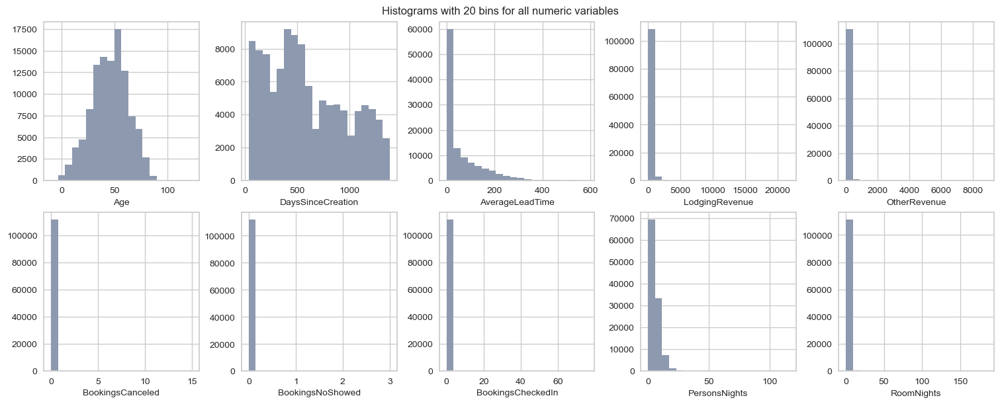

In [21]:
plot_histogram(df, metric_features, 2)

All variables, except `Age` and `DaysSinceCreation` have distributions that are highly influenced by the presence of outliers. After we do the data processing we can repeat these visualizations and see in more detail the behaviour of the variables. `Age` has a bell-shaped distribution, and in `DaysSinceCreation` the recent registrations are more common. 

<a id = "box-plots"></a>

#### 1.6.3. Box plots

Doing the same with box-plots for metric features.

In [22]:
def plot_box(data, mf, lines):
    """
    function that plots a box plot for each numerical feature
    input lines: is to determine the number of lines to configure the plot
    """
    
    # preparing the figure by creating individual axes where each box-plot will be placed
    fig, axes = plt.subplots(lines, ceil(len(mf) / lines), figsize = (15, 6), constrained_layout = True)

    # ploting the data
    # iterating across axes objects and associate each box-plot:
    for ax, feat in zip(axes.flatten(), mf):
        sns.boxplot(x = data[feat], ax = ax, color = '#8d99ae', orient = 'h')
        
    fig.suptitle('Boxplots of all numeric variables', fontsize = 12)

    # showing the plot
    plt.show()

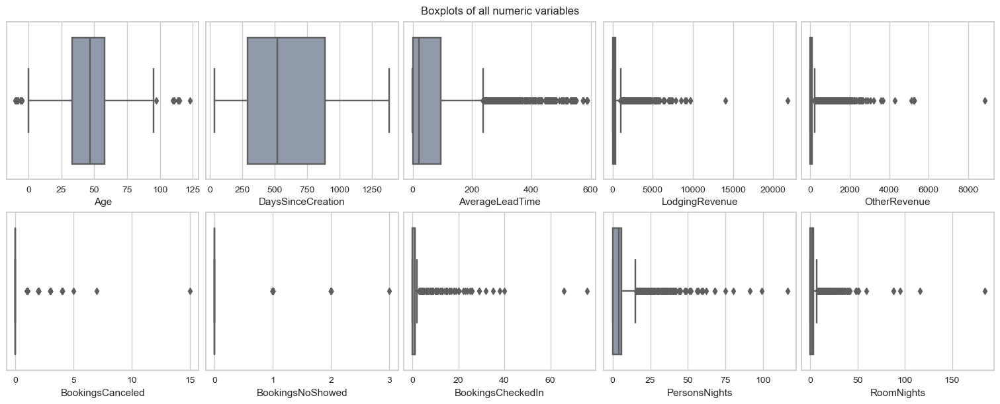

In [23]:
plot_box(df, metric_features, 2)

To complement the information given by the histograms, these box-plots show that the customers that do not show up or that cancel the reservations are rare, and therefore are showed as points (observations outside the IQR "fence").

<a id = "numerical-relationships"></a>

#### 1.6.4. Numerical variables relationships

For numerical variables, analysing the the relationship between all variables (to see some correlations, etc.).

In [24]:
def corr_matrix(data, correlation):
    """ 
    function to plot the correlation matrix in a heat map
    """
    
    # preparing the figure
    fig = plt.figure(figsize = (10, 8))

    # obtaining the correlation matrix, each correlation is rounded to 2 decimal cases
    corr = data.corr(correlation, numeric_only = True).round(2)

    # building annotation matrix (values above |0.5| will appear annotated in the plot)
    mask_annot = np.absolute(corr.values) >= 0.5
    annot = np.where(mask_annot, corr.values, np.full(corr.shape, ''))
    
    # generate a mask for the upper triangle
    mask_upper = np.triu(np.ones_like(corr, dtype = bool))

    # plotting heatmap of the correlation matrix
    sns.heatmap(data = corr, annot = annot, cmap = sns.diverging_palette(220, 10, as_cmap = True), fmt = 's', vmin = -1, 
                vmax = 1, center = 0, square = True, linewidths = .5, annot_kws = {'size': 7}, mask = mask_upper)

    # layout
    fig.subplots_adjust(top = 0.95)
    fig.suptitle(correlation + ' correlation matrix')

    # showing the plot
    plt.show()

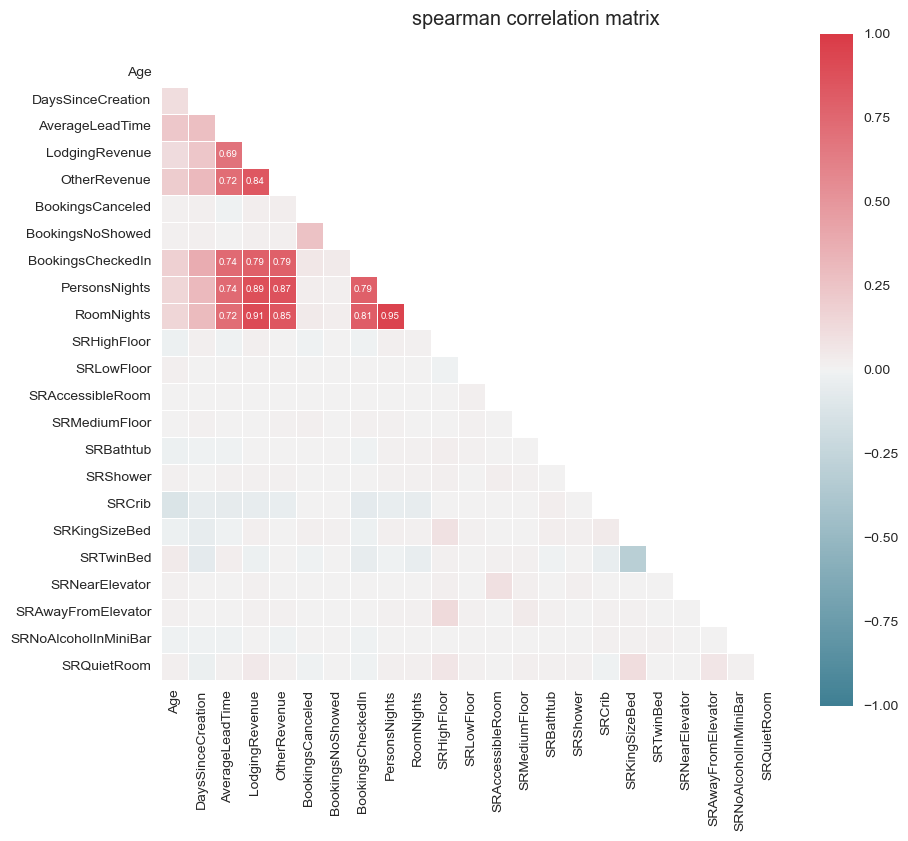

In [25]:
# plotting the correlation matrix

corr_matrix(df, 'spearman')

Some variables are highly correlated, and should not be considered combined for the analysis, as they will provide redundant information. If the threshold considered is 0.75:

- `OtherRevenue` vs. `LodgingRevenue`: 0.84
- `BookingsCheckedIn` vs. `LodgingRevenue`: 0.79
- `BookingsCheckedIn` vs. `OtherRevenue`: 0.79
- `PersonNights` vs. `LodgingRevenue`: 0.89
- `PersonNights` vs. `OtherRevenue`: 0.87
- `RoomNights` vs. `PersonNights`: 0.95, so `RoomNights` will be deleted, because in the context of the problem, knowing if a person travels alone or in big groups seems more important. 
- `RoomNights` vs. `LodgingRevenue`: 0.91, as said before, `RoomNights` will be deleted.
- `RoomNights` vs. `OtherRevenue`: 0.85
- `RoomNights` vs. `BookingsCheckedIn`: 0.81

In general, these correlations can be explained by the behaviour of the customers: people that stay longer will spend more in lodging, and maybe on breakfast or other extras that are included in `OtherRevenue`. Also, people who are richer and spend more in rooms (not for the number of days, but the quality of the room) will tend to spend more on the extras, that is why these two variables are so correlated. We decided to keep them, as they provide different information for the customer segmentation.

In [26]:
def plot_numerical_relationship(data, mf):
    """
    function that plots the pairwise relationship between the numerical variables
    """
    
    # setting pairplot, and in the diagonal of the figure the histograms already plotted before
    chart = sns.PairGrid(data[mf])
    chart.map_upper(sns.scatterplot, color = '#8d99ae')
    chart.map_lower(sns.scatterplot, color = '#8d99ae')
    chart.map_diag(sns.kdeplot, color = '#8d99ae')

    # defining the layout
    plt.subplots_adjust(top = 0.95)
    plt.suptitle('Pairwise Relationship of Numerical Variables')

    # showing the plot
    plt.show()

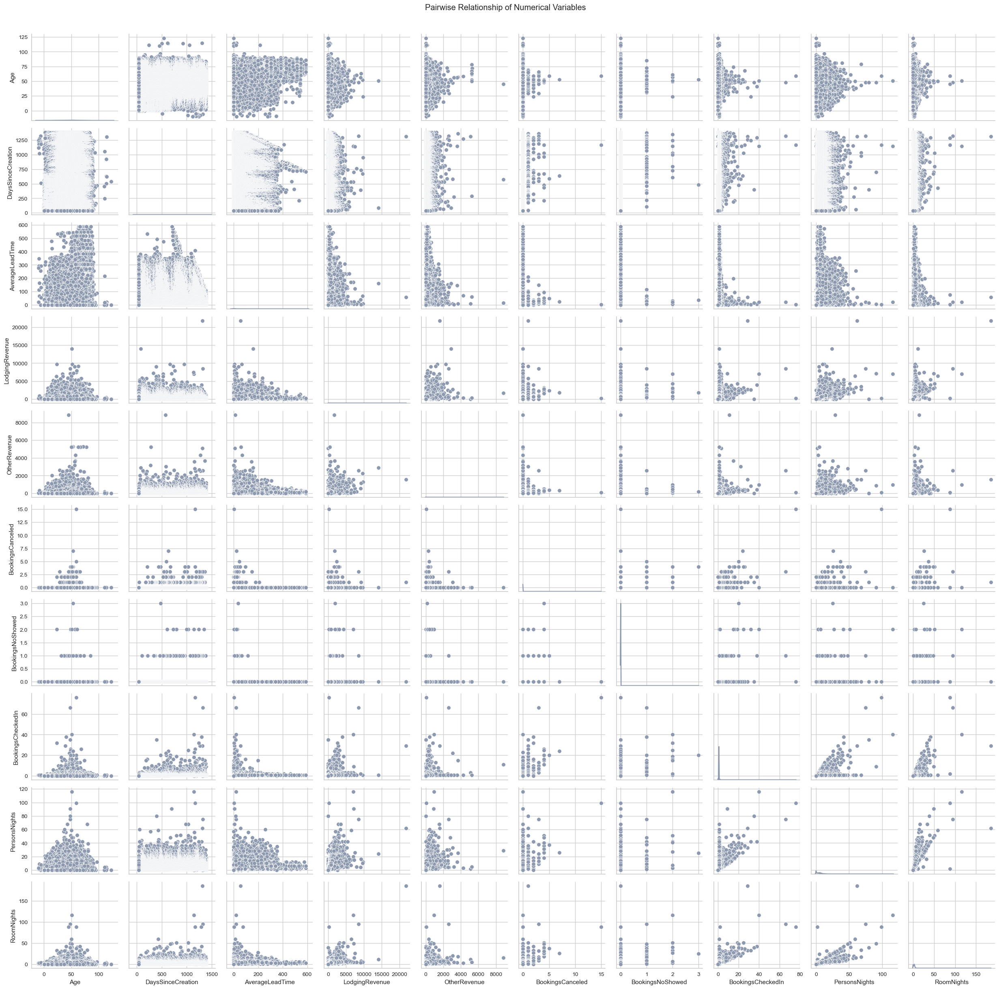

In [27]:
plot_numerical_relationship(df, metric_features)

No meaningful relations can be seen between variables, except for example with `RoomNights` and `PersonsNights`, where seems to exist a positive correlation between the two variables: as the number of persons increases, the number of rooms also increases, which makes sense.

In [27]:
def plot_numerical_relationship_hue(data, mf, categorical_feature):
    """
    function that plots pairwise relationship of numerical variables using a categorical variable hue
    """

    # setting pairplot
    sns.pairplot(df[mf + [categorical_feature]], diag_kind = 'hist', hue = categorical_feature, palette = list(sns.color_palette('colorblind').as_hex())[:7])

    # layout
    plt.subplots_adjust(top = 0.95)
    plt.suptitle('Pairwise Relationship of Numerical Variables by ' + categorical_feature)

    plt.show()

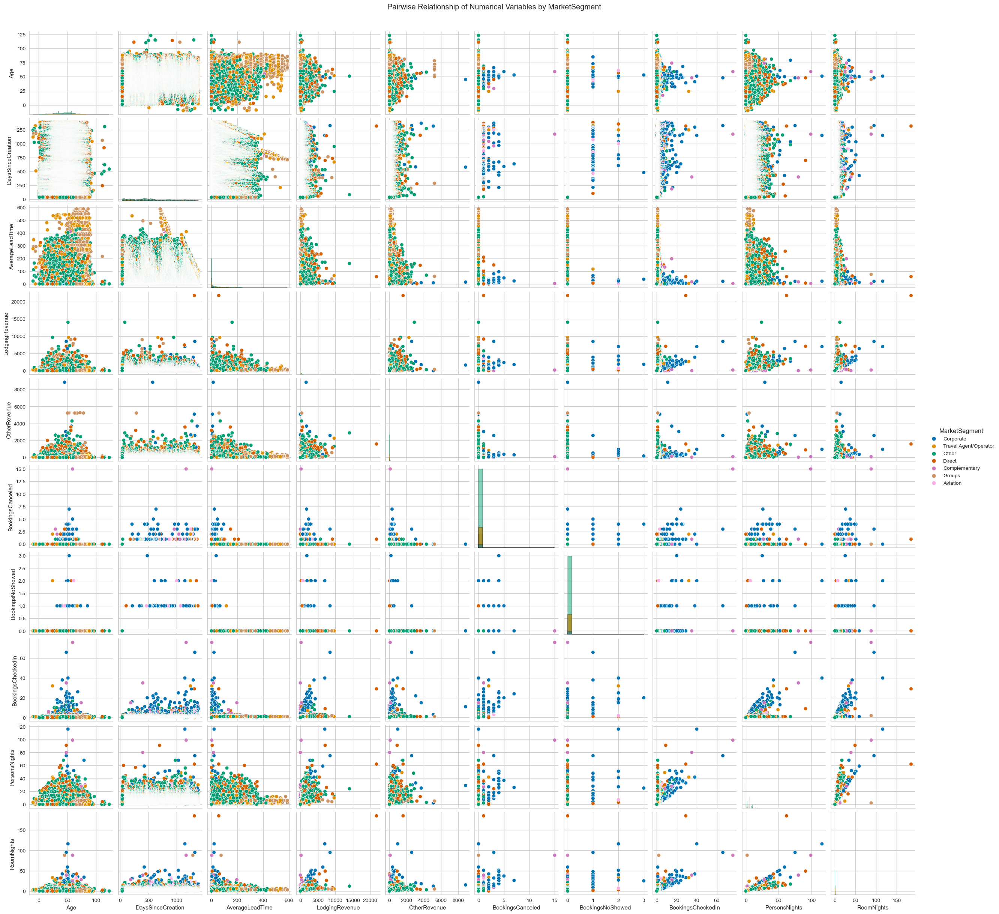

In [29]:
plot_numerical_relationship_hue(df, metric_features, 'MarketSegment')

From this visualization, it can be seen that the old market segmentation does not really provide any useful information regarding the characteristics of the customers, as there is no clear pattern or distinction between the groups of customers, so it makes sense to build a new segmentation (the aim of this project). 

In [28]:
def plot_violin(data, mf, categorical_feature, lines, fig_size):
    """ 
    function that plots the metric features against one non-metric feature to see the discriminatory power
    input:
    - lines: to determine the number of lines to configure the figure
    """
    
    # preparing the figure
    fig, axes = plt.subplots(lines, ceil(len(mf) / lines), figsize = fig_size, constrained_layout = True)

    # ploting the data
    for ax, f in zip(axes.flatten(), mf):
        sns.violinplot(y = categorical_feature, data = data, ax = ax, x = f, palette = ['#8d99ae'], orient = 'h')
        ax.set_ylabel('') 

    # layout
    plt.suptitle('Numeric Variables - Violin Plots by ' + categorical_feature)
    plt.show()

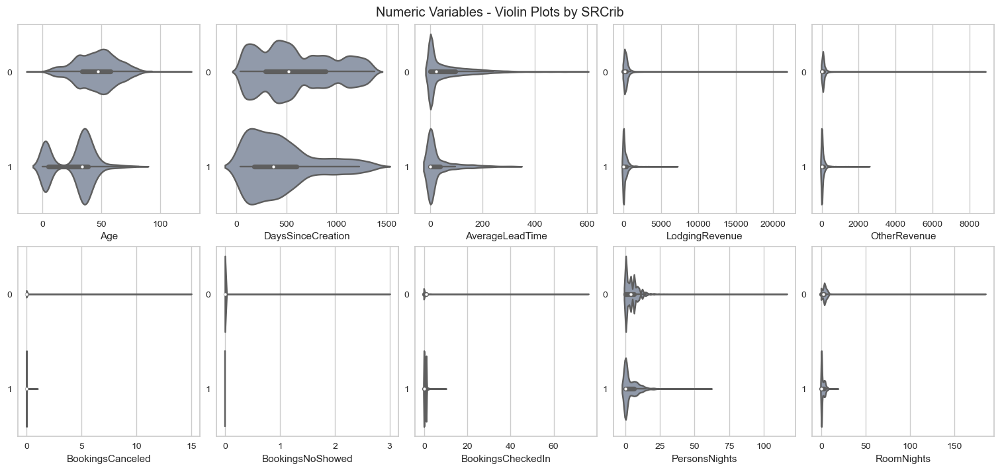

In [29]:
plot_violin(df, metric_features, 'SRCrib', 2, (15, 7))

It can be seen that the distributions of the numerical variables by wether a customer asks for a crib or not do not change significantly. Only worth noting that there is a peak of young customers who ask for a crib, as these reservations can be done by the parents who have babies.

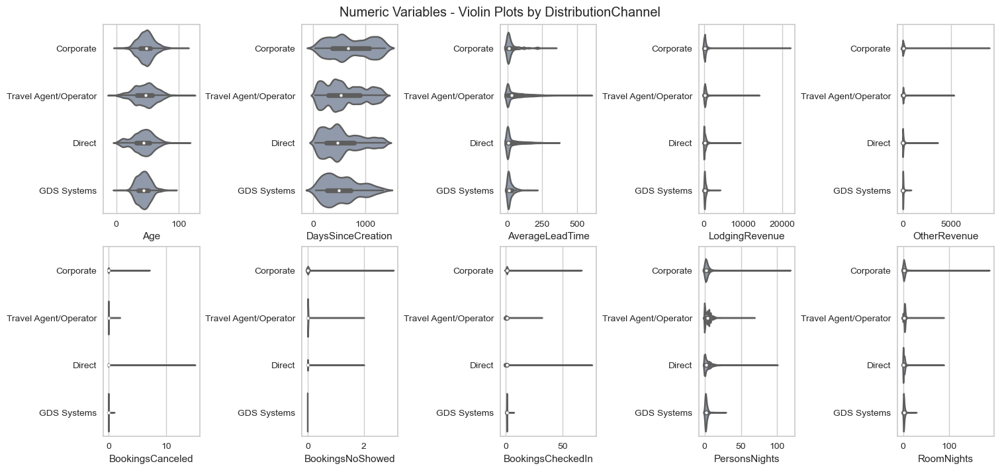

In [30]:
plot_violin(df, metric_features, 'DistributionChannel', 2, (15, 7))

Regarding the distribution of numerical variables grouped by the channel normally used by the customer to make bookings at the hotel, it is not noticeable a difference between groups. 

<a id = "data-preparation"></a>
    
## 2. Data Preparation

<a id = "preparation-index"></a>

- [2.1. Duplicates](#duplicates)
- [2.2. Data types](#data-types)
- [2.3. Incoherences](#incoherences)
- [2.4. Normalization](#normalization)
- [2.5. Missing values](#missing-values)
- [2.6. Outliers](#outliers)
- [2.7. New features](#new-features)
- [2.8. Variable selection](#variable-selection)
- [2.9. Encoding](#encoding)
- [2.10. Principal component analysis](#pca)
- [2.11. Summary data exploration](#summary)

[Back to TOC](#toc)

<a id = "duplicates"></a>

### 2.1. Duplicates

[Back to Data Preparation](#preparation-index)

In [31]:
# checking duplicate observations

df.duplicated().sum()

111

In [32]:
# seeing the columns that are duplicated

df[df.duplicated()].T

ID,595,702,1111,1391,1403,1420,1725,2294,2476,2606,...,102154,104081,104082,104298,104299,105601,107560,107561,108605,110575
Nationality,ROU,BRA,PRT,PRT,PRT,PRT,POL,FRA,CHN,FRA,...,PRT,PRT,PRT,PRT,PRT,PRT,PRT,PRT,PRT,PRT
Age,38.0,26.0,NaN,NaN,NaN,NaN,38.0,10.0,51.0,51.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DaysSinceCreation,1365,1359,1345,1340,1340,1339,1333,1320,1319,1317,...,114,97,97,95,95,84,69,69,61,46
NameHash,0x71AD7B2E07CAD82195B968B7CDD7961EC953760899B5...,0x74E713DA50B1E31F73E557BE97E695F2F91DF974EFCD...,0x517974F81AFEBB5A7D7364B258EF7E3536190C01850F...,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,0x234D43A3F656FDFD3A585F2B32B3D5AE092BC30C78E3...,0xCD73A9842124B67F44A6E932B24FECB6CF5072FC5661...,0x175CA512F43526CFEC29F7C5806D28FBCD9576ABA83C...,0xD8CCF5A1643B6FA6B7D173FBAB0865F18E6AE5805435...,0x23E9E4E270DF95C446B9B95222BB9B2611F1D95A280C...,...,0x9D60AA2E4E7C611654D4DF0827B16EAEA9222E638698...,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,0xF1465EC9E2D0027094B7C3D72772A862A635E461FFFC...,0xF1465EC9E2D0027094B7C3D72772A862A635E461FFFC...,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,0xF1465EC9E2D0027094B7C3D72772A862A635E461FFFC...,0xF1465EC9E2D0027094B7C3D72772A862A635E461FFFC...,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,0xB6280A5EAA35679770D4163A08B96851ED16236559DB...
DocIDHash,0x9CD129744684370C750190DB02D767653BB96C8119B3...,0xB4945744933DB61354AEE815E46203B3BEA62AA339A0...,NaN,NaN,NaN,NaN,0xBBBC3000CAE71ADE7C8B8BB546ACE4567A424F2A494D...,0xFF27E714317CBC47F0CF84F462BBDD1B048B62580755...,0xDDE27510B849198A2FB55C198852FC993AC1C3CFDABB...,0x28D135FF1C9F03C75C4847C0652A6430FD37CF133758...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AverageLeadTime,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
LodgingRevenue,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
OtherRevenue,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BookingsCanceled,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BookingsNoShowed,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


There are duplicate observations in the dataset that should be removed.

In [33]:
# removing duplicate observations

df.drop_duplicates(inplace = True)

In [34]:
# extracting the Hash that represent the missing values

df['DocIDHash'].value_counts()

0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B934CA495991B7852B855    3021
0xA486FBACF4B4E5537B026743E3FDFE571D716839E758236F42950A61FE6B922B      31
0x2B17E9D2CCEF2EA0FE752EE345BEDFB06741FFC8ECECF45D6BBDBAF9A274FF52      24
0x469CF1F9CF8C790FFA5AD3F484F2938CBEFF6435BCFD734F687EC6D1E968F076      15
0x2A14D03A4827C67E0D39408F103DB417AD496DCE6158F8309E6281185C042003      14
                                                                      ... 
0x5825AA46E4884EF879A26E514C9D0E91AAE46494F128B0AD44D81AD639DD5A26       1
0x68C8B2108F69FF2A322604377D0DE06789F07832D156036729C355779937BEF2       1
0x5374A726D76E12468AE43D19578A8E3B298D7F73FDF68AAD3831B003EECBBFC4       1
0xD607359B06F530FC11E7A23618EEC6299286E3925A8699806683DFDFF0B3D7A4       1
0xD539E89183AB389864B7A24B3C1FBC1FE20A40ED02E7CE438BCBA07BB1012304       1
Name: DocIDHash, Length: 103480, dtype: int64

In [35]:
# setting these IDs to np.NAN

df.loc[(df['DocIDHash'] == '0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B934CA495991B7852B855'), 'DocIDHash'] = np.nan

Also, there are customers who have more than one profile in the database, for example, there are 2 or more rows in the dataset with the same `DocIDHash`. This information should be kept, so we will combine the values into only one row. If there are 2 or more observations with the same `DocIDHash` but with different `NameHash`, we assume that the customer is the same, and we will keep the first information that the database has.

In [36]:
# creating a column with the old index
df['index'] = df.index

# dictionary to map each function to each column
aggregation_functions = {'index': 'first',
                         'Nationality': 'last',
                         'Age': 'last',
                         'DaysSinceCreation': 'last',
                         'NameHash': 'first',
                         'AverageLeadTime': 'last',
                         'LodgingRevenue': 'sum',
                         'OtherRevenue': 'sum',
                         'BookingsCanceled': 'sum',
                         'BookingsNoShowed': 'sum',
                         'BookingsCheckedIn': 'sum',
                         'PersonsNights': 'sum',
                         'RoomNights': 'sum',
                         'DistributionChannel': 'last',
                         'MarketSegment': 'last',
                         'SRHighFloor': 'max',
                         'SRLowFloor': 'max', 
                         'SRAccessibleRoom': 'max',
                         'SRMediumFloor': 'max',
                         'SRBathtub': 'max',
                         'SRShower': 'max',
                         'SRCrib': 'max',
                         'SRKingSizeBed': 'max',
                         'SRTwinBed': 'max',
                         'SRNearElevator': 'max',
                         'SRAwayFromElevator': 'max',
                         'SRNoAlcoholInMiniBar': 'max',
                         'SRQuietRoom': 'max'}

# aggregating the observations with the same DocIDHash using the functions above
df_new = df.groupby(df['DocIDHash'], as_index = False).aggregate(aggregation_functions)
df_new.rename(columns = {'index': 'ID'}, inplace = True)
df_new.set_index(keys = 'ID', inplace = True)
df_new

,DocIDHash,Nationality,Age,DaysSinceCreation,NameHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
61172,0x00006E606D590F336C289D2CC995A0C726878BCAC001...,FRA,60.0,479,0x0D54EA6B14A0574CAA2D3802565441048C5C831EB035...,1,495.0,162.0,0,0,...,0,0,0,0,1,0,0,0,0,1
9700,0x0000E25BC06E730F6DDD6BD53CBFE05BABD2B0182019...,DEU,54.0,1197,0xF33C33AE994E1AE82D574B2BF23945DC93A9D9CC89FE...,14,695.0,100.0,0,0,...,0,0,0,0,1,0,0,0,0,0
101456,0x0001425DE03D204F30757BA2E50DBD0486ED254E1E6F...,USA,34.0,120,0x42FC523622627DB3F09A6A544335CDAF2EDA9C57BA61...,0,0.0,0.0,0,0,...,0,0,0,1,1,0,0,0,0,0
49972,0x0002AE77553DBEBD734F0C644E6BE142EA0B4C5D5D83...,IND,5.0,569,0xF47414CC56472838252EE0BB9C0639AEA24312985ECA...,0,0.0,0.0,0,0,...,0,0,0,0,1,0,0,0,0,0
37077,0x0002DDD31332B77DA9499876CD3577B08844812E95F2...,ESP,53.0,755,0xFBF00BE3E81247CCA400CC838DCDCF0E4C537B98FDA9...,56,165.0,12.0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100990,0xFFFB1DBFAB9D8FFDC8602C6D365578FBFF637070F3EB...,USA,49.0,123,0xC96442DFC501BAF021CB0FE9CC15C1C22A98B8672FAF...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
35089,0xFFFB9FE60E0D35B8426F2FB90646D0BA799B803A79C1...,CAN,41.0,783,0x342C21783C3293511503091DCBCD4EB112AB13C2CD46...,58,218.0,14.0,0,0,...,0,0,0,0,0,0,0,0,0,0
110641,0xFFFE14C4D0D6520C97125A115CDC705B8A2F0E5133D5...,FRA,19.0,46,0xFD4A86C21CE0E27CFDF3ED6BFAF83F6B288657F972A2...,89,911.7,31.0,0,0,...,0,0,0,0,1,0,0,0,0,0


In [37]:
# keeping the new dataset

df = df_new.copy()

<a id = "data-types"></a>

### 2.2. Data types

[Back to Data Preparation](#preparation-index)

In [38]:
# checking the datatypes of the variables

df.dtypes

DocIDHash                object
Nationality              object
Age                     float64
DaysSinceCreation         int64
NameHash                 object
AverageLeadTime           int64
LodgingRevenue          float64
OtherRevenue            float64
BookingsCanceled          int64
BookingsNoShowed          int64
BookingsCheckedIn         int64
PersonsNights             int64
RoomNights                int64
DistributionChannel      object
MarketSegment            object
SRHighFloor               int64
SRLowFloor                int64
SRAccessibleRoom          int64
SRMediumFloor             int64
SRBathtub                 int64
SRShower                  int64
SRCrib                    int64
SRKingSizeBed             int64
SRTwinBed                 int64
SRNearElevator            int64
SRAwayFromElevator        int64
SRNoAlcoholInMiniBar      int64
SRQuietRoom               int64
dtype: object

Every variable is stored correctly.

<a id = "preparation-incoherences"></a>

### 2.3. Incoherences

[Back to Data Preparation](#preparation-index)

`NameHash` combined with `DocIDHash` are unique identifiers of each customer, therefore they do not provide any useful information regarding the characteristics of the different customers that book a room in the hotel.  So, they are not useful for the objective of this project - to define a customer segmentation - and they can be discarded from the dataset. Also, since they are in a Hash format we cannot decode them and extract information.

In [39]:
# droping the colums concerning the variables NameHash and DocIDHash

df.drop(['NameHash','DocIDHash'], axis = 1, inplace = True)

All incoherences mentioned previously on the Data Understanding phase will now be deleted.

In [40]:
# dropping the incoherences found on data understanding

df.drop(df[((df['PersonsNights'] == 0) & (df['RoomNights'] != 0)) | ((df['PersonsNights'] != 0) & (df['RoomNights'] == 0))].index, inplace = True)
df.drop(df[(df['BookingsCanceled'] == 0) & (df['BookingsNoShowed'] == 0) & (df['BookingsCheckedIn'] == 0)].index, inplace = True)
df.drop(df[df['Age'] <= 12].index, inplace = True)
df.drop(df[df['AverageLeadTime'] < 0].index, inplace = True)

<a id = "normalization"></a>

### 2.4. Normalization

- [2.4.1. MinMax scaling](#min-max-scaling)
- [2.4.2. Standard scaling](#standard-scaling)
- [2.4.3. Robust scaling](#robust-scaling)

[Back to Data Preparation](#preparation-index)

<a id = "min-max-scaling"></a>

#### 2.4.1. MinMax scaling

MinMax scaling is used because it will preserve the shape of the dataset (no distortion) and also because it is the least disruptive to the information in the original data. This methpd does not reduce the importance of outliers.

In [41]:
# creating a copy to apply MinMaxScaler

df_minmax = df.copy()

In [42]:
# creating a function to apply MinMaxScaler

def minmax_scaler(data, mf):
    """
    function to perform min-max scaling on the metric features
    """
    data_scaled = data.copy()
    
    # defining an instance of MinMaxScaler
    scaler = MinMaxScaler()
    
    # scaling the data, making sure that all data will be in the range 0-1
    scaled_feat = scaler.fit_transform(data_scaled.loc[:, mf])

    # and then we assign the scaled data to the dataframe
    data_scaled.loc[:, mf] = scaled_feat
    
    return data_scaled

In [43]:
# calling the function to scale the data and seeing the descriptive statistics

df_minmax = minmax_scaler(df_minmax, metric_features)
df_minmax[metric_features].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
Age,71960.0,0.35,0.15,0.0,0.24,0.34,0.45,1.0
DaysSinceCreation,72168.0,0.48,0.28,0.0,0.25,0.49,0.71,1.0
AverageLeadTime,72168.0,0.15,0.15,0.0,0.03,0.10,0.23,1.0
LodgingRevenue,72168.0,0.02,0.02,0.0,0.01,0.01,0.02,1.0
OtherRevenue,72168.0,0.01,0.02,0.0,0.00,0.01,0.01,1.0
BookingsCanceled,72168.0,0.00,0.01,0.0,0.00,0.00,0.00,1.0
BookingsNoShowed,72168.0,0.00,0.01,0.0,0.00,0.00,0.00,1.0
BookingsCheckedIn,72168.0,0.01,0.01,0.0,0.01,0.01,0.01,1.0
PersonsNights,72168.0,0.02,0.01,0.0,0.01,0.02,0.02,1.0
RoomNights,72168.0,0.01,0.01,0.0,0.01,0.01,0.01,1.0


All features have a minimum value of 0 and a maximum value of 1.

<a id = "standard-scaling"></a>

#### 3.4.2. Standard scaling

The standard scaling shoud be used when the data distribution is normal or almost normal.

In [44]:
# creating a copy to apply ZScore scaler

df_standard = df.copy()

In [45]:
# creating a function to apply ZScore scaler

def standard_scaler(data, mf):
    """
    function to perform standard scaler on the metric features
    """
    data_scaled = data.copy()
    
    # defining an instance of StandardScaler
    scaler = StandardScaler()
    
    # scaling the data, making sure that all data will have zero mean and unit standard deviation
    scaled_feat = scaler.fit_transform(data_scaled.loc[:, mf])

    # and then we assign the scaled data to the dataframe
    data_scaled.loc[:, mf] = scaled_feat
    
    return data_scaled

In [46]:
# calling the function to scale the data and seeing the descriptive statistics

df_standard = standard_scaler(df_standard, metric_features)
df_standard[metric_features].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
Age,71960.0,-0.0,1.0,-2.33,-0.74,-0.01,0.71,4.42
DaysSinceCreation,72168.0,0.0,1.0,-1.71,-0.83,0.05,0.84,1.88
AverageLeadTime,72168.0,0.0,1.0,-0.98,-0.78,-0.32,0.51,5.53
LodgingRevenue,72168.0,-0.0,1.0,-0.97,-0.51,-0.24,0.18,54.04
OtherRevenue,72168.0,-0.0,1.0,-0.67,-0.47,-0.24,0.15,60.51
BookingsCanceled,72168.0,0.0,1.0,-0.02,-0.02,-0.02,-0.02,110.01
BookingsNoShowed,72168.0,0.0,1.0,-0.02,-0.02,-0.02,-0.02,152.53
BookingsCheckedIn,72168.0,0.0,1.0,-0.85,-0.07,-0.07,-0.07,120.71
PersonsNights,72168.0,0.0,1.0,-1.31,-0.50,-0.10,0.31,74.93
RoomNights,72168.0,-0.0,1.0,-1.11,-0.44,-0.10,0.24,125.36


All variables have now mean 0 and standard deviation 1, as a consequence of the standardization.

<a id = "robust-scaling"></a>

#### 3.4.3. Robust scaling

The RobustScaler scales the data according to the interquantile range, so outliers have less influence than in other methods. If outliers are present in the dataset, then the median and the interquartile range provide better results and outperform the sample mean and variance.

In [47]:
# creating a copy to apply robust scaler

df_robust = df.copy()

In [48]:
def robust_scaler(data, mf):
    """
    function to perform robust scaling on the metric features
    """
    data_scaled = data.copy()
    
    # defining an instance of RobustScaler
    scaler = RobustScaler()
    
    # scaling the data
    scaled_feat = scaler.fit_transform(data_scaled.loc[:, mf])

    # and then we assign the scaled data to the dataframe
    data_scaled.loc[:, mf] = scaled_feat
    
    return data_scaled

In [49]:
# calling the function to scale the data and seeing the descriptive statistics

df_robust = robust_scaler(df_robust, metric_features)
df_robust[metric_features].describe().round(2).T

C:\Users\beatr\AppData\Local\Temp\ipykernel_17424\552077027.py:14: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  data_scaled.loc[:, mf] = scaled_feat


,count,mean,std,min,25%,50%,75%,max
Age,71960.0,0.01,0.69,-1.59,-0.50,0.0,0.50,3.05
DaysSinceCreation,72168.0,-0.03,0.60,-1.06,-0.53,0.0,0.47,1.10
AverageLeadTime,72168.0,0.25,0.77,-0.51,-0.36,0.0,0.64,4.51
LodgingRevenue,72168.0,0.35,1.46,-1.07,-0.40,0.0,0.60,79.08
OtherRevenue,72168.0,0.38,1.60,-0.69,-0.38,0.0,0.62,97.21
BookingsCanceled,72168.0,0.00,0.14,0.00,0.00,0.0,0.00,15.00
BookingsNoShowed,72168.0,0.00,0.05,0.00,0.00,0.0,0.00,7.00
BookingsCheckedIn,72168.0,0.09,1.29,-1.00,0.00,0.0,0.00,156.00
PersonsNights,72168.0,0.12,1.24,-1.50,-0.50,0.0,0.50,92.75
RoomNights,72168.0,0.15,1.48,-1.50,-0.50,0.0,0.50,186.00


This scaler makes the range of the scaled variables larger than the other two scalers.

In [50]:
# for all mentioned reasons, the MinMax scaler will be kept for the metric features

df_scaled = df_minmax.copy()

<a id = "missing-values"></a>

### 2.5. Missing values

- [2.5.1. Delete records](#delete)
- [2.5.2. Fill in with a measure of central tendency](#central-tendency)
- [2.5.3. Fill in with values from similar individuals](#similar-individuals)

[Back to Data Preparation](#preparation-index)

In [51]:
# creating a copy to solve the problems with missing values

df_missing = df.copy()

Checking if there are any missing values but not encoded as NaN, for example encoded as empty strings or as *'na'*.

In [52]:
# replacing other types of missing values not recognized by pandas with NaN and checking again the number of missing values

missing_values = ['n/a', 'na', '--', '', 'unknown', 'Unknown']

df_missing.replace(missing_values, np.nan, inplace = True)
df_missing.isna().sum()

Nationality               0
Age                     208
DaysSinceCreation         0
AverageLeadTime           0
LodgingRevenue            0
OtherRevenue              0
BookingsCanceled          0
BookingsNoShowed          0
BookingsCheckedIn         0
PersonsNights             0
RoomNights                0
DistributionChannel       0
MarketSegment             0
SRHighFloor               0
SRLowFloor                0
SRAccessibleRoom          0
SRMediumFloor             0
SRBathtub                 0
SRShower                  0
SRCrib                    0
SRKingSizeBed             0
SRTwinBed                 0
SRNearElevator            0
SRAwayFromElevator        0
SRNoAlcoholInMiniBar      0
SRQuietRoom               0
dtype: int64

In [53]:
# seeing rows with NaNs

nans_index = df_missing.isna().any(axis = 1)
df_missing[nans_index]

,Nationality,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
40250,PRT,NaN,713,198,202.00,22.0,0,0,1,4,...,0,0,0,0,0,1,0,0,0,0
430,PRT,NaN,1377,0,445.50,72.0,0,0,1,2,...,0,0,0,0,0,0,0,0,0,0
5328,PRT,NaN,1268,71,302.40,52.0,0,0,1,6,...,0,0,0,0,0,0,0,0,0,0
56006,PRT,NaN,521,95,246.40,37.0,0,0,1,4,...,0,0,0,0,1,0,0,0,0,0
3428,PRT,NaN,1302,112,176.70,18.0,0,0,1,6,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24333,PRT,NaN,943,68,319.20,347.5,0,0,1,8,...,0,0,0,0,0,0,0,0,0,0
55988,PRT,NaN,521,290,376.80,76.0,0,0,1,8,...,0,0,0,0,0,0,0,0,0,0
56533,PRT,NaN,516,46,80.50,24.0,0,0,1,2,...,0,0,0,0,0,0,0,0,0,0


It is possible to generate **visual representations of missingness in data**, to detect relationships between missing values, such as missing together with other columns, or other similar patterns.

<AxesSubplot: >

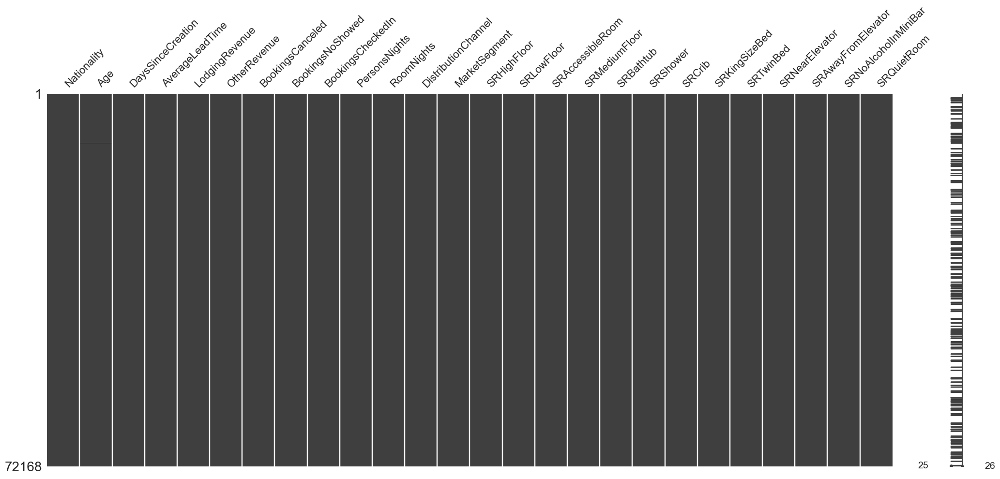

In [54]:
msno.matrix(df_missing)

<a id = "delete"></a>

#### 2.5.1. Delete records

A way to deal with missing values is to just **delete the observations** that have them. The problem with this approach is the lost of information and the potential bias in the data it creates, as, by ignoring the observation, the remaining attributes’ values in this observation are not used (which could be important to our analysis).

In [55]:
# creating a copy to delete the missing values

df_delete = df_missing.copy()

In [56]:
def delete_nan(data):
    """
    function to drop the missing values
    """
    
    # deleting the observations that contain missing values (inplace = True to save the changes directly in the dataset)
    data.dropna(inplace = True)
    
    return data

In [57]:
# testing the function
df_delete = delete_nan(df_delete)

# and seeing that the rows with the missing values do not exist anymore
df_delete.loc[nans_index, :]

,Nationality,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,


In [58]:
print('Percentage of data kept after removing missing values:', np.round(df_delete.shape[0] / df_missing.shape[0], 4) * 100)

Percentage of data kept after removing missing values: 99.71


1% of the dataset was deleted (after the previous steps in data preparation), to deal with missing values.

<a id = "central-tendency"></a>

#### 2.5.2. Fill in with a measure of central tendency

Another way to deal with missing values is fill in with a **measure of central tendency** (median for metric features, because it less affected by extreme observations than the mean, and mode for non metric features). By using this method, the relationship between columns can also be affected, the standard error can be biased and, if values are not missing at random, the actual median/mode of the column can also be biased.

In [59]:
# creating a copy to apply central tendency measures imputation

df_central = df_missing.copy()

In [60]:
def input_nan_central(data, mf):
    """
    function to inpute the missing values with the median/mode of the feature
    inputs:
    - data
    - mf: metric features
    """
    
    # calculating the medians and the modes of the variables, and then concatenating these two measures into one imputer object
    medians = data[mf].median()
    
    # filling the missing values
    data.fillna(medians, inplace = True)
    
    return data

In [61]:
# testing our function
df_central = input_nan_central(df_central, metric_features)

# and seeing that the rows with the missing values do not exist anymore
df_central.loc[nans_index, :]

,Nationality,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
40250,PRT,48.0,713,198,202.00,22.0,0,0,1,4,...,0,0,0,0,0,1,0,0,0,0
430,PRT,48.0,1377,0,445.50,72.0,0,0,1,2,...,0,0,0,0,0,0,0,0,0,0
5328,PRT,48.0,1268,71,302.40,52.0,0,0,1,6,...,0,0,0,0,0,0,0,0,0,0
56006,PRT,48.0,521,95,246.40,37.0,0,0,1,4,...,0,0,0,0,1,0,0,0,0,0
3428,PRT,48.0,1302,112,176.70,18.0,0,0,1,6,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24333,PRT,48.0,943,68,319.20,347.5,0,0,1,8,...,0,0,0,0,0,0,0,0,0,0
55988,PRT,48.0,521,290,376.80,76.0,0,0,1,8,...,0,0,0,0,0,0,0,0,0,0
56533,PRT,48.0,516,46,80.50,24.0,0,0,1,2,...,0,0,0,0,0,0,0,0,0,0


In [62]:
# checking how many NaNs we still have

df_central.isna().sum()

Nationality             0
Age                     0
DaysSinceCreation       0
AverageLeadTime         0
LodgingRevenue          0
OtherRevenue            0
BookingsCanceled        0
BookingsNoShowed        0
BookingsCheckedIn       0
PersonsNights           0
RoomNights              0
DistributionChannel     0
MarketSegment           0
SRHighFloor             0
SRLowFloor              0
SRAccessibleRoom        0
SRMediumFloor           0
SRBathtub               0
SRShower                0
SRCrib                  0
SRKingSizeBed           0
SRTwinBed               0
SRNearElevator          0
SRAwayFromElevator      0
SRNoAlcoholInMiniBar    0
SRQuietRoom             0
dtype: int64

<a id = "similar-individuals"></a>

#### 2.5.3. Fill in with values from similar individuals

Another way to deal with missing values is to fill in with values from **similar individuals (nearest neighbours)**. To use this method, the data should be normalized (otherwise, the different scales of our data will lead the KNNImputer to generate biased replacements for the missing values). KNNImputer only works for metric features, as it computes distances, that do not make sense to compute for non metric features.

Code adapted from: https://medium.com/@kyawsawhtoon/a-guide-to-knn-imputation-95e2dc496e

In [63]:
# creating a new copy to explore the neighbordhood imputation

df_neighbors = df_scaled.copy()

In [64]:
def input_nan_knn(scaled_data, mf):
    """
    function to inpute the metric features' missing values with knn
    inputs:
    - scaled data
    - mf: metric features
    """
    
    # defining an imputer of KNN and then use it to fill the missing values in our variables
    knn_imputer = KNNImputer(n_neighbors = 5, weights = 'uniform')
    scaled_data[mf] = knn_imputer.fit_transform(scaled_data[mf])
    
    return scaled_data

In [65]:
# filling the missing values with the defined function
df_neighbors = input_nan_knn(df_neighbors, metric_features)

# seeing rows with NaNs imputed
df_neighbors.loc[nans_index, metric_features]

,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,RoomNights
ID,,,,,,,,,,
40250,0.405882,0.501853,0.336735,0.008374,0.002483,0.0,0.0,0.006369,0.010610,0.005333
430,0.407843,0.994070,0.000000,0.018468,0.008127,0.0,0.0,0.006369,0.005305,0.002667
5328,0.372549,0.913269,0.120748,0.012536,0.005870,0.0,0.0,0.006369,0.015915,0.008000
56006,0.407843,0.359526,0.161565,0.010214,0.004176,0.0,0.0,0.006369,0.010610,0.005333
3428,0.192157,0.938473,0.190476,0.007325,0.002032,0.0,0.0,0.006369,0.015915,0.008000
...,...,...,...,...,...,...,...,...,...,...
24333,0.370588,0.672350,0.115646,0.013232,0.039225,0.0,0.0,0.006369,0.021220,0.010667
55988,0.354902,0.359526,0.493197,0.015620,0.008579,0.0,0.0,0.006369,0.021220,0.010667
56533,0.354902,0.355819,0.078231,0.003337,0.002709,0.0,0.0,0.006369,0.005305,0.002667


The most simple method should be used for starting, so the median imputation will be kept. Of course, this can be changed through the preprocessing stage, as it is a cyclical process.

In [66]:
# choosing the median inputation
df = df_central.copy()

# updating the scaled version of the dataset with the missing values filled
df_scaled = minmax_scaler(df, metric_features)

<a id = "outliers"></a>

### 2.6. Outliers

- [2.6.1. IQR method](#iqr-method)
- [2.6.2. Z-score method](#zscore-method)
- [2.6.3. Manual filtering](#manual-filtering)
- [2.6.4. Combining the three methods](#combining-three-methods)

[Back to Data Preparation](#preparation-index)

Outliers are data points that are significantly different from the rest of the data in a dataset and they can impact the results of a clustering analysis because they can lead to the formation of clusters that are not representative of the underlying structure of the data. So, they should be treated. In KMeans clustering, the distance between data points is used to determine which points should be in the same cluster, and outliers can distort this distance measure. Also, these values can have a disproportionate influence on the results of a clustering analysis.

In [67]:
# creating a copy to apply the methods for outlier removal

df_outlier = df.copy()

<a id = "iqr-method"></a>

#### 2.6.1. IQR method

IQR method can be used to identify outliers, seting up a “fence” outside of the first and the third quartile. Any values that fall outside of this fence are considered outliers.

In [68]:
def IQR_method(data, mf):
    """
    function that removes outliers using IQR method
    """
    
    # calculating the quartiles and the correspondent inter quartil range
    q25 = data[mf].quantile(.25)
    q75 = data[mf].quantile(.75)
    iqr = (q75 - q25)
    
    # defining the limits to search for outliers
    upper_lim = q75 + 1.5 * iqr
    lower_lim = q25 - 1.5 * iqr
    
    # applying the calculated measures to filter the observations in our dataset and transforming the result into a pandas series
    filter = []
    for metric in mf:
        llim = lower_lim[metric]
        ulim = upper_lim[metric]
        filter.append(data[metric].between(llim, ulim, inclusive = 'both'))
    filter = pd.Series(np.all(filter, 0), index = data.index)

    # applying the filter to our dataframe
    data_filter = data[filter]

    return data_filter, filter

In [69]:
# testing our function

df_iqr, filter_iqr = IQR_method(df_outlier, metric_features)
print('Percentage of data kept after removing outliers:', np.round(df_iqr.shape[0] / df_outlier.shape[0] * 100, 4))

Percentage of data kept after removing outliers: 81.7523


This approach is problematic since it removes too much observations (around 19%).

<a id = "zscore-method"></a>

#### 2.6.2. Z-score method

Z-score method can be used to identify outliers, seting up a “fence” outside of -3\*Z-score to 3\*Z-score. Any values that fall outside of this fence are considered outliers. A Z-score is a measure of how many standard deviations a data point is from the mean of a dataset. However, this method assumes that the data are normally distributed, and if this is not true then the Z-scores may not accurately reflect the relative distances of the data points from the mean, which can be a limitation if the data is not normally distributed. The choice of 3 as the threshold for identifying outliers is the most common one, although it is arbitrary and may not be appropriate in all cases.

Code from https://stackoverflow.com/questions/49392387/python-pandas-remove-rows-with-outlying-values-keeping-all-columns

In [70]:
def zscore_method(data, mf, threshold = 3):
    """
    function that removes outliers based on z-score calculation
    """
    
    # calculating z-score using statistics module (only calculate zscore for metric features)
    z_score = zscore(data[mf], nan_policy = 'omit')
    
    # as we have some observations with missing values that we cannot calculate their z-score, we will fill the missing data
    # with 0 (the observations will not alter our decisions)
    z_score.fillna(0, inplace = True)
    
    # keeping the observations where all zscores for all variables are greater than the threshold in absolute value
    filter = (np.abs(z_score) < threshold).all(axis = 1)
    
    # applying the filter to our dataframe
    data_filter = data[filter]
    
    return data_filter, filter

In [71]:
# testing the function

df_zscore, filter_zscore = zscore_method(df_outlier, metric_features)
print('Percentage of data kept after removing outliers:', np.round(df_zscore.shape[0] / df_outlier.shape[0] * 100, 4))

Percentage of data kept after removing outliers: 95.2486


Nearly 5% of the data is removed to deal with outliers.

<a id = "manual-filtering"></a>

#### 2.6.3. Manual filtering

For this method each feature is plotted in a box-plot and we see what are the extreme values that can be considered for outlier removal. 

In [72]:
# defining a function to show an interactive box-plot for a feature (we can pass the cursor in the plot and check the 
# values and some other features)

def show_boxplot(feature):
    fig = px.box(df, x = df[feature], color_discrete_sequence = ['dimgrey'], template = 'plotly_white', width = 400, height = 350)
    fig.show()

In [73]:
show_boxplot('Age')

Values below 0 and above 100 for `Age` will be deleted.

In [74]:
show_boxplot('DaysSinceCreation')

There are no outliers visible for `DaysSinceCreation`.

In [75]:
show_boxplot('AverageLeadTime')

As one year lead time is considered to be a significant value, we used 365 days as a threshold for outlier removal in `AverageLeadTime`. Also, the minimum value should be deleted, as it is not possible to have an negative `AverageLeadTime`.

In [76]:
show_boxplot('LodgingRevenue')

We can consider the Bill Gates effect (poeple that actually spent a good amount of money in our hotel, as they spent significantly more money than the others in accomodation, which is not necessarly an error) for deleting the most extreme values. However, considering the distribution of this variable, it was decided to delete the observations that had a `LodgingRevenue` bigger than 2000.

In [77]:
show_boxplot('OtherRevenue')

The same logic can be applied for `OtherRevenue`, so observations with values higher than 500 will be deleted.

In [78]:
show_boxplot('BookingsCanceled')

People who cancel reservations are rare, so it is normal that when this happens the values are significantly different from the rest of the distribution. Therefore in the business context, 10 cancelations for just one customer is considered to be a high value, so that was the threshold defined for removing outliers.

In [79]:
show_boxplot('BookingsNoShowed')

For `BookingsNoShowed` we decided not to delete any observations, as they are very rare and can provide useful information.

In [80]:
show_boxplot('BookingsCheckedIn')

As we can see in the flat box-plot, there are 3 super extreme observations, so we should remove them (observations that have `BookingsCheckedIn` above 100). But since 50 checked-in for the same customer in one hotel is already a significant value to indicate loyalty, we decided to delete observations with a value for `BookingsCheckedIn` higher than 50.

In [81]:
show_boxplot('PersonsNights')

For `PersonNights`, we defined a threshold at 80, as they are possible values but apart from the usual distribution of the majority of customers.

In [82]:
show_boxplot('RoomNights')

Regarding `RoomNights`, we considered observations with values higher than 75 to be outliers, as they are very apart from the usual observations. They can be people who are really loyal to our hotel, but their behaviour is already represented by the other high values. 

In [83]:
def manual_method(data):
    """
    function that removes outliers based on the manual filter we defined
    """
    
    # defining the limits to search for outliers
    filter = (
        (df_outlier['Age'] <= 100)
        &
        (df_outlier['AverageLeadTime'] <= 365)
        &
        (df_outlier['LodgingRevenue'] <= 2000)
        &
        (df_outlier['OtherRevenue'] <= 500)
        &
        (df_outlier['BookingsCanceled'] <= 10)
        &
        (df_outlier['BookingsCheckedIn'] <= 50)
        &
        (df_outlier['PersonsNights'] <= 80)
        &
        (df_outlier['RoomNights'] <= 75)
    )
    
    # applying the filter to our dataframe
    data_filter = data[filter]
    
    return data_filter, filter

In [84]:
# testing our function

df_manual, filter_manual = manual_method(df_outlier)
print('Percentage of data kept after removing outliers:', np.round(df_manual.shape[0] / df_outlier.shape[0] * 100, 4))

Percentage of data kept after removing outliers: 96.4264


As we can notice, we removed about 4% of our observations which is acceptable.

<a id = "combining-three-methods"></a>

#### 2.6.4. Combining the three methods

We can also combine the three methods that we saw above, making sure that we only delete outliers that are considered outliers simultaneously by the IQR method, Z-score method and by our manual filter.

In [85]:
# applying the filter to our dataframe

df_combination = df_outlier[(filter_iqr | filter_zscore | filter_manual)]
print('Percentage of data kept after removing outliers:', np.round(df_combination.shape[0] / df_outlier.shape[0] * 100, 4))

Percentage of data kept after removing outliers: 96.5677


When combining the three methods, we only delete 4% of the dataset, as it is more difficult to an observation to be considered an outlier since it has to satisfy the conditions for all methods. 

We will keep the manual filtering for now, and then change it if necessary to improve the performance of the clustering algorithms.

In [86]:
# saving the outliers
outliers = df[~filter_manual]

# keeping the manual method
df_outlier = df_manual.copy()

In [87]:
# saving the dataframe without outliers
df = df_outlier.copy()

# and store the scaled version of it
df_scaled = minmax_scaler(df, metric_features)

<a id = "new-features"></a>

### 2.7. New features

[Back to Data Preparation](#preparation-index)

We can create multiple new variables in order to try to extract some useful information. Some examples are:

- `AveragePersonsPerRoom` gives us the number of persons per room for each client, on average. 
- `NumberRequests` gives us the number of total requests a client usually makes.
- `NumberBookings` gives us the number of bookings that a customer made with the hotel (independently of actually showing up or not).
- `SpendingPerBooking` gives us the average amount spent by each customer every time they checked in at the hotel. 

In [88]:
def new_features(data, mf):
    """
    function that creates the new features in the dataframe
    """

    data['AveragePersonsPerRoom'] = np.where(data['RoomNights'] != 0, data['PersonsNights'] / data['RoomNights'], 0)
    data['NumberRequests'] = data['SRHighFloor'] + data['SRLowFloor'] + data['SRAccessibleRoom'] + data['SRMediumFloor'] + data['SRBathtub'] + data['SRShower'] + data['SRCrib'] + data['SRKingSizeBed'] + data['SRTwinBed'] + data['SRNearElevator'] + data['SRAwayFromElevator'] + data['SRNoAlcoholInMiniBar'] + data['SRQuietRoom']
    data['NumberBookings'] = data['BookingsCanceled'] + data['BookingsCheckedIn'] + data['BookingsNoShowed']
    data['SpendingPerBooking'] = np.where(data['BookingsCheckedIn'] != 0, (data['LodgingRevenue'] + data['OtherRevenue']) / data['BookingsCheckedIn'], 0)

    # updating the list with the metric and non-metric features
    mf.append('AveragePersonsPerRoom')
    mf.append('NumberRequests')
    mf.append('NumberBookings')
    mf.append('SpendingPerBooking')

    return data, mf

In [89]:
# creating the new features in our dataset
df, metric_features = new_features(df, metric_features)

# and updating our scaled version of the dataset with the new features
df_scaled = minmax_scaler(df, metric_features)

<a id = "variable-selection"></a>

### 2.8. Variable selection

[Back to Data Preparation](#preparation-index)

In [90]:
# creating a new copy to perform variable selection

df_corr = df.copy()

If a feature is **univariate** (has 0 variance), should be dropped, since it does not provide any predictive capacity.

In [91]:
# checking the variance of the numerical features

df_corr[metric_features].var()

Age                         219.568190
DaysSinceCreation        142769.295919
AverageLeadTime            6354.683548
LodgingRevenue            82312.917590
OtherRevenue               6460.813335
BookingsCanceled              0.002082
BookingsNoShowed              0.000417
BookingsCheckedIn             0.194227
PersonsNights                17.556534
RoomNights                    3.172369
AveragePersonsPerRoom         0.436308
NumberRequests                0.479979
NumberBookings                0.214128
SpendingPerBooking       101337.272316
dtype: float64

There are no metric features that are univariated, so we don't discard any by this method.

As seen in Data Understanding phase, there are some categorical features that were constant for all observations, or only changed for less than 1% of the dataset. Therefore, we decided to delete them. Also, since we are doing a new market segmentation, it does not make sense to include the old one, so `MarketSegment` should be deleted as well.

In [92]:
# dropping the variables as explained in Data Understanding

df_corr.drop(['SRLowFloor', 'SRMediumFloor', 'SRAccessibleRoom', 'SRBathtub', 'SRShower', 'SRNearElevator', 'SRAwayFromElevator', 'SRNoAlcoholInMiniBar', 'MarketSegment'], axis = 1, inplace = True)

We will repeat the correlation matrix again, as we added some features that could have impact on the correlations calculated before.

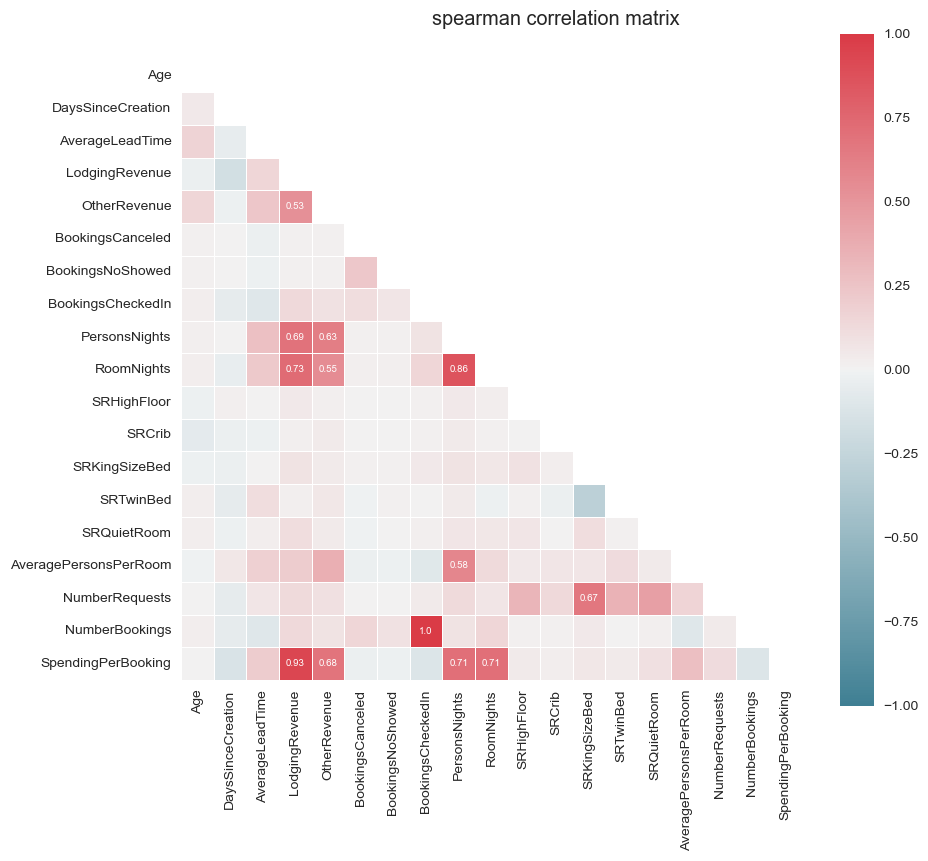

In [93]:
# plotting the correlation matrix

corr_matrix(df_corr, 'spearman')

Based on the analysis done in Data Understanding phase, we decided to drop `RoomNights` because of its high correlation with the other variables. (`RoomNights` will be deleted, because in the context of the problem, knowing if a person travels alone or in big groups seems more important). No more relevant correlations were found here beside the ones that were found previously, so this is the only variable that will be deleted. 

We created the variable `NumberBookings` because we wanted to have a variable that summarized the number of reservations that a customer made with the hotel (independently of them actually happening or not). However, now we can see that this variable is, as expected, highly correlated with `BookingsCheckedIn`, as the majority of the customers do not cancel. So, we decided that we want more detailed information, so the original 3 variables will be kept.

We also deleted `SpendingPerBooking` since it is highly correlated with the new variable `LodgingRevenue`. In the business context, `SpendingPerBooking` give us a more useful information regarding the amount spent during each stay at the hotel, but it is not expected that this variable has a big range of values in its distribution (since we expect that the average bedroom price in the hotel is the same, and the amount of upgraded bedrooms, that could cost more, is reduced). Therefore, it will be kept only for interpretation purposes.

In [94]:
# dropping the variable based on the correlation

df_corr.drop(['RoomNights', 'AveragePersonsPerRoom', 'NumberBookings'], axis = 1, inplace = True)

In [95]:
# updating the features lists
metric_features_todrop = ['RoomNights', 'AveragePersonsPerRoom', 'NumberBookings']
non_metric_features_todrop = ['SRLowFloor', 'SRMediumFloor', 'SRAccessibleRoom', 'SRBathtub', 'SRShower', 'SRNearElevator', 'SRAwayFromElevator', 'SRNoAlcoholInMiniBar', 'MarketSegment']

metric_features = list(set(metric_features) - set(metric_features_todrop))
non_metric_features = list(set(non_metric_features) - set(non_metric_features_todrop))

In [96]:
# keeping the changes made in the dataset
df = df_corr.copy()

# and updating the scaled version
df_scaled = minmax_scaler(df, metric_features)

<a id = "Encoding"></a>

### 2.9. Encoding

[Back to Data Preparation](#preparation-index)

As described before, variable `Nationality` had a problem with the number of unique categories. Since the algorithms we are going to use assume that the input data is numerical (they cannot handle categorical variables directly), we need to perform one-hot encoding, which means, create new binary columns, indicating the presence of each possible category of the variable. For each row in the dataset, the column corresponding to the category for that row is set to 1, while all the other columns are set to 0. However, this technique can also increase the dimensionality of the data, as it creates new columns for each category, which can make the clustering more complex and fall in the so called 'curse of dimensionality'.

So, we decided to group the observations based on the geographical regions (Africa, Europe, North America, South America, Asia, Oceania), creating only 6 columns for this variable. For the rest of the categorical variables we performed one-hot encoding on the existent variables.

In [97]:
# creating a copy to apply one-hot enconding (already without missing values)

df_ohc = df.copy()

In [98]:
# creating a dictionary mapping ISO codes to continents

continent_dict = {
    'DZA': 'Africa',
    'AGO': 'Africa',
    'BEN': 'Africa',
    'BWA': 'Africa',
    'BFA': 'Africa',
    'BDI': 'Africa',
    'CPV': 'Africa',
    'CMR': 'Africa',
    'CAF': 'Africa',
    'TCD': 'Africa',
    'COM': 'Africa',
    'COG': 'Africa',
    'COD': 'Africa',
    'CIV': 'Africa',
    'DJI': 'Africa',
    'EGY': 'Africa',
    'GNQ': 'Africa',
    'ERI': 'Africa',
    'ETH': 'Africa',
    'GAB': 'Africa',
    'GMB': 'Africa',
    'GHA': 'Africa',
    'GIN': 'Africa',
    'GNB': 'Africa',
    'KEN': 'Africa',
    'LSO': 'Africa',
    'LBR': 'Africa',
    'LBY': 'Africa',
    'MDG': 'Africa',
    'MWI': 'Africa',
    'MLI': 'Africa',
    'MRT': 'Africa',
    'MUS': 'Africa',
    'MAR': 'Africa',
    'MOZ': 'Africa',
    'NAM': 'Africa',
    'NER': 'Africa',
    'NGA': 'Africa',
    'RWA': 'Africa',
    'STP': 'Africa',
    'SEN': 'Africa',
    'SYC': 'Africa',
    'SLE': 'Africa',
    'SOM': 'Africa',
    'ZAF': 'Africa',
    'SSD': 'Africa',
    'SDN': 'Africa',
    'SWZ': 'Africa',
    'TZA': 'Africa',
    'TGO': 'Africa',
    'TMP': 'Africa',
    'TUN': 'Africa',
    'UGA': 'Africa',
    'ZMB': 'Africa',
    'ZWE': 'Africa',

    'AFG': 'Asia',
    'ARM': 'Asia',
    'AZE': 'Asia',
    'BHR': 'Asia',
    'BGD': 'Asia',
    'BTN': 'Asia',
    'BRN': 'Asia',
    'KHM': 'Asia',
    'CHN': 'Asia',
    'CCK': 'Asia',
    'CYP': 'Asia',
    'PSE': 'Asia',
    'GEO': 'Asia',
    'HKG': 'Asia',
    'IND': 'Asia',
    'IDN': 'Asia',
    'IRN': 'Asia',
    'IRQ': 'Asia',
    'ISR': 'Asia',
    'JPN': 'Asia',
    'JOR': 'Asia',
    'KAZ': 'Asia',
    'KWT': 'Asia',
    'KGZ': 'Asia',
    'LAO': 'Asia',
    'LBN': 'Asia',
    'MAC': 'Asia',
    'MYS': 'Asia',
    'MDV': 'Asia',
    'MNG': 'Asia',
    'MMR': 'Asia',
    'NPL': 'Asia',
    'PRK': 'Asia',
    'OMN': 'Asia',
    'PAK': 'Asia',
    'PHL': 'Asia',
    'QAT': 'Asia',
    'SAU': 'Asia',
    'SGP': 'Asia',
    'KOR': 'Asia',
    'LKA': 'Asia',
    'SYR': 'Asia',
    'TWN': 'Asia',
    'TJK': 'Asia',
    'THA': 'Asia',
    'TLS': 'Asia',
    'TUR': 'Asia',
    'TKM': 'Asia',
    'ARE': 'Asia',
    'UZB': 'Asia',
    'VNM': 'Asia',
    'YEM': 'Asia',

    'ALB': 'Europe',
    'AIA': 'Europe',
    'AND': 'Europe',
    'ATF': 'Europe',
    'AUT': 'Europe',
    'BLR': 'Europe',
    'BEL': 'Europe',
    'BIH': 'Europe',
    'BGR': 'Europe',
    'HRV': 'Europe',
    'CYM': 'Europe',
    'CYP': 'Europe',
    'CZE': 'Europe',
    'DNK': 'Europe',
    'EST': 'Europe',
    'FIN': 'Europe',
    'FRA': 'Europe',
    'FRO': 'Europe',
    'DEU': 'Europe',
    'GRC': 'Europe',
    'GIB': 'Europe',
    'HUN': 'Europe',
    'ISL': 'Europe',
    'IRL': 'Europe',
    'ITA': 'Europe',
    'JEY': 'Europe',
    'KAZ': 'Europe',
    'KOS': 'Europe',
    'IOT': 'Europe',
    'LVA': 'Europe',
    'LIE': 'Europe',
    'LTU': 'Europe',
    'LUX': 'Europe',
    'MKD': 'Europe',
    'MLT': 'Europe',
    'MDA': 'Europe',
    'MCO': 'Europe',
    'MNE': 'Europe',
    'NLD': 'Europe',
    'NCL': 'Europe',
    'NOR': 'Europe',
    'PCN': 'Europe',
    'PYF': 'Europe',
    'POL': 'Europe',
    'PRT': 'Europe',
    'ROU': 'Europe',
    'RUS': 'Europe',
    'SMR': 'Europe',
    'SJM': 'Europe',
    'SRB': 'Europe',
    'SVK': 'Europe',
    'SVN': 'Europe',
    'ESP': 'Europe',
    'SWE': 'Europe',
    'CHE': 'Europe',
    'UKR': 'Europe',
    'GBR': 'Europe',
    'VAT': 'Europe',

    'CAN': 'NorthAmerica',
    'MEX': 'NorthAmerica',
    'SPM': 'NorthAmerica',
    'VIR': 'NorthAmerica',
    'USA': 'NorthAmerica',
    'UMI': 'NorthAmerica',

    'ARG': 'SouthAmerica',
    'ABW': 'SouthAmerica',
    'BOL': 'SouthAmerica',
    'BRA': 'SouthAmerica',
    'CHL': 'SouthAmerica',
    'COL': 'SouthAmerica',
    'ECU': 'SouthAmerica',
    'FLK': 'SouthAmerica',
    'GUY': 'SouthAmerica',
    'GUF': 'SouthAmerica',
    'PRY': 'SouthAmerica',
    'PER': 'SouthAmerica',
    'SUR': 'SouthAmerica',
    'URY': 'SouthAmerica',
    'VEN': 'SouthAmerica',

    'AUS': 'Oceania',
    'ASM': 'Oceania',
    'COK': 'Oceania',
    'FJI': 'Oceania',
    'KIR': 'Oceania',
    'MHL': 'Oceania',
    'FSM': 'Oceania',
    'NRU': 'Oceania',
    'NZL': 'Oceania',
    'PLW': 'Oceania',
    'PNG': 'Oceania',
    'WSM': 'Oceania',
    'SLB': 'Oceania',
    'TON': 'Oceania',
    'TUV': 'Oceania',
    'VUT': 'Oceania',
    'WLF': 'Oceania',

    'ATA': 'Antarctica',
    'BVT': 'Antarctica',
    'HMD': 'Antarctica',

    'BLZ': 'CentralAmerica',
    'BMU': 'CentralAmerica',
    'CRI': 'CentralAmerica',
    'SLV': 'CentralAmerica',
    'GTM': 'CentralAmerica',
    'HND': 'CentralAmerica',
    'NIC': 'CentralAmerica',
    'PAN': 'CentralAmerica',
    'ATG': 'CentralAmerica',
    'BHS': 'CentralAmerica',
    'BRB': 'CentralAmerica',
    'CUB': 'CentralAmerica',
    'DMA': 'CentralAmerica',
    'DOM': 'CentralAmerica',
    'GRD': 'CentralAmerica',
    'HTI': 'CentralAmerica',
    'JAM': 'CentralAmerica',
    'KNA': 'CentralAmerica',
    'LCA': 'CentralAmerica',
    'PRI': 'CentralAmerica',
    'VCT': 'CentralAmerica',
    'TTO': 'CentralAmerica'
}

In [99]:
def create_continent(data, iso_codes, nmf):
    """
    function to group the nationlaity column by geographical region

    inputs:
    - iso_codes: dictionary where the keys are the codes of the countries and the values are the respective continent 
    """

    # create a new column for continent in the dataset and dropping the Nationality variable
    data['Continent'] = data['Nationality'].map(iso_codes)
    data.drop('Nationality', axis = 1, inplace = True)

    # updating the non-metric features list
    nmf.remove('Nationality')
    nmf.append('Continent')

    return data, nmf

In [100]:
# using the previous function to create 'continent' column

df_ohc, non_metric_features = create_continent(df_ohc, continent_dict, non_metric_features)

In [101]:
def ohc(data, nmf):
    """
    function to perform one-hot encoding to the non metric features specified as input
    """
    
    # defining an instance of OneHotEncoder
    encoder = OneHotEncoder(sparse_output = False, drop = 'first')
    
    # use it to encode our variables
    ohc_feat = encoder.fit_transform(data.loc[:, nmf])
    
    # after this we get the new names of the features, and transform this new information into a pandas dataframe
    ohc_feat_names = encoder.get_feature_names_out()
    ohc_data = pd.DataFrame(columns = ohc_feat_names, data = ohc_feat, index = data.index)
    
    # reassigning df to contain the ohc variables and non_metric_features to contain the new names of the encoded variables
    data_ohc = pd.concat([data, ohc_data], axis = 1)
    encoded_nmf = ohc_feat_names.tolist()
    
    # renaming the columns with one-hot encoder, to make it easier to later identify
    rename_ohc_cols = {}
    for i in encoded_nmf:
        rename_ohc_cols[i] = 'ohc_' + i
    data_ohc.rename(columns = rename_ohc_cols, inplace = True)
    
    # changing the names in the list of the variables
    encoded_nmf = list(rename_ohc_cols.values())
    
    return data_ohc, encoded_nmf

In [102]:
# performing one-hot encoding for the categorical featurea

df_ohc, ohc_non_metric_features = ohc(df_ohc, ['DistributionChannel', 'Continent'])
df_ohc.head().T

ID,61172,9700,37077,42413,104423
Age,60.0,54.0,53.0,33.0,31.0
DaysSinceCreation,479,1197,755,673,94
AverageLeadTime,1,14,56,2,179
LodgingRevenue,495.0,695.0,165.0,237.0,168.0
OtherRevenue,162.0,100.0,12.0,71.6,66.0
BookingsCanceled,0,0,0,0,0
BookingsNoShowed,0,0,0,0,0
BookingsCheckedIn,2,1,1,1,1
PersonsNights,6,10,3,3,2
DistributionChannel,Direct,Travel Agent/Operator,Travel Agent/Operator,Travel Agent/Operator,Travel Agent/Operator


In [103]:
# keeping the one-hot encoding for the categorical variables in the scaled version of the dataset

df_scaled = df_ohc.copy()
df_scaled = minmax_scaler(df_ohc, metric_features)

<a id = "pca"></a>

### 2.10. Principal component analysis

[Back to Data Preparation](#preparation-index)

In PCA, we search for k n-dimensional orthogonal vectors that can best be used to represent the data. So, the original data is projected onto a smaller space, and the dimensionality of the data can be reduced.  PCs are a new set of variables that are a linear combination of the original variables and are uncorrelated with each other. PCA can also be used for data visualization.

In [104]:
# creating a copy to apply PCA

df_pca = df_scaled.copy()

In [105]:
# defining a list with the features that are going to be used in the Principal Component Analysis

features_to_pca = list(set(metric_features) - set(['SpendingPerBooking']))

In [106]:
# creating an instance of the principal component analysis and fitting to the data we have and transforming it
pca = PCA(random_state = 5)
pca_feat = pca.fit_transform(df_pca[features_to_pca])

# getting the number of principal components
pca_feat.shape

(69589, 10)

In [107]:
# output PCA table

pd.DataFrame(
    {'Eigenvalue': pca.explained_variance_,
     'Difference': np.insert(np.diff(pca.explained_variance_), 0, 0),
     'Proportion': pca.explained_variance_ratio_,
     'Cumulative': np.cumsum(pca.explained_variance_ratio_)},
    index = range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,0.080030,0.000000,0.345855,0.345855
2,0.053366,-0.026664,0.230624,0.576480
3,0.035265,-0.018100,0.152403,0.728882
4,0.028226,-0.007039,0.121983,0.850865
5,0.018698,-0.009528,0.080806,0.931671
6,0.011556,-0.007142,0.049939,0.981610
7,0.003645,-0.007911,0.015750,0.997361
8,0.000348,-0.003297,0.001502,0.998863
9,0.000169,-0.000178,0.000732,0.999595
10,0.000094,-0.000076,0.000405,1.000000


The eigenvectors, also known as principal components, are the directions in the data that have the highest variance, and the eigenvalues represent the amount of variation in the data that is explained by each eigenvector. Each eigenvalue corresponds to a principal component, and the larger the eigenvalue, the more variance is explained by that component.

As we expected the proportion (explained variance ratio) is reducing along the components, as it is a measure of the proportion of the variance in the original data that is explained by each principal component (calculated by dividing the variance of each principal component by the sum of the variances of all the components). This proportion can be useful for selecting the number of principal components to keep, because by choosing the number of components that explain a sufficient amount of variance in the data, the dimensionality of the data can be reduced while still retaining a significant amount of information.

To decide what is the ideal number of principal components to keep, we plot the explained variance ratio against the number of principal components and use the elbow method to decide, by identifying the point at which the explained variance ratio starts to decrease at a slower rate.

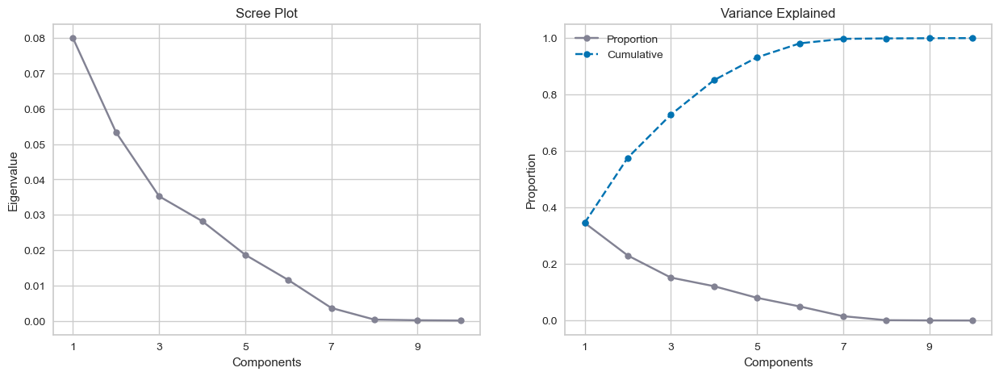

In [108]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (15, 5))

# drawing plots
ax1.plot(pca.explained_variance_, marker = '.', markersize = 12, color = '#828293')
ax2.plot(pca.explained_variance_ratio_, marker = '.', markersize = 12, label = 'Proportion', color = '#828293')
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker = '.', markersize = 12, linestyle = '--',
         label = 'Cumulative', color = '#0173b2')

# customizations
ax2.legend()
ax1.set_title('Scree Plot')
ax2.set_title('Variance Explained')
ax1.set_ylabel('Eigenvalue')
ax2.set_ylabel('Proportion')
ax1.set_xlabel('Components')
ax2.set_xlabel('Components')
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

Analysing the two plots, we conclude that the number of principal components to retain must be **either 5 or 7**, depending on the proportion of data variation that we want to keep. 

So, we can perform PCA again with 7 principal components. We can also calculate the correlations of the principal components with the original features, as they are useful for understand the contribution of each feature to the PCs and how the PCs are related to the original features.

In [109]:
# creating an instance of the principal component analysis and fitting to the data we have and transforming it
pca = PCA(n_components = 7, random_state = 5)
pca_feat = pca.fit_transform(df_pca[features_to_pca])

# getting the names of the principal components
pca_feat_names = [f'PC{i}' for i in range(pca.n_components_)]

# converting the PCA to a dataframe
pca_df = pd.DataFrame(pca_feat, index = df_pca.index, columns = pca_feat_names)

# reassigning df_pca to contain the new created PCA variables
df_pca = pd.concat([df_pca, pca_df], axis = 1)
df_pca.head().T

ID,61172,9700,37077,42413,104423
Age,0.559524,0.488095,0.47619,0.238095,0.214286
DaysSinceCreation,0.328391,0.860638,0.532987,0.472202,0.042995
AverageLeadTime,0.002747,0.038462,0.153846,0.005495,0.491758
LodgingRevenue,0.2475,0.3475,0.0825,0.1185,0.084
OtherRevenue,0.324,0.2,0.024,0.1432,0.132
BookingsCanceled,0.0,0.0,0.0,0.0,0.0
BookingsNoShowed,0.0,0.0,0.0,0.0,0.0
BookingsCheckedIn,0.076923,0.038462,0.038462,0.038462,0.038462
PersonsNights,0.125,0.208333,0.0625,0.0625,0.041667
DistributionChannel,Direct,Travel Agent/Operator,Travel Agent/Operator,Travel Agent/Operator,Travel Agent/Operator


In [110]:
def _color_red_or_green(val):
    """
    function that colors the dataframe background with green (or red) if there is a positive (or negative) strong correlation
    """
    
    if val < -0.45:
        color = 'background-color: #f87c7a'
    elif val > 0.45:
        color = 'background-color: #86e4b8'
    else:
        color = ''
    return color

# we can obtain the loadings (the correlation between PCs and original features) and compare the metric features with the
# principal components that we have
loadings = df_pca.corr(numeric_only = True).loc[features_to_pca, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3,PC4,PC5,PC6
PersonsNights,0.106546,0.367115,0.635659,0.021206,-0.031877,0.178982,0.645212
BookingsCanceled,0.003897,-0.007272,0.035411,-0.020396,-0.000325,0.012294,0.022602
Age,-0.033859,0.442184,-0.255277,-0.853315,0.042299,0.090540,0.005141
BookingsCheckedIn,0.061335,-0.017578,0.155567,-0.070622,0.019141,0.071150,0.040688
BookingsNoShowed,-0.000170,-0.002819,0.025458,-0.017254,0.000762,0.008630,0.008567
LodgingRevenue,0.243477,0.250948,0.749826,0.017981,-0.033241,0.543676,-0.135984
DaysSinceCreation,-0.987858,0.134224,0.063018,0.040690,0.012616,0.017358,-0.005762
OtherRevenue,0.122064,0.436624,0.742632,-0.184795,-0.131454,-0.434040,-0.056009
NumberRequests,0.097553,0.105967,0.170370,0.042756,0.971743,-0.063716,-0.007468
AverageLeadTime,0.180291,0.894815,-0.268587,0.306610,-0.022081,0.006775,-0.010843


Looking at this dataframe we see that `Principal Component 0` is the most informative component, as it is highly correlated with `DaysSinceCreation` (almost -1 in the correlation coefficient). `Principal Component 1` explains `AverageLeadTime`, while `Principal Component 2` is correlated with more variables, as it is highly correlated with `OtherRevenue`, `LodgingRevenue`, and `PersonsNights`. The rest of the principal components explain roughly the other variables, altough it is worth noting that none of the Principal Components that were created truly represent the variables `BookingsCheckedIn`, `BookingsNoShowed`, and `BookingsCanceled`, which can be a problem.

<a id = "summary"></a>

### 2.11. Summary data exploration

[Back to Data Preparation](#preparation-index)

We can check if the data looks the way we expect it to.

- Have we missed some outliers? 
- Are there still missing values?
- Is the data normalized?

We also will do the plots again to check if we missed anything regarding information or mistakes in the dataset.

In [111]:
# getting the main descriptive statistics

df_pca.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,69589.0,4.153496e-01,0.176403,0.000000,0.273810,0.416667,0.535714,1.000000
DaysSinceCreation,69589.0,4.772165e-01,0.280095,0.000000,0.243884,0.486286,0.713862,1.000000
AverageLeadTime,69589.0,2.292813e-01,0.219001,0.000000,0.049451,0.159341,0.357143,1.000000
LodgingRevenue,69589.0,1.966614e-01,0.143451,0.000000,0.100800,0.159880,0.246000,1.000000
OtherRevenue,69589.0,1.675985e-01,0.160758,0.000000,0.056000,0.118000,0.226000,1.000000
BookingsCanceled,69589.0,4.263126e-04,0.015210,0.000000,0.000000,0.000000,0.000000,1.000000
BookingsNoShowed,69589.0,1.796261e-04,0.010206,0.000000,0.000000,0.000000,0.000000,1.000000
BookingsCheckedIn,69589.0,4.098736e-02,0.016950,0.000000,0.038462,0.038462,0.038462,1.000000
PersonsNights,69589.0,1.316249e-01,0.087293,0.000000,0.062500,0.125000,0.166667,1.000000
SRHighFloor,69589.0,4.341203e-02,0.203784,0.000000,0.000000,0.000000,0.000000,1.000000


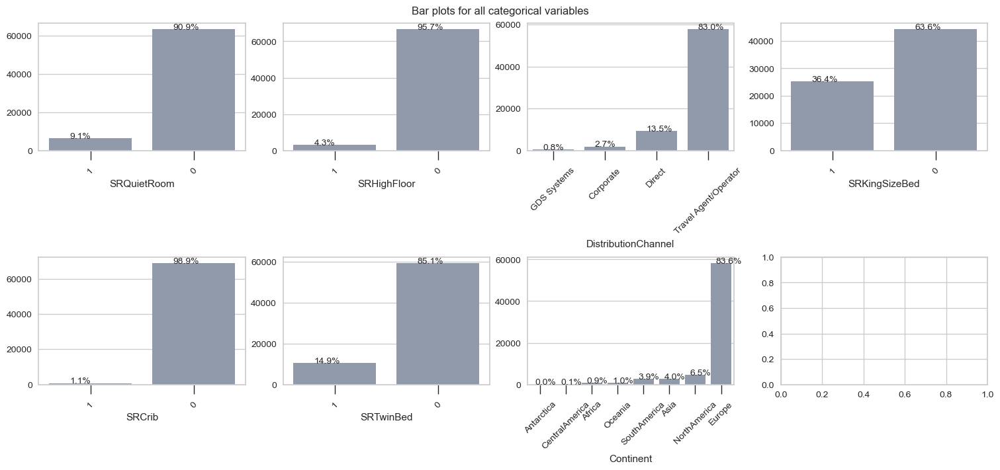

In [112]:
# bar plots for non-metric features

plot_bar(df_pca, non_metric_features, 2, (15, 7))

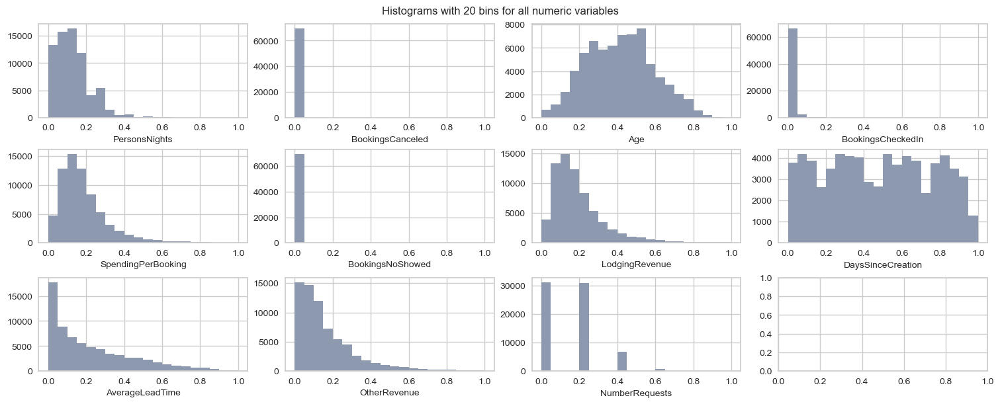

In [113]:
# histograms for metric features

plot_histogram(df_pca, metric_features, 3)

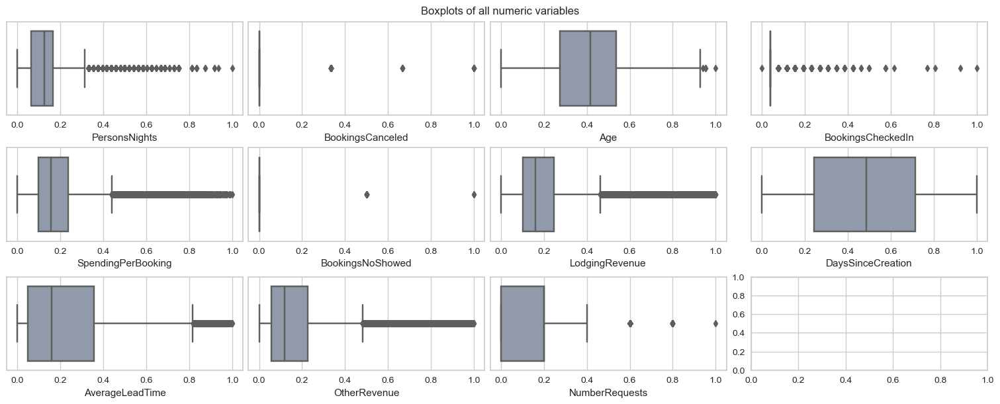

In [114]:
# box-plots for metric features

plot_box(df_pca, metric_features, 3)

The same can be seen in the box-plots.

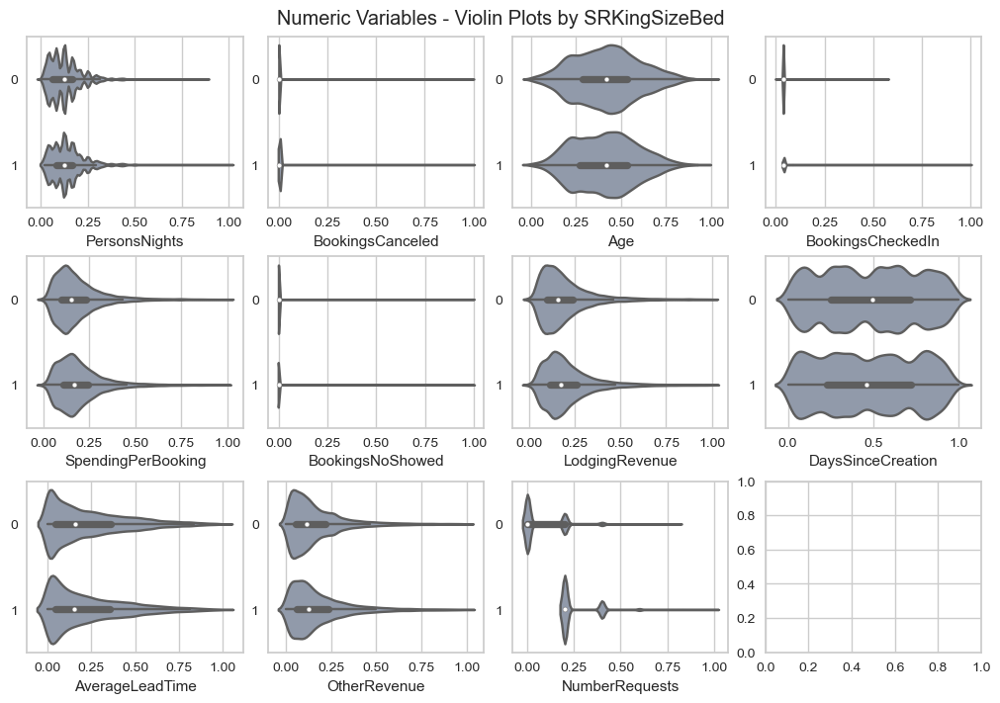

In [115]:
plot_violin(df_pca, metric_features, 'SRKingSizeBed', 3, (10, 7))

Regarding the request for a king-size bed, we do not notice any significative difference in the distribution of the metric features by wether it is asked for it or not, except for `NumberRequests`, where we see that people that ask for a king-size bed most of the times only make that request, or some of them make another request as well. 

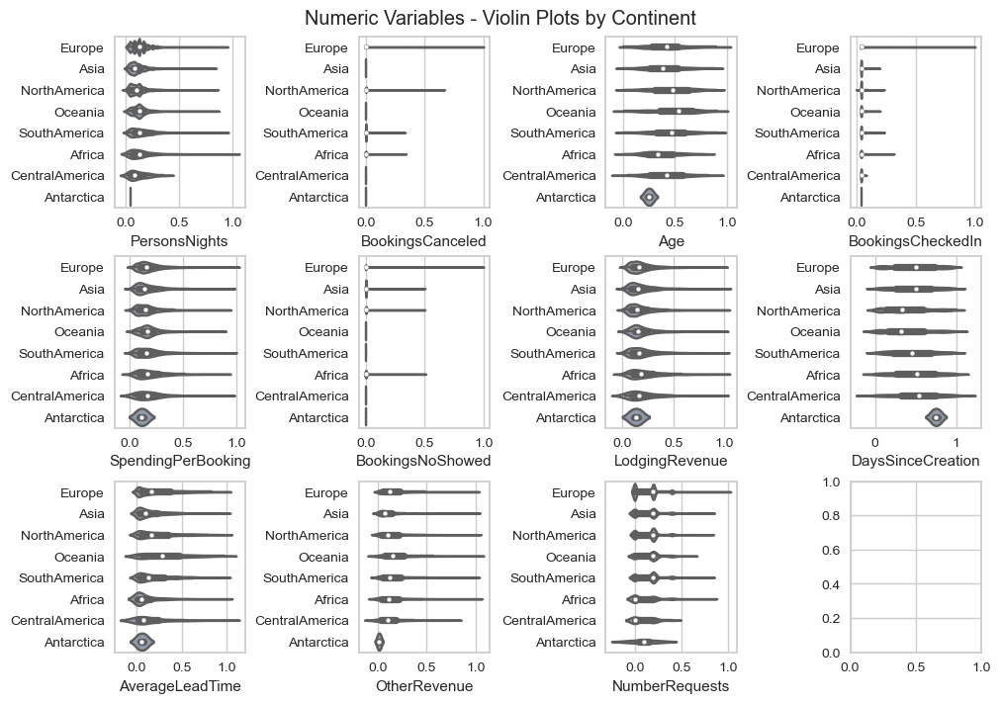

In [116]:
plot_violin(df_pca, metric_features, 'Continent', 3, (10, 7))

As for `Continent`, we also don't see differences in the distributions between the different regions.

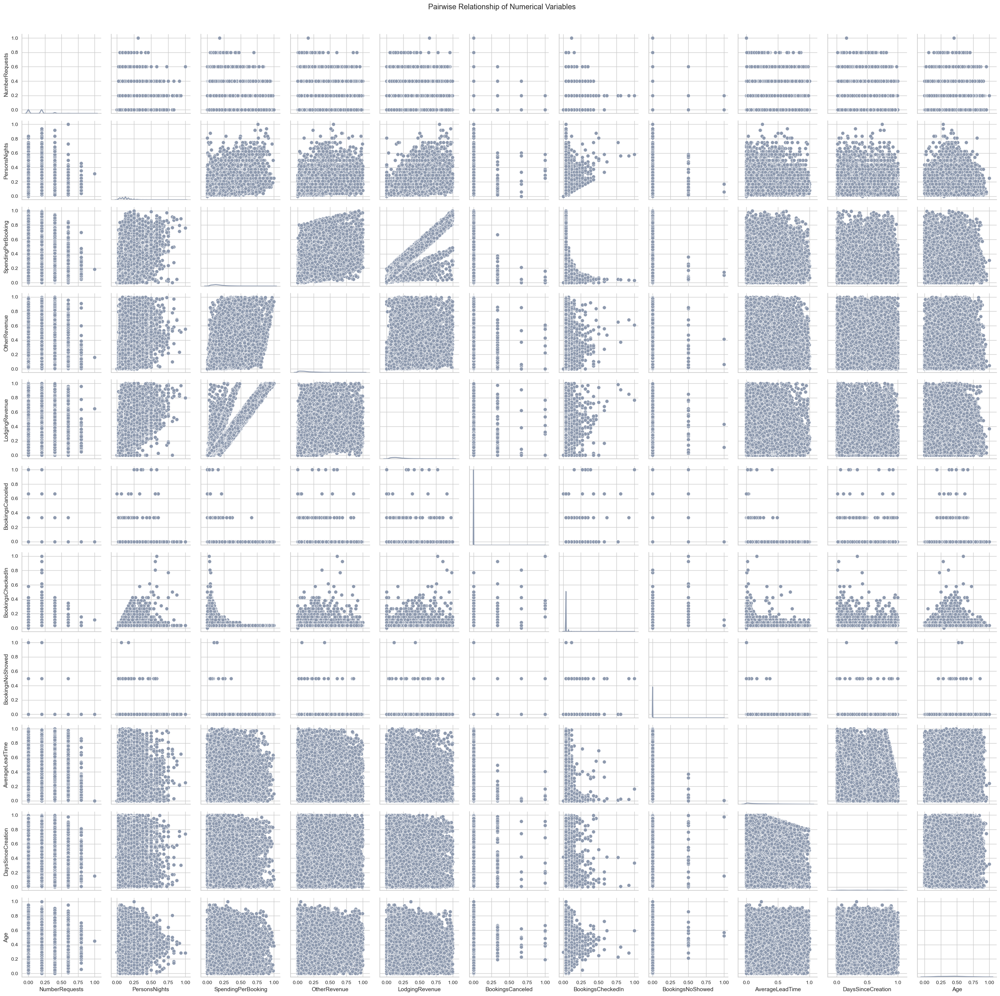

In [119]:
# relationships between metric features

plot_numerical_relationship(df_pca, metric_features)

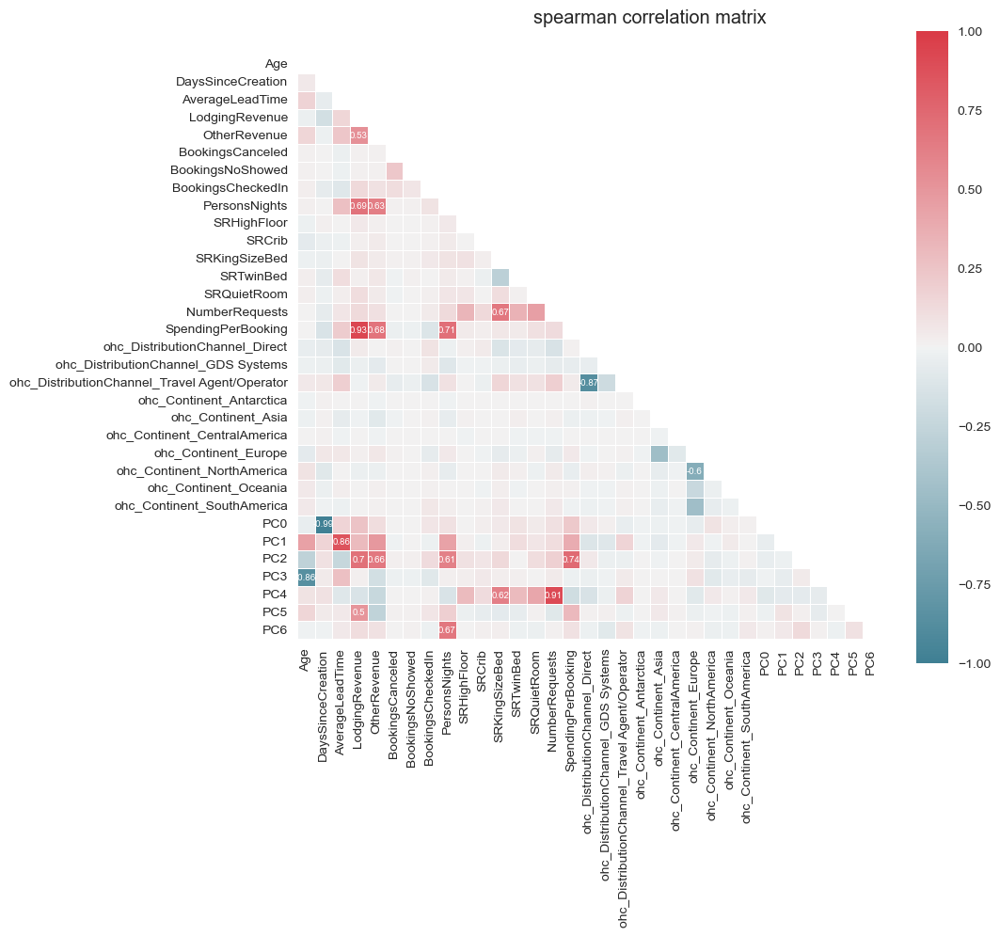

In [117]:
# final correlation matrix

corr_matrix(df_pca, 'spearman')

We don't have significant correlations (nor negative nor positive) between the variables that we are going to use in the clustering solution (PC0, PC1, PC2, and PC3).

<a id = "modelling"></a>

## 3. Modelling

<a id = "modelling-index"></a>

- [3.1. K-Means](#k-means)

[Back to TOC](#toc)

<a id = "k-means"></a>

### 3.1. K-means

- [3.2.1. Functions and number of clusters](#k-means-functions)
- [3.2.2. Clustering solution](#k-means-clustering)

[Back to Modelling](#modelling-index)

K-means clustering is an unsupervised algorithm used to group similar data points together. It is a partition-based clustering algorithm that divides a dataset into k clusters based on their similarity. It minimizes the sum of squared distances between the observations and their assigned cluster centroids. This algorithm works by first specifying the number of clusters k to create. Then, the k data points are randomly initialized in the data space, and for each data point, it assigns the data point to the cluster with the nearest centroid, based on the Euclidean distance. The mean of all data points assigned to each centroid is calculated, and the centroid is moved to that mean. This process is repeated until the centroids no longer move or change only minimally.

<a id = "k-means-functions"></a>

#### 3.2.1. Functions and number of clusters

Since the k-means algorithm needs the number of clusters we want to use *apriori*, we can decide it by plotting the distortion (measures the sum of squared distances between each data point and the centroid of its assigned cluster) against the number of clusters. As the number of clusters increases, the within-cluster sum of squares generally decreases, since each data point is closer to its centroid. Then, we can identify the "elbow" in the plot, that is the point at which the distortion begins to decrease more slowly, and chose this number of clusters, because beyond a certain point, increasing the number of clusters results in diminishing returns in terms of reducing WCSS. So, the "elbow" indicates the point at which the decrease in distortion is no longer substantial, and adding more clusters is not worth the cost in terms of the increase in complexity.

Another way to identify the ideal number of clusters is to compute the silhouette score for each point in the dataset, which is a measure of how similar an observation is to its own cluster compared to other clusters. We compute the nearest-cluster distance (the average distance between that point and all points in the nearest cluster), subtract the intra-cluster distance (the average distance between that point and all other points in the same cluster), and then divide this value by the maximum of these two values. Therefore, the silhouette score ranges from -1 to 1, with higher values indicating better clustering. The idea is to choose the number of clusters that leads to the highest average similarity within clusters and the lowest similarity between clusters.

In [118]:
def get_ss(data):
    """
    function that computes the sum of squares for all variables given a dataset
    """
    
    ss = np.sum(data.var() * (data.count() - 1))
    # returning the sum of squares of each df variable
    return ss

In [119]:
def r2(data, labels):
    """
    function that returns the r-squared metric for a given dataset and a given clustering solution
    """
    
    sst = get_ss(data)
    ssw = np.sum(data.groupby(labels).apply(get_ss))
    # returning the r2
    return 1 - ssw/sst

In [120]:
def silhouette(data, labels):
    """
    function that returns the silhouette score for a given dataset and cluster labels
    """
    
    silhouette = silhouette_score(data, labels, metric = 'euclidean')
    return silhouette

In [121]:
def plot_distortion(data):
    """ 
    function that plots the distortions according to the number of clusters used
    """
    
    # list to store the distortions
    distortions = []
    for k in list(range(1, 10)):
        kmean_model = KMeans(n_clusters = k, random_state = 5, n_init = 'auto').fit(data)
        distortions.append(kmean_model.inertia_)

    # plotting the figure
    plt.figure(figsize = (8, 6))
    plt.plot(range(1, 10), distortions, color = '#8d99ae', marker = 'x')
    plt.xlabel('k')
    plt.ylabel('Distortions')
    plt.title('Inertia of the model')
    plt.show()

In [122]:
# adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

def avg_silhouette(data):
    """
    function that computes the average silhouette score for different numbers of clusters
    """
    
    avg_silhouette = []
    all_cluster_labels = []
    for nclus in list(range(1, 10)):
        if nclus == 1:
            continue

        # initialize the KMeans object with n_clusters value and a random generator
        kmclust = KMeans(n_clusters = nclus, init = 'k-means++', n_init = 15, random_state = 5)
        cluster_labels = kmclust.fit_predict(data)
        all_cluster_labels.append(cluster_labels)

        # the silhouette_score gives the average value for all the samples
        silhouette_avg = silhouette_score(data, cluster_labels)
        avg_silhouette.append(silhouette_avg)
        
    return avg_silhouette, all_cluster_labels

In [123]:
def plot_silhouette(data):
    """ 
    funtion that plots the silhouette graphs for different numbers of clusters
    """
    
    # calling the defined function to compute the average sihlouette values
    silhouette_avg, all_cluster_labels = avg_silhouette(data)
    
    for nclus in list(range(1, 10)):
        if nclus == 1:
            continue
        
        # creating a figure
        fig = plt.figure(figsize = (13, 7))
            
        print(f'For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg[nclus - 2]}')

        # compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(data, all_cluster_labels[nclus - 2])

        y_lower = 10
        for i in range(nclus):
            # aggregate the silhouette scores for samples belonging to cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[all_cluster_labels[nclus - 2] == i]
            ith_cluster_silhouette_values.sort()

            # get y_upper to demarcate silhouette y range size
            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            # filling the silhouette
            color = cm.nipy_spectral(float(i) / nclus)
            plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor = color,
                              edgecolor = color, alpha = 0.7)

            # label the silhouette plots with their cluster numbers at the middle
            plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        plt.title('Silhouette plot for the various clusters')
        plt.xlabel('Silhouette coefficient values')
        plt.ylabel('Cluster label')

        # the vertical line for average silhouette score of all the values
        plt.axvline(x = silhouette_avg[nclus - 2], color = 'red', linestyle = '--')

        # the silhouette coefficient can range from -1, 1
        xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
        plt.xlim([xmin, xmax])

        # the (nclus+1)*10 is for inserting blank space between silhouette plots of individual clusters demarcating them clearly
        plt.ylim([0, len(data) + (nclus + 1) * 10])

        # clearing the yaxis labels / ticks
        plt.yticks([])
        plt.xticks(np.arange(xmin, xmax, 0.1))

In [124]:
def plot_average_silhouette(data):
    """
    function that plots the average silhouette score for different numbers of clusters
    """
    
    # calling the defined function to compute the average sihlouette values
    silhouette_avg, all_cluster_labels = avg_silhouette(data)
    
    plt.figure(figsize = (16, 8))
    plt.plot(silhouette_avg, color = '#8d99ae', marker = 'x')
    plt.ylabel('Average silhouette')
    plt.xlabel('Number of clusters')
    plt.title('Average silhouette plot over clusters')
    plt.xticks(ticks = range(0, 8), labels = range(2, 10))
    plt.show()

In [125]:
def cluster_cardinality(data, labels):
    """
    function that plots the cardinality of each cluster
    """

    # count number of observations per cluster
    FrequencyByCluster = data.groupby(labels).size()

    # Draw
    fig, ax = plt.subplots(figsize = (10, 8))
    g = sns.countplot(x = labels, color = '#8d99ae')

    # decoration
    for index, d in enumerate(FrequencyByCluster):
        plt.text(x = index - 0.2 , y = d + 50 , s = f"{d}" , fontdict = dict(fontsize = 8))
    plt.title('Cluster cardinality')
    plt.xlabel('Cluster')
    plt.ylabel('Frequency in cluster')
    plt.rc('axes')

    plt.show()

In [126]:
def cluster_magnitude(data_scaled, labels, distances):
    """ 
    function that plots the distances to centroids
    """

    # compute magnitude
    data_scaled['DistanceToCentroid'] = np.min(distances, axis = 1)
    magnitude = data_scaled['DistanceToCentroid'].groupby(labels).sum()
    data_scaled = data_scaled.drop(columns = ['DistanceToCentroid'])

    fig, ax = plt.subplots(figsize = (10, 8))
    g = sns.barplot(x = magnitude.index, y = magnitude.values, color = '#8d99ae')

    # style
    for index,data in enumerate(magnitude):
        plt.text(x = index-0.2 , y = data + 50 , s = f"{data:,.0f}" , fontsize = 8)
    plt.title('Cluster magnitude')
    plt.xlabel('Cluster')
    plt.ylabel('Sum of distances to centroid')
    plt.rc('axes')

In [127]:
def magnitude_cardinality(data, data_scaled, labels, distances):
    """
    function that plots the cluster cardinality against the cluster magnitude in a scatter plot
    """

    # count number of observations per cluster
    FrequencyByCluster = data.groupby(labels).size()

    # compute magnitude
    data_scaled['DistanceToCentroid'] = np.min(distances, axis = 1)
    magnitude = data_scaled['DistanceToCentroid'].groupby(labels).sum()

    # plot
    fig, ax = plt.subplots(figsize = (10, 8))
    g = sns.regplot(x = FrequencyByCluster, y = magnitude, scatter = True, seed = 123, truncate = False, ci = None, color = '#8d99ae')

    plt.title('Cardinality vs Magnitude', fontsize = 12)
    plt.xlabel('Cardinality')
    plt.ylabel('Magnitude')
    plt.rc('axes', labelsize = 10)

In [128]:
def cluster_size_distance(data, kmeans):
    """
    function that plots the distances and the sizes of the clusters created
    """

    # visualizing the clusters sizes and distances in 2D
    visualizer = InterclusterDistance(kmeans, random_state = 5)
    visualizer.fit(data)
    visualizer.show()

In [129]:
def calinski_harabasz_index(data, labels):
    """
    function that returns the Calinski-Harabasz index for a given dataset and cluster labels
    """

    ch_score = calinski_harabasz_score(data, labels)
    return ch_score

In [130]:
def davies_bouldin_index(data, labels):
    """
    function that returns the Davies-Bouldin index for a given dataset and cluster labels
    """

    db_score = davies_bouldin_score(data, labels)
    return db_score

#### Deciding the number of clusters

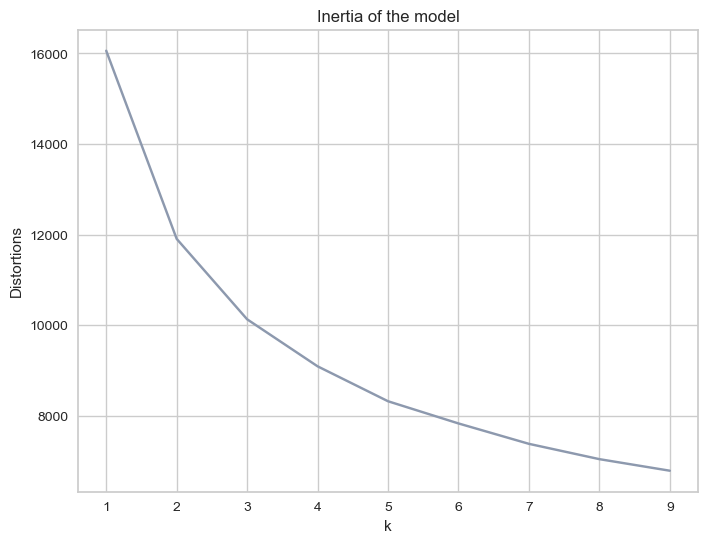

In [134]:
# plotting the distortions against the number of clusters

plot_distortion(df_pca[pca_feat_names])

The best solution according to inertia plot seems to be between 4 and 6 clusters.

For n_clusters = 2, the average silhouette_score is : 0.243619800319869
For n_clusters = 3, the average silhouette_score is : 0.23692200473623748
For n_clusters = 4, the average silhouette_score is : 0.2391201209438654
For n_clusters = 5, the average silhouette_score is : 0.21367544675436434
For n_clusters = 6, the average silhouette_score is : 0.16419135269992235
For n_clusters = 7, the average silhouette_score is : 0.15543160741219578
For n_clusters = 8, the average silhouette_score is : 0.15842247151687633
For n_clusters = 9, the average silhouette_score is : 0.14907753562304085


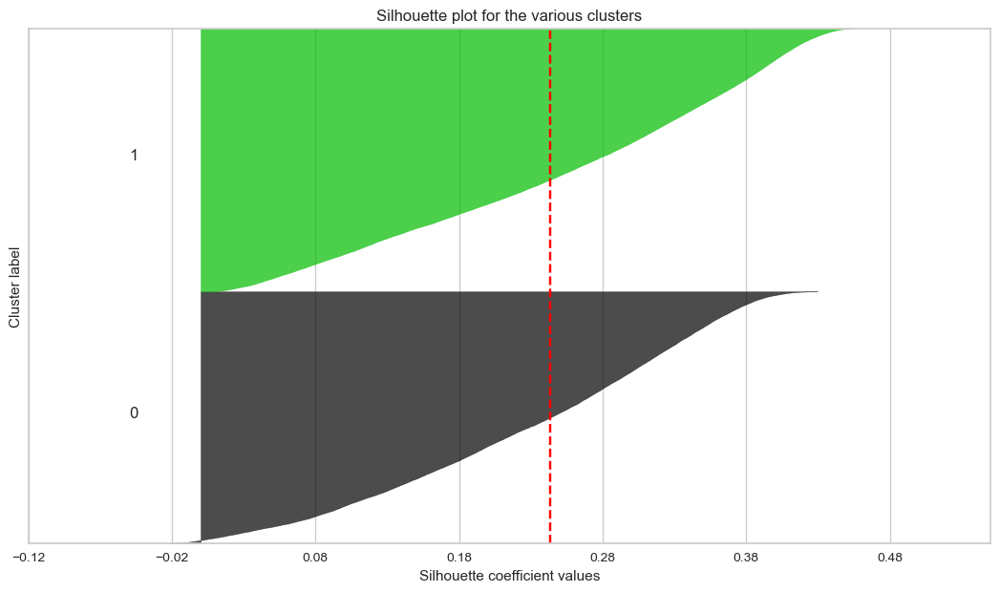

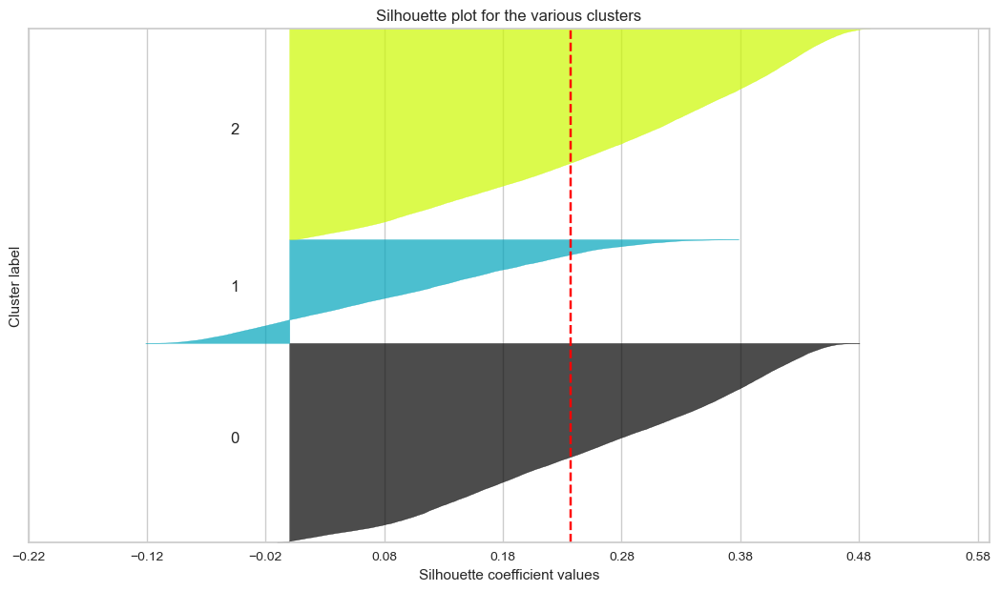

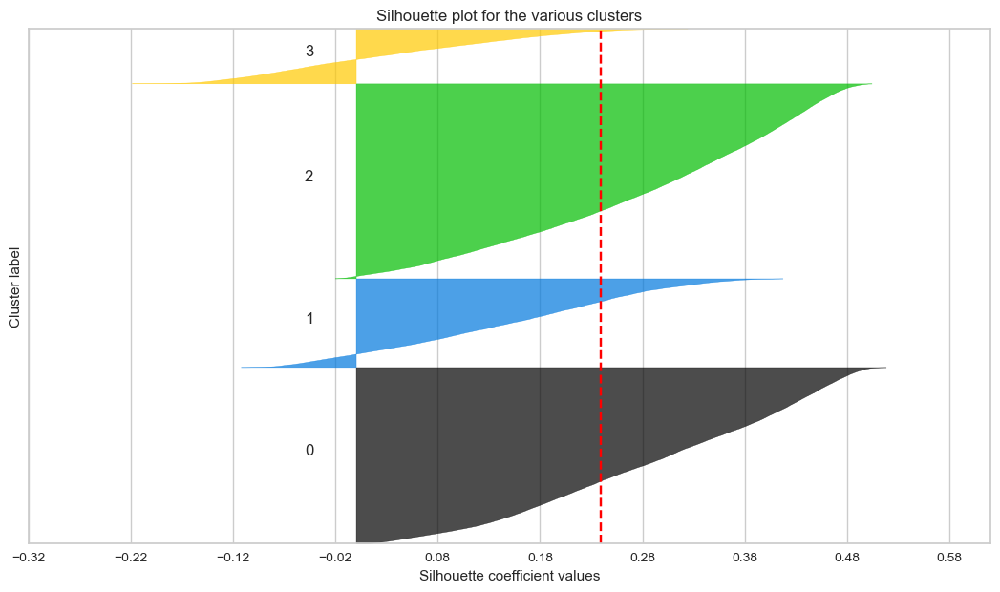

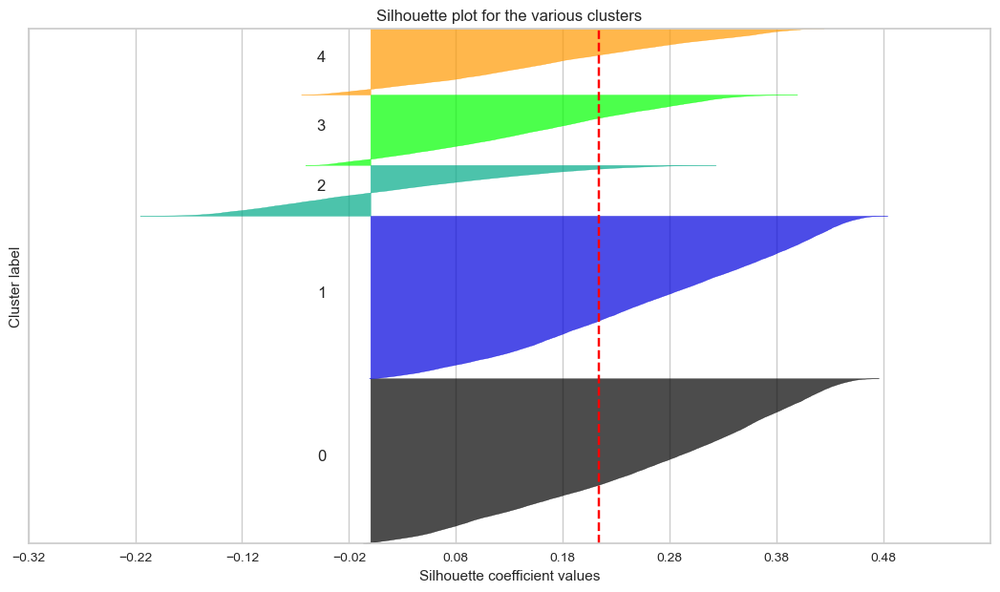

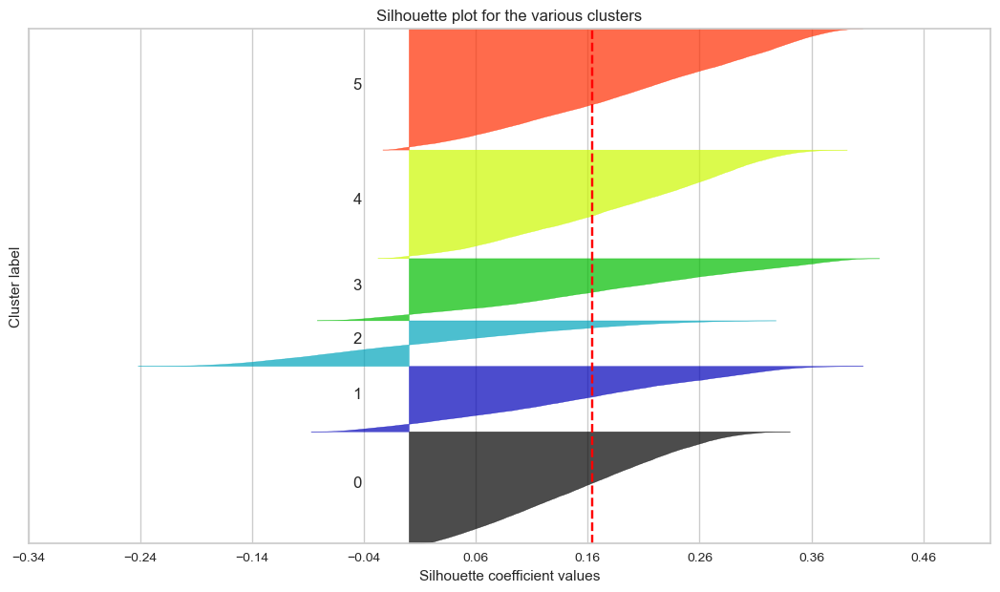

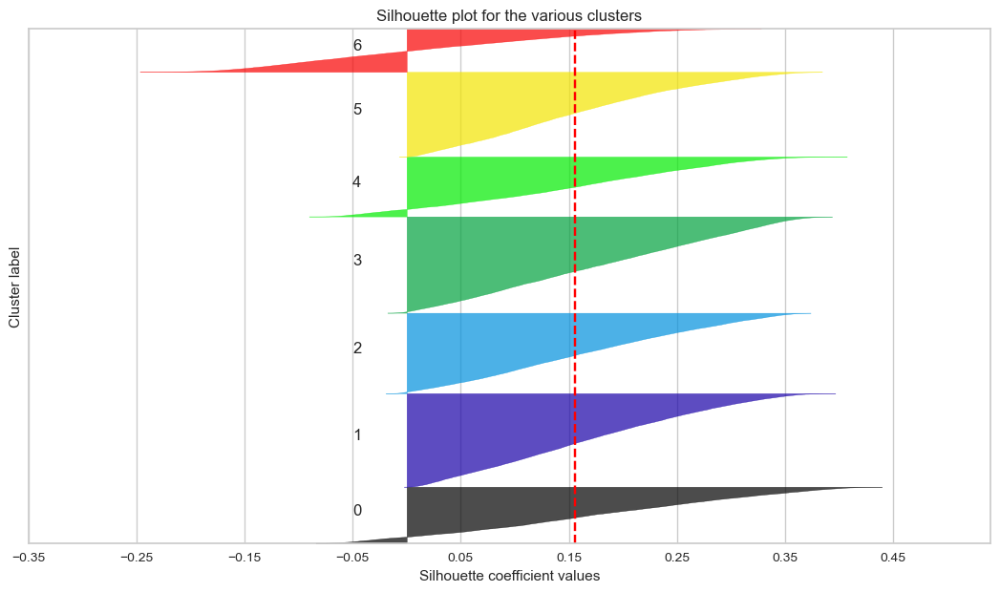

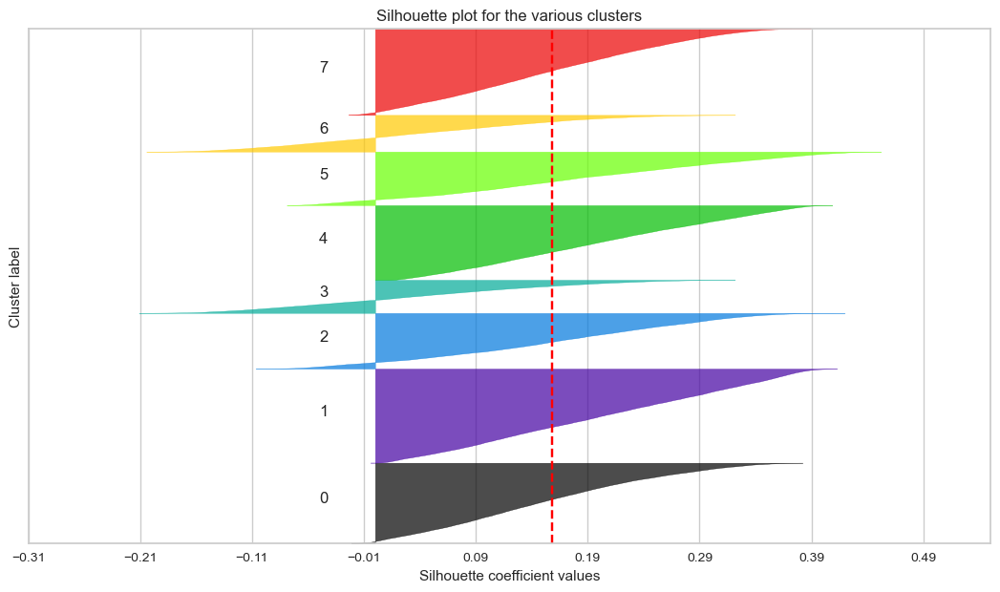

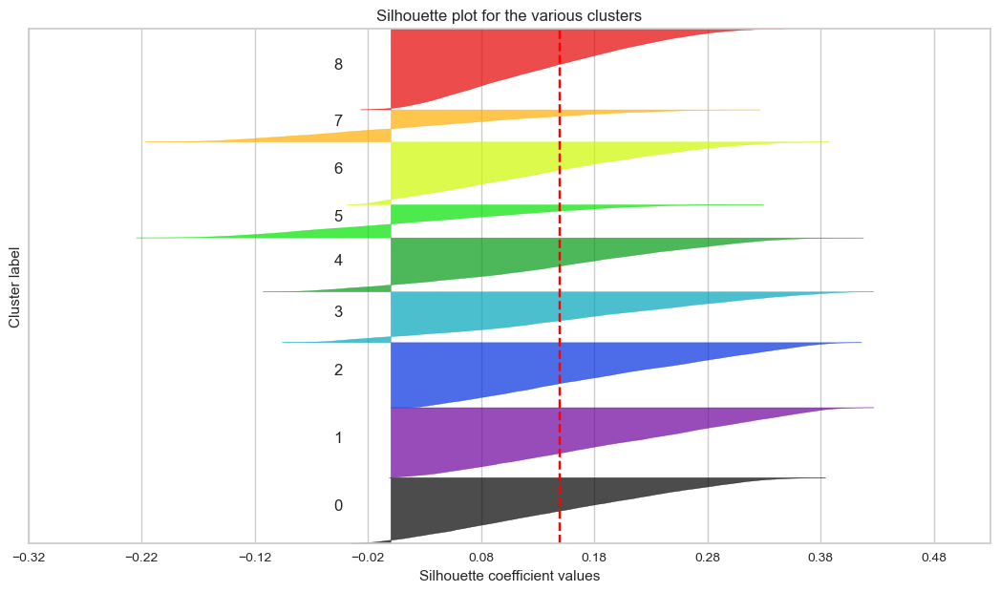

In [135]:
# plotting the silhouette of each cluster against the number of clusters

plot_silhouette(df_pca[pca_feat_names])

The best solution according these silhouette plots seems to be between 3 or 4 clusters.

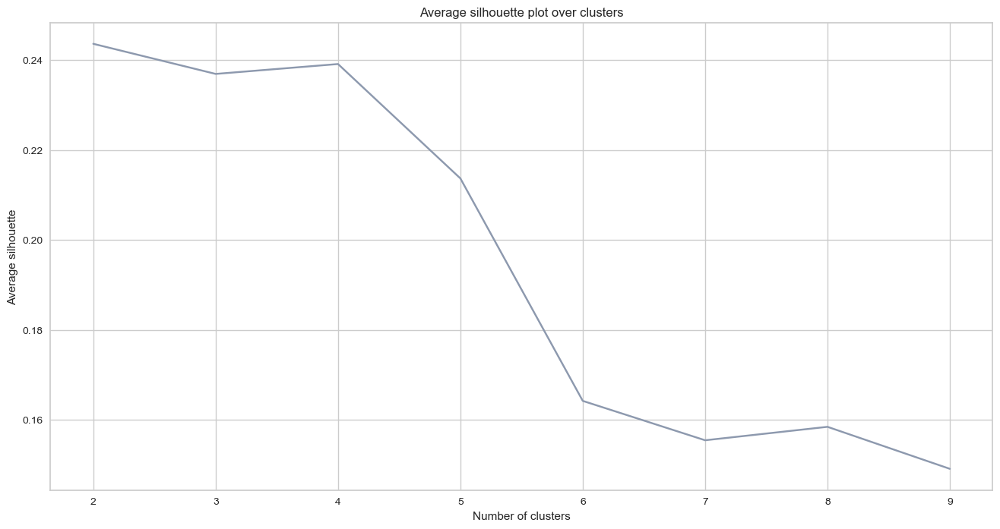

In [136]:
# plotting the average silhouette against the number of clusters

plot_average_silhouette(df_pca[pca_feat_names])

<a id = "k-means-clustering"></a>

#### 3.2.2. Clustering solution

Knowing the previous informations, it was decided that the ideal number of clusters should be either 4 or 5. So, we can create the two solutions, and then decide which one is the best.

In [131]:
# 4 cluster solution

number_clusters = 4
kmclust_4 = KMeans(n_clusters = number_clusters, init = 'random', n_init = 15, random_state = 5)
alldistances_4 = kmclust_4.fit_transform(df_pca[pca_feat_names])
km_labels_4 = kmclust_4.predict(df_pca[pca_feat_names])

# characterizing the 4 clusters

df_km_4_scaled = pd.concat((df_pca, pd.Series(km_labels_4, name = 'KmLabels', index = df_pca.index)), axis = 1)

df_km_4 = pd.concat((df_ohc, pd.Series(km_labels_4, name = 'KmLabels', index = df_ohc.index)), axis = 1)
df_km_4.groupby('KmLabels').mean(numeric_only = True)

,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,SRHighFloor,...,ohc_DistributionChannel_Direct,ohc_DistributionChannel_GDS Systems,ohc_DistributionChannel_Travel Agent/Operator,ohc_Continent_Antarctica,ohc_Continent_Asia,ohc_Continent_CentralAmerica,ohc_Continent_Europe,ohc_Continent_NorthAmerica,ohc_Continent_Oceania,ohc_Continent_SouthAmerica
KmLabels,,,,,,,,,,,,,,,,,,,,,
0,47.549450,1043.967349,55.863140,310.637849,65.266947,0.001062,0.000341,1.035988,5.651536,0.042890,...,0.118051,0.005612,0.846416,0.000076,0.047744,0.001555,0.847630,0.046834,0.006750,0.038301
1,56.474045,584.241996,215.335618,355.144075,88.540846,0.000084,0.000084,1.033854,6.450890,0.040876,...,0.080749,0.000502,0.905291,0.000000,0.016635,0.000502,0.852295,0.073727,0.019644,0.034356
2,44.112852,358.384838,46.381142,347.889452,55.117653,0.001134,0.000168,1.069887,5.207602,0.039731,...,0.162663,0.015246,0.790046,0.000000,0.045149,0.000924,0.814364,0.083578,0.007266,0.038471
3,47.376847,571.088504,87.869997,892.773019,233.528070,0.004432,0.001477,1.208434,12.015445,0.061107,...,0.194333,0.003358,0.781493,0.000000,0.029949,0.001343,0.840048,0.057615,0.010341,0.049154


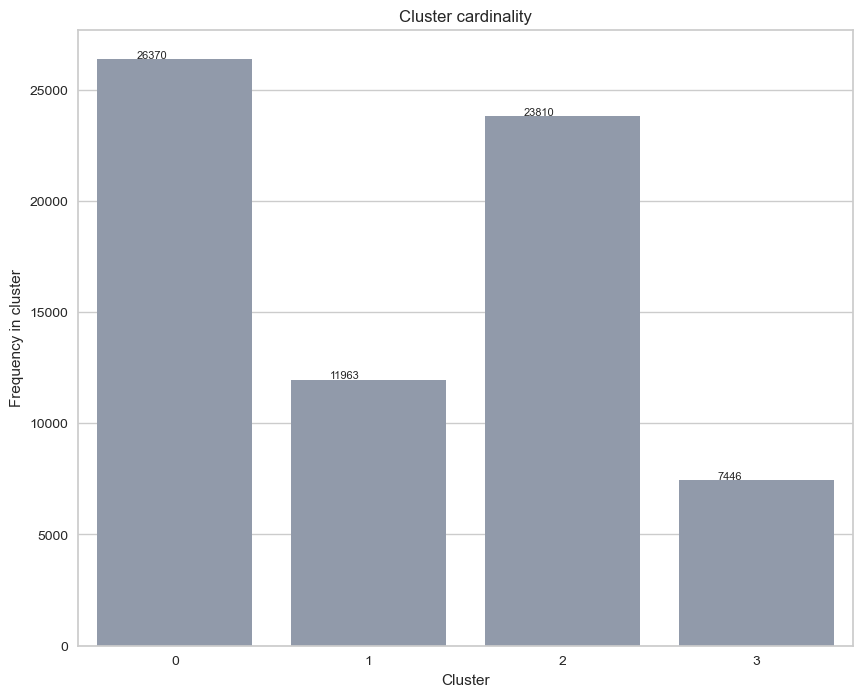

In [132]:
cluster_cardinality(df_km_4, df_km_4['KmLabels'])

Having more or less the same cardinality (number of points) for each cluster is desirable, because it is easier to interpret the characteristics and properties of each cluster and because clusters with significantly different sizes may lead to imbalanced representation of the underlying data. Here, in this case, it can be seen that cluster 2 and cluster 3 have more observations that the first two ones, but the discrepancy is not significant.

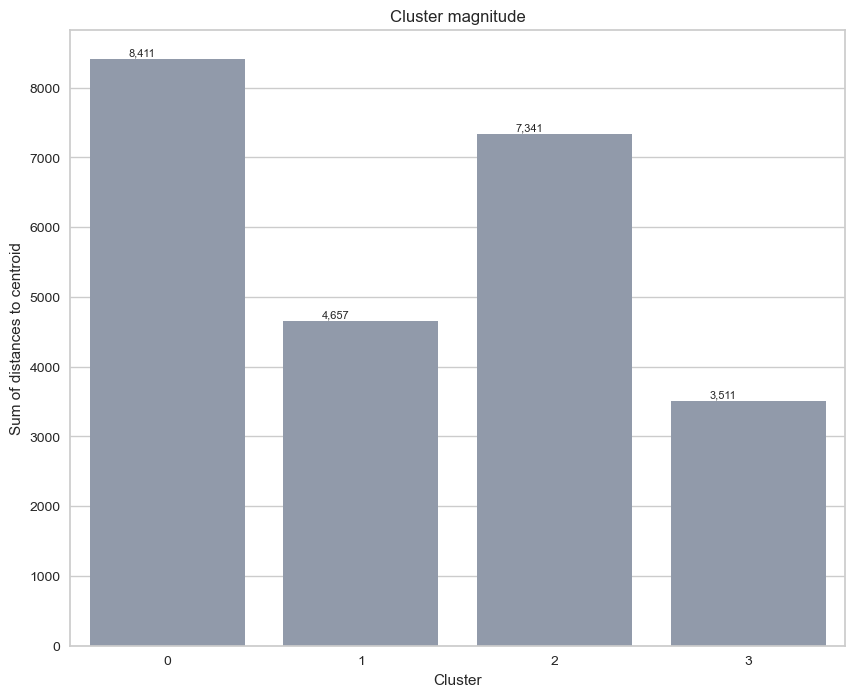

In [133]:
cluster_magnitude(df_km_4_scaled, df_km_4_scaled['KmLabels'], alldistances_4)

The sum of distances to centroid is a measure of the compactness of a cluster. The sum of the Euclidean distances between each data point in the cluster and the centroid (average of all the data points in the cluster) of that cluster is calculated. In general, a clustering solution with smaller sum of distances to centroid indicates that the data points in each cluster are more tightly packed around their respective centroids, and thus the clustering solution is more compact and well-separated. But this measure should be combined with other measures, like the silhouette score, for example.

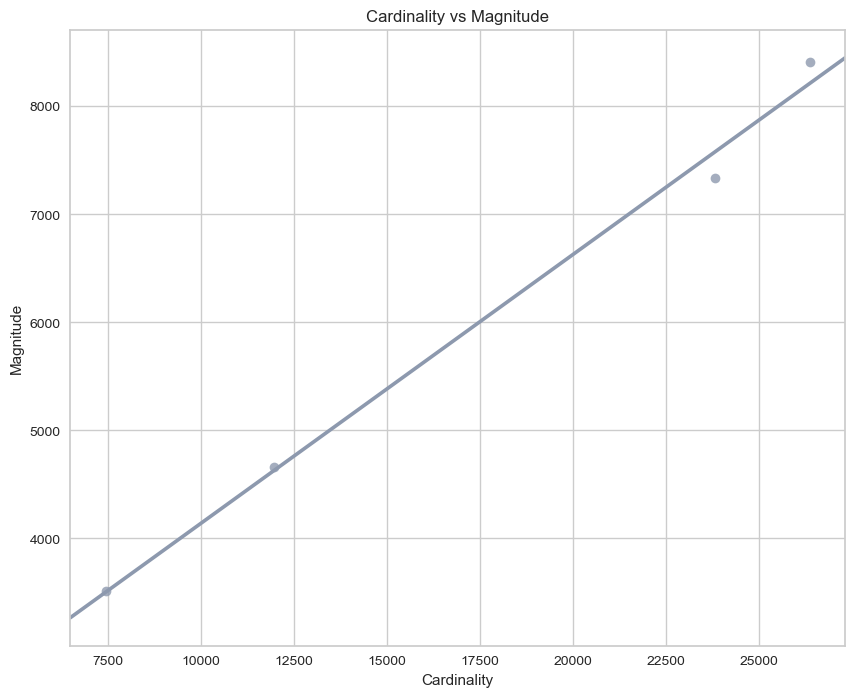

In [134]:
magnitude_cardinality(df_km_4, df_km_4_scaled, df_km_4_scaled['KmLabels'], alldistances_4)

Cluster magnitude and cluster size should be balanced, as they reflect different aspects of the quality of a clustering solution. So, we should have clusters that are both dense and tighly packed around their respective centroid. Since in this case cardinality is correlated with magnitude, no major anomalies were detected on the clusters.

c:\Users\beatr\anaconda3\envs\BusinessCases\lib\site-packages\sklearn\base.py:420: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names

c:\Users\beatr\anaconda3\envs\BusinessCases\lib\site-packages\sklearn\manifold\_mds.py:299: FutureWarning:

The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.



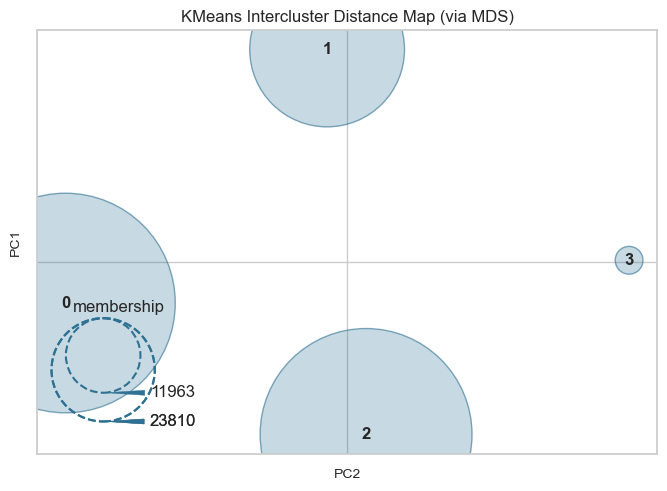

In [135]:
cluster_size_distance(df_pca[pca_feat_names], kmclust_4)

So, as we can see, the clusters are well separated from each other, as the distances in the representation are high. As for the size of the circles, they represent the number or instances that belong to each center, so, as stated before, cluster 3 is the smaller one, while cluster 2 and 3 have more observations.

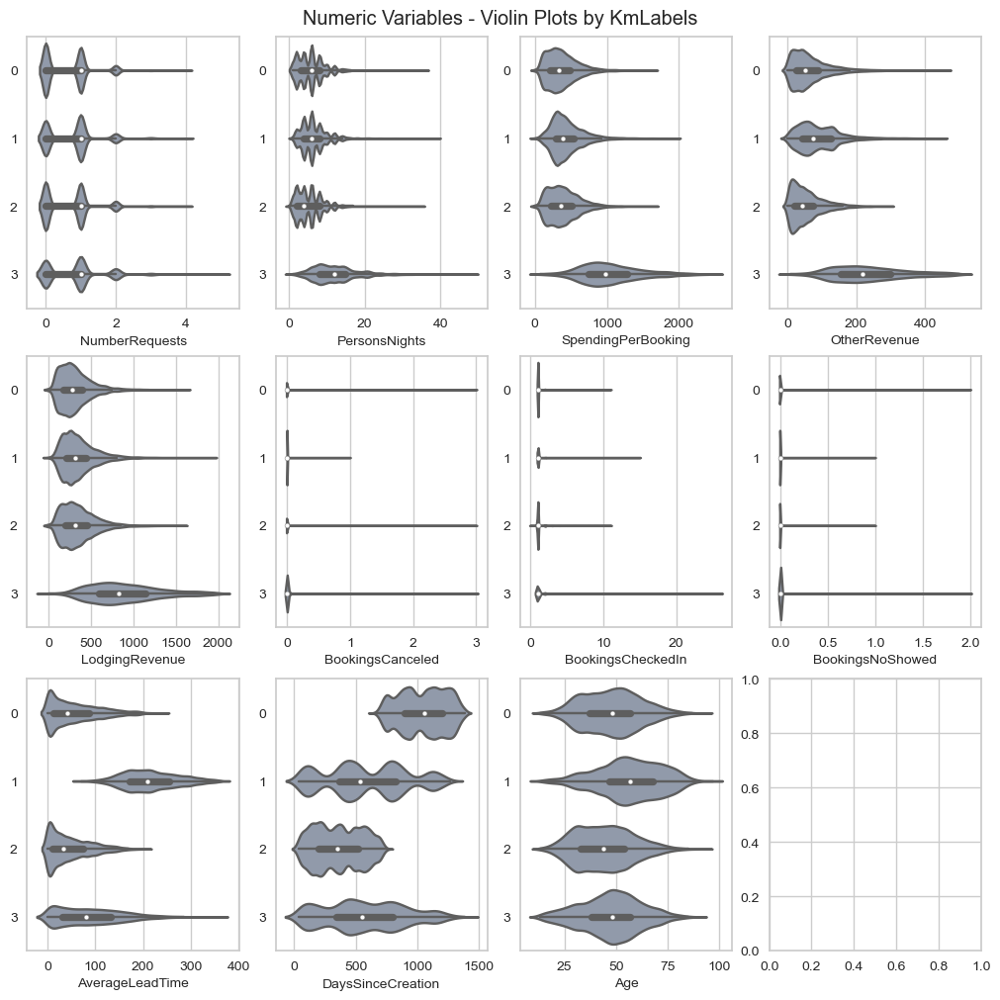

In [142]:
# plotting the distributions of the numerical variables by cluster

plot_violin(df_km_4, metric_features, 'KmLabels', 3, (10, 10))

**conclusions**

In [143]:
# 5 cluster solution

number_clusters = 5
kmclust_5 = KMeans(n_clusters = number_clusters, init = 'random', n_init = 15, random_state = 5)
alldistances_5 = kmclust_5.fit_transform(df_pca[pca_feat_names])
km_labels_5 = kmclust_5.predict(df_pca[pca_feat_names])

# characterizing the 5 clusters

df_km_5_scaled = pd.concat((df_pca, pd.Series(km_labels_5, name = 'KmLabels', index = df_pca.index)), axis = 1)

df_km_5 = pd.concat((df_ohc, pd.Series(km_labels_5, name = 'KmLabels', index = df_ohc.index)), axis = 1)
df_km_5.groupby('KmLabels').mean(numeric_only = True)

,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,SRHighFloor,...,ohc_DistributionChannel_Direct,ohc_DistributionChannel_GDS Systems,ohc_DistributionChannel_Travel Agent/Operator,ohc_Continent_Antarctica,ohc_Continent_Asia,ohc_Continent_CentralAmerica,ohc_Continent_Europe,ohc_Continent_NorthAmerica,ohc_Continent_Oceania,ohc_Continent_SouthAmerica
KmLabels,,,,,,,,,,,,,,,,,,,,,
0,53.102747,961.201510,189.999266,350.292814,88.115390,0.000105,0.000000,1.020445,6.940029,0.043615,...,0.078843,0.000315,0.908891,0.00000,0.022017,0.000944,0.887712,0.045502,0.005976,0.034389
1,43.695204,373.402126,39.316378,339.982027,53.617843,0.001226,0.000182,1.071941,5.068081,0.040285,...,0.166046,0.016532,0.783132,0.00000,0.047643,0.000999,0.812381,0.082932,0.006222,0.038923
2,47.089358,1043.800449,39.986484,302.308186,61.863884,0.001257,0.000404,1.039695,5.396542,0.042119,...,0.124338,0.006601,0.833947,0.00009,0.050067,0.001617,0.839335,0.049304,0.007050,0.040009
3,47.292440,589.234099,78.110396,900.813188,238.211502,0.004825,0.001462,1.222693,11.929522,0.063313,...,0.196081,0.003509,0.777160,0.00000,0.030999,0.001316,0.841644,0.053955,0.009651,0.050738
4,55.119341,295.770731,191.081242,409.128484,90.056639,0.000000,0.000224,1.043030,6.736105,0.038884,...,0.098723,0.000448,0.894330,0.00000,0.019050,0.000336,0.828216,0.090654,0.027566,0.031376


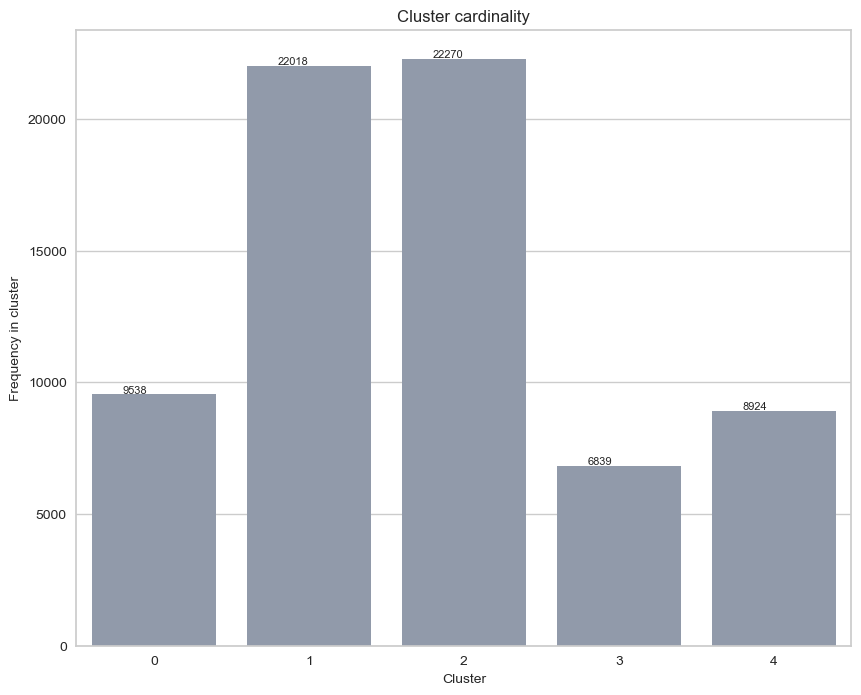

In [144]:
cluster_cardinality(df_km_5, df_km_5['KmLabels'])

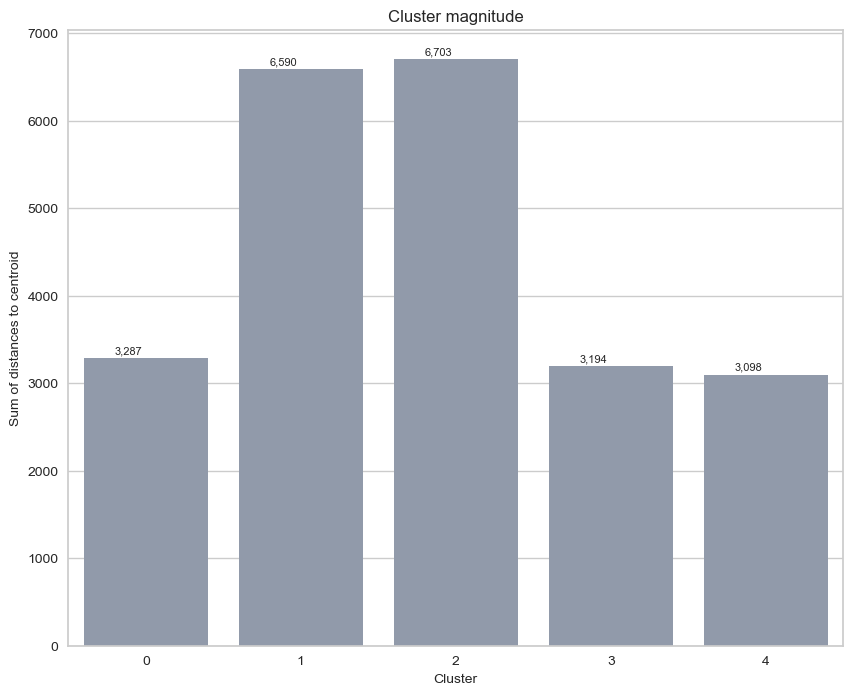

In [145]:
cluster_magnitude(df_km_5_scaled, df_km_5_scaled['KmLabels'], alldistances_5)

The cardinality of the clusters is balanced, as well as the magnitude.

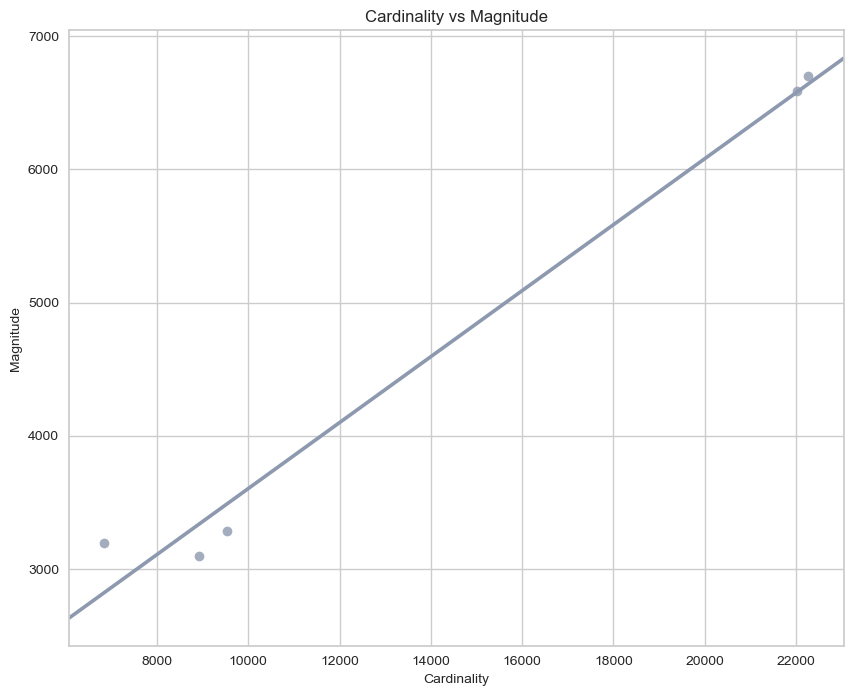

In [146]:
magnitude_cardinality(df_km_5, df_km_5_scaled, df_km_5_scaled['KmLabels'], alldistances_5)

In this case cardinality is also correlated with magnitude, no major anomalies were detected on the clusters.

c:\Users\beatr\anaconda3\envs\BusinessCases\lib\site-packages\sklearn\base.py:420: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names

c:\Users\beatr\anaconda3\envs\BusinessCases\lib\site-packages\sklearn\manifold\_mds.py:299: FutureWarning:

The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.



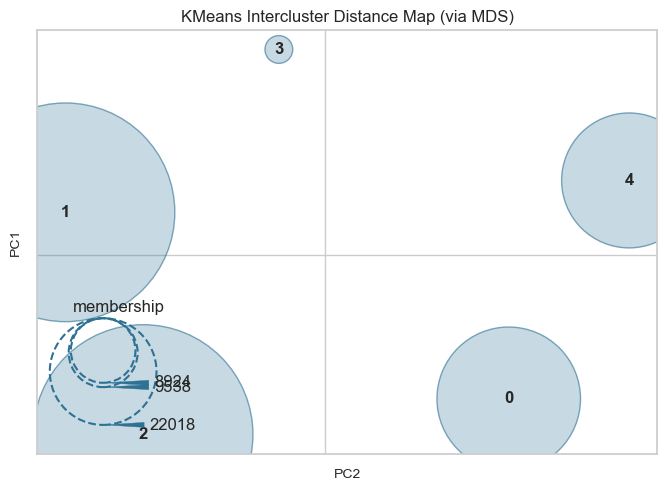

In [147]:
cluster_size_distance(df_pca[pca_feat_names], kmclust_5)

The conclusions that were taken before are valid now. The only detail that is worth mentioning, is that as we can see, clusters 0, 1, and 2 are closer now, and cluster 0 in the 4 cluster solution corresponds to cluster 3 in the 5 cluster solution. 

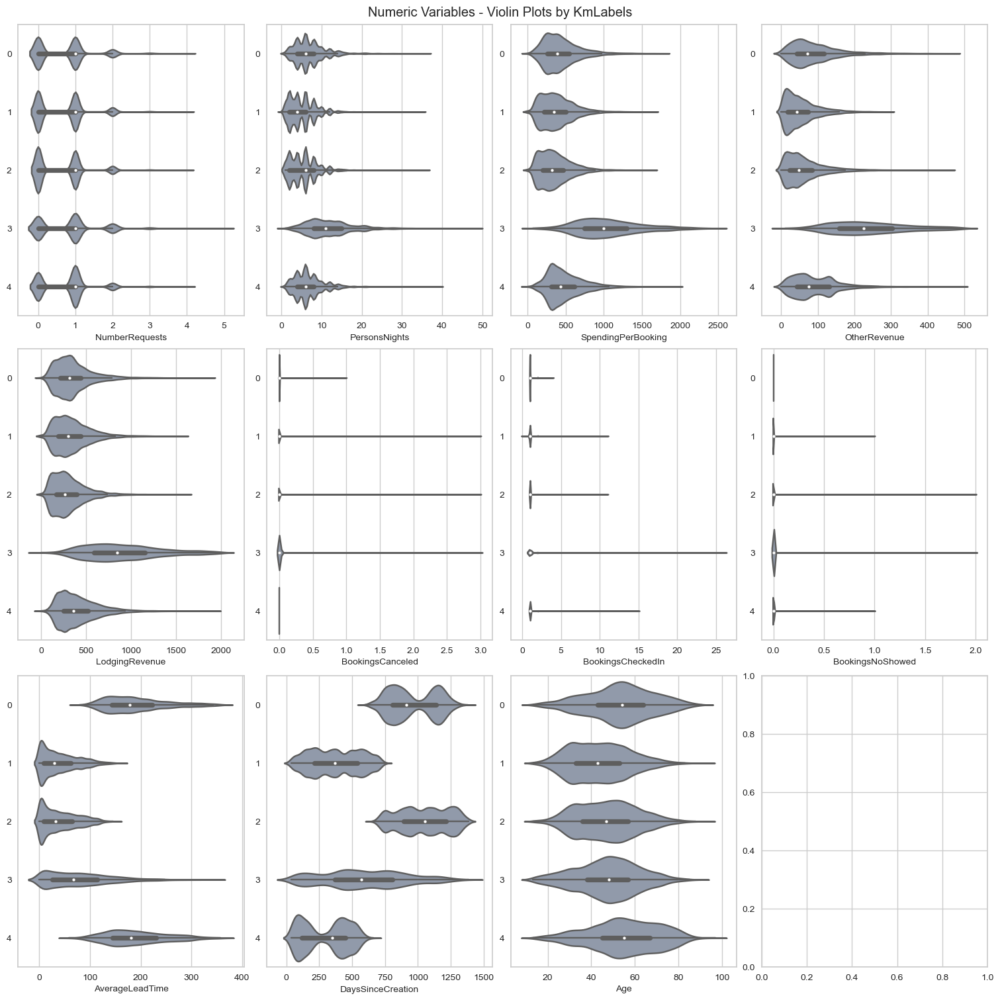

In [148]:
# plotting the distributions of the numerical variables by cluster

plot_violin(df_km_5, metric_features, 'KmLabels', 3, (15, 15))

### Final decision

In [149]:
# calculating the r2

r2_km4 = r2(df_km_4_scaled[metric_features + ['KmLabels']], 'KmLabels')
r2_km5 = r2(df_km_5_scaled[metric_features + ['KmLabels']], 'KmLabels')

print('The r2 for the 4 clusters solution is ' + str(r2_km4) + ' and the r2 for the 5 clusters solution is ' + str(r2_km5))

The r2 for the 4 clusters solution is 0.8967203837710461 and the r2 for the 5 clusters solution is 0.9219611622964818


R-squared measures the proportion of variance in the data that is explained by the clustering solution, so based on this metric, we can conclude that the 5 cluster solution provides better results.

In [150]:
# calculating the silhouette score

silhouette_km4 = silhouette(df_km_4_scaled[metric_features], df_km_4_scaled['KmLabels'])
silhouette_km5 = silhouette(df_km_5_scaled[metric_features], df_km_5_scaled['KmLabels'])

print('The silhouette for the 4 clusters solution is ' + str(silhouette_km4) + ' and the silhouette for the 5 clusters solution is ' + str(silhouette_km5))

The silhouette for the 4 clusters solution is 0.2337749652815928 and the silhouette for the 5 clusters solution is 0.20762700102962592


The silhouette score measures how well each observation fits its assigned cluster relative to other clusters. It provides a measure of how well-separeted the clusters are, and how well a data point fits within its assigned cluster, based on the distance between the data point and the centroid of the cluster it belongs to. The higher the score, the better the clustering solution, therefore, based on this information, we conclude that the 4 cluster solution is better.

In [151]:
# calculating the Davies-Bouldin score

db_km4 = davies_bouldin_index(df_km_4_scaled[metric_features], df_km_4_scaled['KmLabels'])
db_km5 = davies_bouldin_index(df_km_5_scaled[metric_features], df_km_5_scaled['KmLabels'])

print('The Davies-Bouldin score for the 4 clusters solution is ' + str(db_km4) + ' and the Davies-Bouldin score for the 5 clusters solution is ' + str(db_km5))

The Davies-Bouldin score for the 4 clusters solution is 1.4172014485553799 and the Davies-Bouldin score for the 5 clusters solution is 1.4964266126711625


This score measures the quality of a clustering solution by computing the average similarity between each cluster and its most similar cluster, relative to the cluster size and dispersion. The average of the ratio of the sum of within-cluster distances to the distance between the centroids of a pair of cluster is calculated, and this ratio is calculated for all possible pairs of clusters. The ideal score is 0 (indicating perfect clustering), and the bigger the score, the worse the clustering solution.

This measure takes into account both the separation and compactness of the clusters, as well as the size and dispersion of the clusters, so we can conclude that the 4 cluster solution is better.

In [152]:
# calculating the Calinski and Harabasz score

ch_km4 = calinski_harabasz_index(df_km_4_scaled[metric_features], df_km_4_scaled['KmLabels'])
ch_km5 = calinski_harabasz_index(df_km_5_scaled[metric_features], df_km_5_scaled['KmLabels'])

print('The Calinski and Harabasz score for the 4 clusters solution is ' + str(ch_km4) + ' and the Calinski and Harabasz score for the 5 clusters solution is ' + str(ch_km5))

The Calinski and Harabasz score for the 4 clusters solution is 17599.03290847769 and the Calinski and Harabasz score for the 5 clusters solution is 15750.580678588363


This index measures the ratio of between-cluster variance to the within-cluster variance. It is calculated as the ratio of the sum of squared distances between the cluster centroids and the overall centroid to the sum of squared distances between the data points and their respective cluster centroids, multiplied by the ratio of the total number of data points to the total number of clusters minus one. Of course, the higher the measure, the better the clustering solution, therefore the ideal number of clusters to use according to this metric is 4. 

Taking into account all of the previous measures, as well as the results of the clustering solution (the means of all numeric variables by cluster), it was decided that the final solution includes 4 clusters.

<a id = "evaluation"></a>

## 4. Evaluation

<a id = "evaluation-index"></a>

- [4.1. Functions](#evaluation-functions)
- [4.2. Final results](#evaluation-results)
- [4.3. Classifying outliers](#classifying-outliers)

[Back to TOC](#toc)

<a id = "evaluation-functions"></a>

### 4.1. Functions

[Back to Evaluation](#evaluation-index)

In [146]:
# defining the colors for the plots regarding the characteristics of each cluster

colors_clusters = ['#0173b2', '#de8f05', '#029e73', '#cc78bc']

In [171]:
def cluster_distributions(n_clusters, data, labels_name):
    """
    function to plot the distributions of the features by cluster
    """
    
    fig, axs = plt.subplots(15, n_clusters, figsize = (15, 25), constrained_layout = True)
    palette = colors_clusters
    
    for cluster in range(n_clusters):
        axs[0, cluster].hist(data['DaysSinceCreation'].loc[data[labels_name] == cluster], color = palette[cluster], range = [30, 1390])
        axs[0, cluster].set_title('DaysSinceCreation for Cluster ' + str(cluster))
        axs[1, cluster].hist(data['AverageLeadTime'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 365])
        axs[1, cluster].set_title('AverageLeadTime for Cluster ' + str(cluster))
        axs[2, cluster].hist(data['LodgingRevenue'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 7000])
        axs[2, cluster].set_title('LodgingRevenue for Cluster ' + str(cluster))
        axs[3, cluster].hist(data['OtherRevenue'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 3000])
        axs[3, cluster].set_title('OtherRevenue for Cluster ' + str(cluster))
        axs[4, cluster].hist(data['BookingsCanceled'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 13])
        axs[4, cluster].set_title('BookingsCanceled for Cluster ' + str(cluster))
        axs[5, cluster].hist(data['BookingsNoShowed'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 4])
        axs[5, cluster].set_title('BookingsNoShowed for Cluster ' + str(cluster))
        axs[6, cluster].hist(data['BookingsCheckedIn'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 57])
        axs[6, cluster].set_title('BookingsCheckedIn for Cluster ' + str(cluster))
        axs[7, cluster].hist(data['PersonsNights'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 78])
        axs[7, cluster].set_title('PersonsNights for Cluster ' + str(cluster))
        axs[8, cluster].hist(data['NumberRequests'].loc[data[labels_name] == cluster], color = palette[cluster], range = [0, 5])
        axs[8, cluster].set_title('NumberRequests for Cluster ' + str(cluster))
        axs[9, cluster].bar(data['DistributionChannel'].loc[data[labels_name] == cluster].value_counts().index, data['DistributionChannel'].loc[data[labels_name] == cluster].value_counts(), color = palette[cluster])
        axs[9, cluster].set_title('DistributionChannel for Cluster ' + str(cluster))
        axs[10, cluster].bar(data['SRHighFloor'].loc[data[labels_name] == cluster].value_counts().index, data['SRHighFloor'].loc[data[labels_name] == cluster].value_counts(), color = palette[cluster])
        axs[10, cluster].set_title('SRHighFloor for Cluster ' + str(cluster))
        axs[11, cluster].bar(data['SRCrib'].loc[data[labels_name] == cluster].value_counts().index, data['SRCrib'].loc[data[labels_name] == cluster].value_counts(), color = palette[cluster])
        axs[11, cluster].set_title('SRCrib for Cluster ' + str(cluster))
        axs[12, cluster].bar(data['SRKingSizeBed'].loc[data[labels_name] == cluster].value_counts().index, data['SRKingSizeBed'].loc[data[labels_name] == cluster].value_counts(), color = palette[cluster])
        axs[12, cluster].set_title('SRKingSizeBed for Cluster ' + str(cluster))
        axs[13, cluster].bar(data['SRTwinBed'].loc[data[labels_name] == cluster].value_counts().index, data['SRTwinBed'].loc[data[labels_name] == cluster].value_counts(), color = palette[cluster])
        axs[13, cluster].set_title('SRTwinBed for Cluster ' + str(cluster))
        axs[14, cluster].bar(data['SRQuietRoom'].loc[data[labels_name] == cluster].value_counts().index, data['SRQuietRoom'].loc[data[labels_name] == cluster].value_counts(), color = palette[cluster])
        axs[14, cluster].set_title('SRQuietRoom for Cluster ' + str(cluster))

    plt.show()

In [144]:
def cluster_profiles(data, label_columns, figsize, compar_titles = None): 
    """
    function that plots the main characteristics of the clusters
    pass data with labels columns of one or multiple clustering labels
    then specify this label columns to perform the cluster profile according to them
    """
    
    if compar_titles == None:
        compar_titles = [""] * len(label_columns)

    fig, axes = plt.subplots(nrows = len(label_columns), ncols = 2, figsize = figsize, squeeze = False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # filtering df
        drop_cols = [i for i in label_columns if i != label]
        dfax = data.drop(drop_cols, axis = 1)
        
        # getting the cluster centroids and counts
        centroids = dfax.groupby(by = label, as_index = False).mean()
        counts = dfax.groupby(by = label, as_index = False).count().iloc[:, [0, 1]]
        counts.columns = [label, 'counts']
        
        # setting data
        pd.plotting.parallel_coordinates(centroids, label, color = colors_clusters, ax = ax[0])
        sns.barplot(x = label, y = 'counts', data = counts, ax = ax[1], palette = colors_clusters)

        # setting layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ['Cluster {}'.format(i) for i in range(len(handles))]
        ax[0].annotate(text = titl, xy = (0.95, 1.1), xycoords = 'axes fraction', fontsize = 13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # adaptable to number of clusters
        ax[0].axhline(color = 'black', linestyle = '--')
        ax[0].set_title('Cluster Means - {} Clusters'.format(len(handles)), fontsize = 13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation = -20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel('')
        ax[1].set_ylabel('Absolute Frequency')
        ax[1].set_title('Cluster Sizes - {} Clusters'.format(len(handles)), fontsize = 13)
    
    plt.subplots_adjust(hspace = 0.4, top = 0.90)
    plt.show()

In [173]:
# from https://towardsdatascience.com/how-to-create-and-visualize-complex-radar-charts-f7764d0f3652

class ComplexRadar():
    """
    create a complex radar chart with different scales for each variable
    parameters:
    ----------
    fig : figure object
        matplotlib figure object to add the axes on
    variables : list
        list of variables
    ranges : list
        list of tuples (min, max) for each variable
    n_ring_levels: int, defaults to 5
        number of ordinate or ring levels to draw
    show_scales: bool, defaults to True
        indicates if we the ranges for each variable are plotted
    format_cfg: dict, defaults to None
        dictionary with formatting configurations
    """
    
    def __init__(self, fig, variables, ranges, n_ring_levels = 5, show_scales = True, format_cfg = None):
        
        # default formatting
        self.format_cfg = {
            # axes
            # https://matplotlib.org/stable/api/figure_api.html
            'axes_args': {},
            # tick labels on the scales
            # https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.rgrids.html
            'rgrid_tick_lbls_args': {'fontsize': 8},
            # radial (circle) lines
            # https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.grid.html
            'rad_ln_args': {},
            # angle lines
            # https://matplotlib.org/3.2.2/api/_as_gen/matplotlib.lines.Line2D.html#matplotlib.lines.Line2D
            'angle_ln_args': {},
            # include last value (endpoint) on scale
            'incl_endpoint': False,
            # variable labels (ThetaTickLabel)
            'theta_tick_lbls':{'va': 'top', 'ha': 'center'},
            'theta_tick_lbls_txt_wrap': 15,
            'theta_tick_lbls_brk_lng_wrds': False,
            'theta_tick_lbls_pad': 25,
            # outer ring
            # https://matplotlib.org/stable/api/spines_api.html
            'outer_ring': {'visible': True, 'color': '#d6d6d6'}
        }
        
        if format_cfg is not None:
            self.format_cfg = {k: (format_cfg[k]) if k in format_cfg.keys() else (self.format_cfg[k]) 
                 for k in self.format_cfg.keys()}        
        
        
        # calculate angles and create for each variable an axes
        # consider here the trick with having the first axes element twice (len+1)
        angles = np.arange(0, 360, 360. / len(variables))
        axes = [fig.add_axes([0.1, 0.1, 0.9, 0.9], 
                             polar = True,
                             label = "axes{}".format(i),
                             **self.format_cfg['axes_args']) for i in range(len(variables) + 1)]
        
        # ensure clockwise rotation (first variable at the top N)
        for ax in axes:
            ax.set_theta_zero_location('N')
            ax.set_theta_direction(-1)
            ax.set_axisbelow(True)
        
        # writing the ranges on each axes
        for i, ax in enumerate(axes):

            # here we do the trick by repeating the first iteration
            j = 0 if (i == 0 or i == 1) else i - 1
            ax.set_ylim(*ranges[j])
            # set endpoint to True if you like to have values right before the last circle
            grid = np.linspace(*ranges[j], num = n_ring_levels, endpoint = self.format_cfg['incl_endpoint'])
            gridlabel = ["{}".format(round(x, 2)) for x in grid]
            gridlabel[0] = "" # remove values from the center
            lines, labels = ax.set_rgrids(grid, 
                                          labels = gridlabel, 
                                          angle = angles[j],
                                          **self.format_cfg['rgrid_tick_lbls_args']
                                         )
            
            ax.set_ylim(*ranges[j])
            ax.spines['polar'].set_visible(False)
            ax.grid(visible = False)
            
            if show_scales == False:
                ax.set_yticklabels([])

        # set all axes except the first one unvisible
        for ax in axes[1:]:
            ax.patch.set_visible(False)
            ax.xaxis.set_visible(False)
            
        # setting the attributes
        self.angle = np.deg2rad(np.r_[angles, angles[0]])
        self.ranges = ranges
        self.ax = axes[0]
        self.ax1 = axes[1]
        self.plot_counter = 0
        
        
        # draw (inner) circles and lines
        self.ax.yaxis.grid(**self.format_cfg['rad_ln_args'])
        # draw outer circle
        self.ax.spines['polar'].set(**self.format_cfg['outer_ring'])
        # draw angle lines
        self.ax.xaxis.grid(**self.format_cfg['angle_ln_args'])

        # ax1 is the duplicate of axes[0] (self.ax)
        # remove everything from ax1 except the plot itself
        self.ax1.axis('off')
        self.ax1.set_zorder(9)
        
        # create the outer labels for each variable
        l, text = self.ax.set_thetagrids(angles, labels=variables)
        
        # beautify them
        labels = [t.get_text() for t in self.ax.get_xticklabels()]
        labels = ['\n'.join(textwrap.wrap(l, self.format_cfg['theta_tick_lbls_txt_wrap'], 
                                          break_long_words = self.format_cfg['theta_tick_lbls_brk_lng_wrds'])) for l in labels]
        self.ax.set_xticklabels(labels, **self.format_cfg['theta_tick_lbls'])
        
        for t, a in zip(self.ax.get_xticklabels(), angles):
            if a == 0:
                t.set_ha('center')
            elif a > 0 and a < 180:
                t.set_ha('left')
            elif a == 180:
                t.set_ha('center')
            else:
                t.set_ha('right')

        self.ax.tick_params(axis = 'both', pad = self.format_cfg['theta_tick_lbls_pad'])


    def _scale_data(self, data, ranges):
        """
        scales data[1:] to ranges[0]
        """
        for d, (y1, y2) in zip(data[1:], ranges[1:]):
            assert (y1 <= d <= y2) or (y2 <= d <= y1)
        x1, x2 = ranges[0]
        d = data[0]
        sdata = [d]
        for d, (y1, y2) in zip(data[1:], ranges[1:]):
            sdata.append((d - y1) / (y2 - y1) * (x2 - x1) + x1)
        return sdata
        
    def plot(self, data, *args, **kwargs):
        """
        plots a line
        """
        sdata = self._scale_data(data, self.ranges)
        self.ax1.plot(self.angle, np.r_[sdata, sdata[0]], *args, **kwargs)
        self.plot_counter = self.plot_counter+1
    
    def fill(self, data, *args, **kwargs):
        """
        plots an area
        """
        sdata = self._scale_data(data, self.ranges)
        self.ax1.fill(self.angle, np.r_[sdata, sdata[0]], *args, **kwargs)
        
    def use_legend(self, *args, **kwargs):
        """
        shows a legend
        """
        self.ax1.legend(*args, **kwargs)
    
    def set_title(self, title, pad=25, **kwargs):
        """
        set a title
        """
        self.ax.set_title(title,pad=pad, **kwargs)

<a id = "evaluation-results"></a>

### 4.2. Final results

[Back to Evaluation](#evaluation-index)

In [174]:
mean_results4 = df_km_4.groupby('KmLabels').mean(numeric_only = True)[metric_features]
mean_results4

,NumberRequests,PersonsNights,SpendingPerBooking,OtherRevenue,LodgingRevenue,BookingsCanceled,BookingsCheckedIn,BookingsNoShowed,AverageLeadTime,DaysSinceCreation,Age
KmLabels,,,,,,,,,,,
0,0.608305,5.651536,368.152980,65.266947,310.637849,0.001062,1.035988,0.000341,55.863140,1043.967349,47.549450
1,0.741286,6.450890,436.120891,88.540846,355.144075,0.000084,1.033854,0.000084,215.335618,584.241996,56.474045
2,0.652583,5.207602,388.562551,55.117653,347.889452,0.001134,1.069887,0.000168,46.381142,358.384838,44.112852
3,0.819903,12.015445,1044.211078,233.528070,892.773019,0.004432,1.208434,0.001477,87.869997,571.088504,47.376847


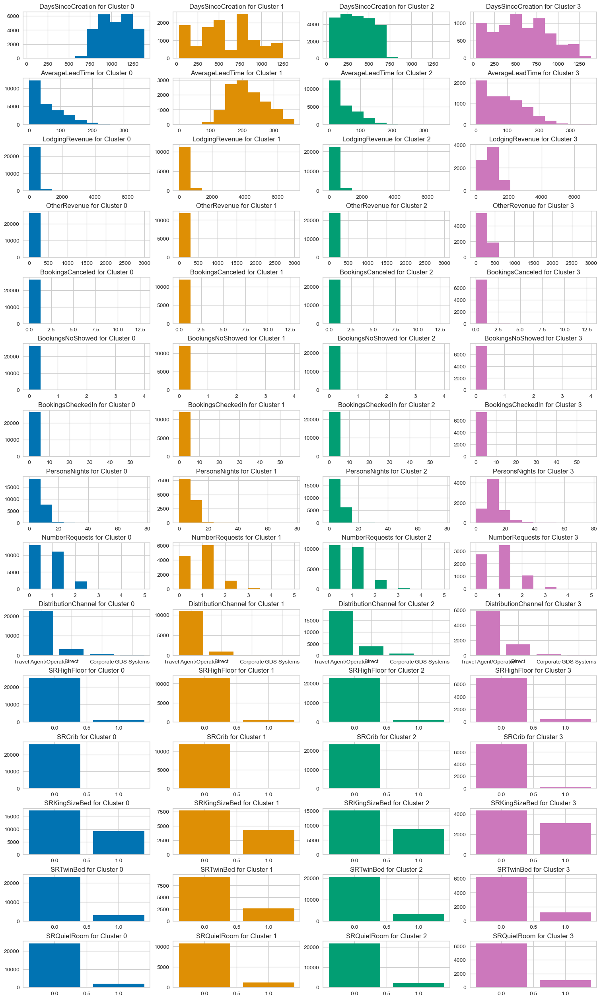

In [175]:
# characteristics of the 4 clusters

cluster_distributions(4, df_km_4, 'KmLabels')

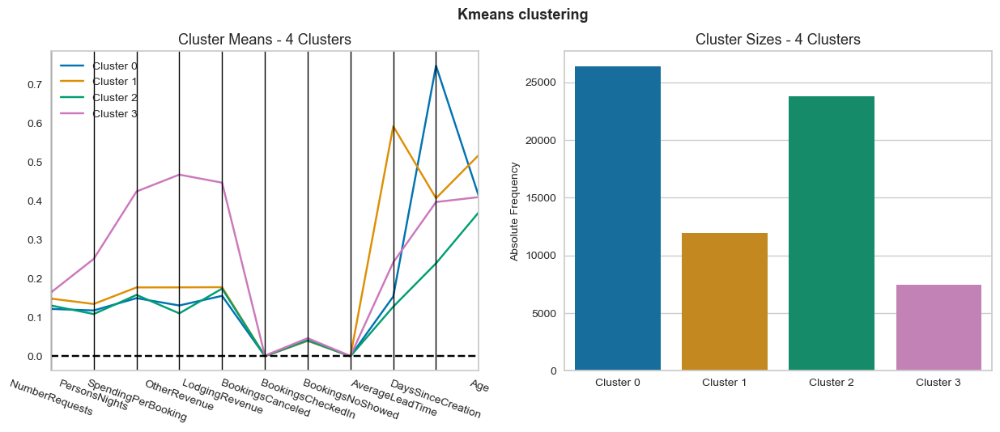

In [176]:
# profilling each cluster

cluster_profiles(
    data = df_km_4_scaled[metric_features + ['KmLabels']], 
    label_columns = ['KmLabels'], 
    figsize = (15, 5), 
    compar_titles = ['Kmeans clustering']
)

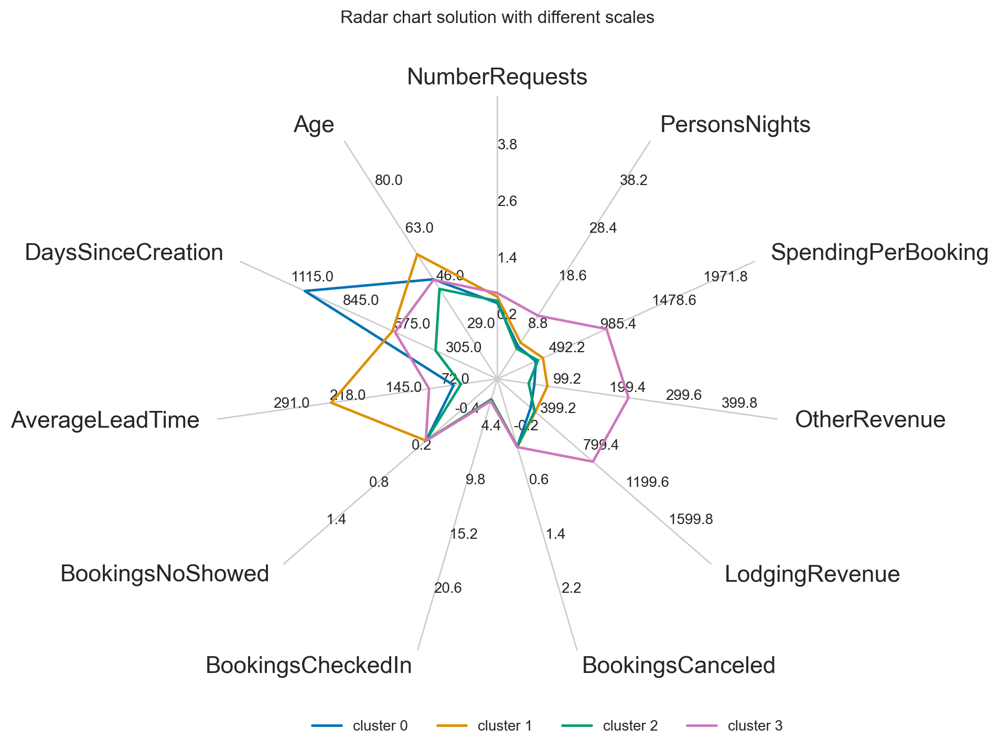

In [184]:
# radar plotting for the different clusters in the same plot

min_max_per_variable = df_km_4[mean_results4.columns].describe().T[['min', 'max']]
min_max_per_variable['min'] = min_max_per_variable['min'].apply(lambda x: int(x) - 1)
min_max_per_variable['max'] = min_max_per_variable['max'].apply(lambda x: ceil(x))

variables = mean_results4.columns
ranges = list(min_max_per_variable.itertuples(index = False, name = None))   

format_cfg = {
    'rad_ln_args': {'visible': False},
    'outer_ring': {'visible': False},
    'rgrid_tick_lbls_args': {'fontsize': 10},
    'theta_tick_lbls': {'fontsize': 16},
    'theta_tick_lbls_pad': 5
}

custom_colors = colors_clusters

fig1 = plt.figure(figsize = (6, 6), dpi = 200)
radar = ComplexRadar(fig1, variables, ranges, show_scales = True, format_cfg = format_cfg)

for g, c in zip(mean_results4.index, custom_colors):
    radar.plot(mean_results4.loc[g].values, label = f"cluster {g}", color = c)
    
radar.set_title('Radar chart solution with different scales', pad = 50)
radar.use_legend(**{'loc': 'lower left', 'bbox_to_anchor': (0.15, -0.15), 'ncol': radar.plot_counter})
plt.show() 

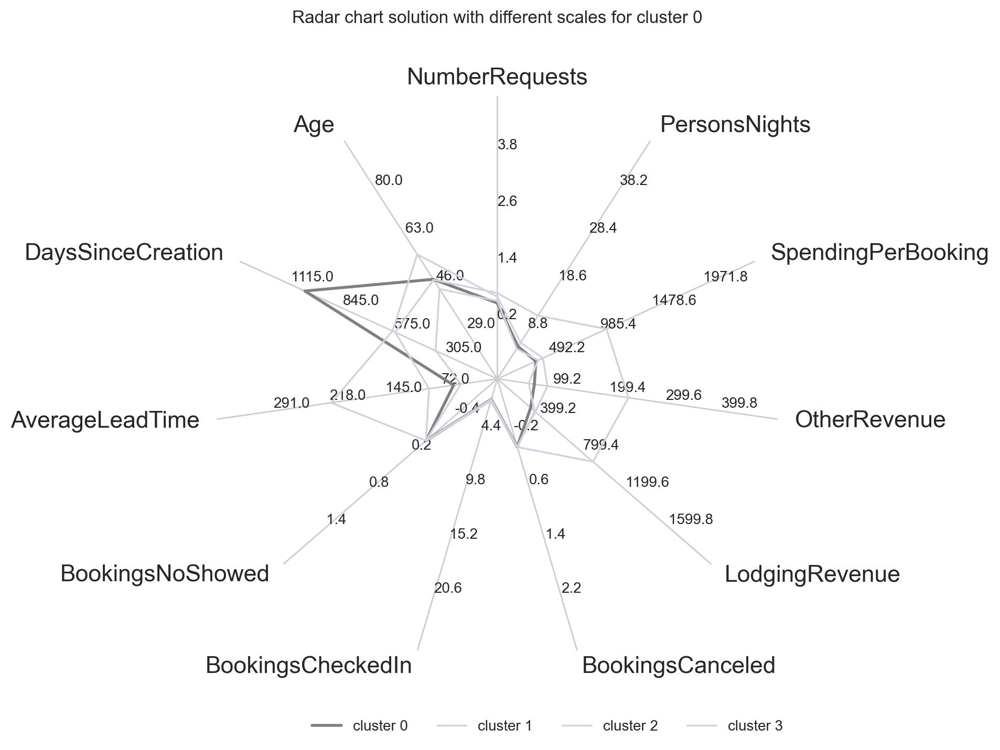

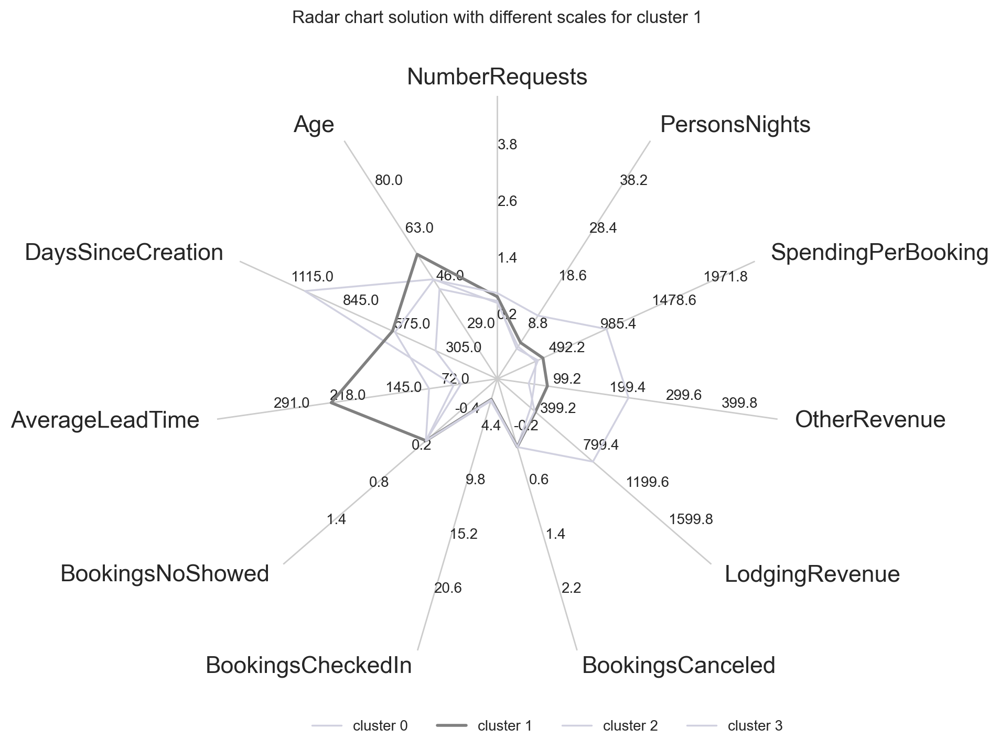

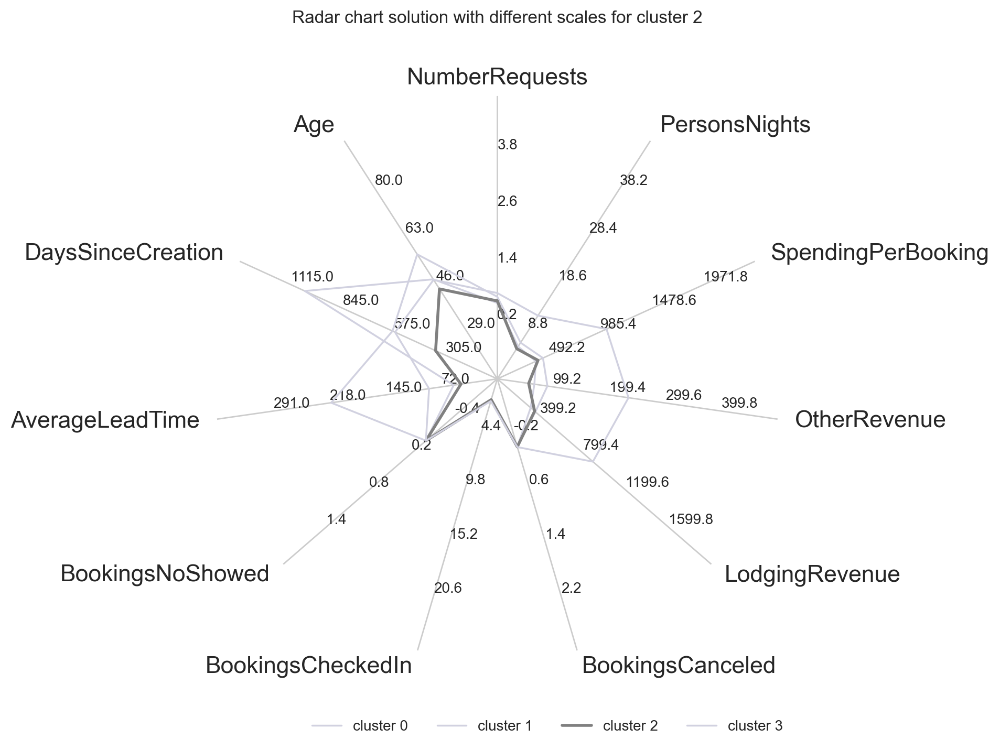

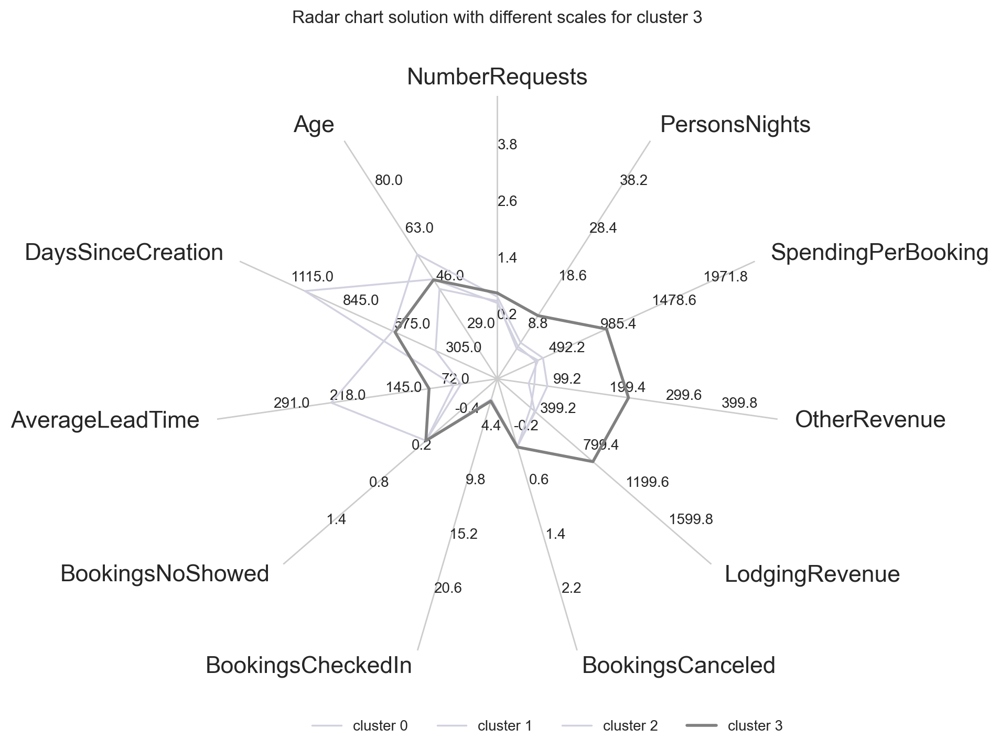

In [185]:
# highlighting each cluster in a different plot

for cluster in range(0, 4):

    format_cfg = {
    'rad_ln_args': {'visible': False},
    'outer_ring': {'visible': False},
    'rgrid_tick_lbls_args': {'fontsize': 10},
    'theta_tick_lbls': {'fontsize': 16},
    'theta_tick_lbls_pad': 5
    }   
    
    fig1 = plt.figure(figsize = (6, 6), dpi = 200)
    radar = ComplexRadar(fig1, variables, ranges, show_scales = True, format_cfg = format_cfg)
    
    for g in mean_results4.index:
        if g != (cluster):
            radar.plot(mean_results4.loc[g].values, label = f"cluster {g}", color = '#d1d1e0', linewidth = 1.25)
        else:
            radar.plot(mean_results4.loc[g].values, label = f"cluster {g}", color = '#808080', linewidth = 2)
        #radar.fill(mean_results5.loc[g].values, alpha = 0.5, color = c)

    radar.set_title('Radar chart solution with different scales for cluster ' + str(cluster), pad = 50)
    radar.use_legend(**{'loc': 'lower left', 'bbox_to_anchor': (0.15, -0.15), 'ncol': radar.plot_counter})
    plt.show() 

<a id = "classifying-outliers"></a>

### 4.3. Classifying outliers

This section provides an example of how it would work if a new customer was inserted in the database. The idea is to use a model to assign the new customers to one of the clusters already formed. To do that, the distance of the observation (with the same changes done for that observations as done for the training dataset) to each centroid of the cluster will be calculated, and the customer will be assigned to the closest cluster. This could be problematic if the clusters are not tighly packed, but is a good way to start. With the improvement of the database or the good results of this solution, it can be improved, by using another type of classification model (like a decision tree, for example).

[Back to Evaluation](#evaluation-index)

In [136]:
outliers.T

ID,10012,82827,43709,98791,16132,20455,23967,18198,20114,34543,...,64213,29794,47061,36167,39591,32477,77453,28814,31194,33651
Nationality,PRT,ESP,FIN,CAN,RUS,BRA,USA,FIN,BRA,USA,...,ISR,GBR,ESP,GBR,AUS,DEU,DEU,GBR,DEU,GBR
Age,57.0,32.0,36.0,68.0,37.0,67.0,24.0,46.0,39.0,78.0,...,15.0,72.0,46.0,70.0,75.0,74.0,35.0,78.0,80.0,70.0
DaysSinceCreation,1192,297,641,141,1101,1021,949,1070,1030,793,...,457,863,531,768,723,824,360,877,842,807
AverageLeadTime,119,81,0,262,32,173,7,103,110,504,...,142,434,10,426,483,414,56,75,396,468
LodgingRevenue,591.6,2300.1,606.0,3057.0,1071.9,2295.0,9682.4,2124.0,2200.8,234.0,...,3885.0,234.0,5123.5,702.0,234.0,140.8,1323.0,1170.0,140.8,702.0
OtherRevenue,798.0,21.0,580.0,508.0,558.4,300.0,1300.0,174.0,205.5,110.0,...,399.0,110.0,332.0,424.5,161.0,108.0,855.0,666.0,428.0,324.0
BookingsCanceled,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BookingsNoShowed,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BookingsCheckedIn,1,1,1,2,1,1,1,1,1,1,...,1,1,9,1,1,1,1,1,1,1
PersonsNights,16,10,4,12,21,16,12,8,20,6,...,21,6,45,6,6,4,6,6,4,6


In [137]:
# preparing the outliers to be reassigned

notimportant = ['Nationality']

outliers, notimportant = new_features(outliers, notimportant)
outliers.drop(metric_features_todrop + non_metric_features_todrop, axis = 1, inplace = True)
outliers, notimportant = create_continent(outliers, continent_dict, notimportant)
outliers, notimportant = ohc(outliers, ['DistributionChannel', 'Continent'])

In [138]:
# copying the dataset

df_outliers_to_minmax = outliers.copy()

Doing the same steps done for the training dataset: 1: Normalize; 2: PCA; 3: Predict using KMeans with 4 clusters.

In [139]:
# calling the function to scale the data and seeing the descriptive statistics

df_outliers_minmax = minmax_scaler(df_outliers_to_minmax, metric_features)
df_outliers_minmax[metric_features].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
PersonsNights,2579.0,0.03,0.04,0.0,0.01,0.01,0.03,1.0
BookingsCanceled,2579.0,0.00,0.05,0.0,0.00,0.00,0.00,1.0
Age,2579.0,0.43,0.19,0.0,0.29,0.45,0.59,1.0
BookingsCheckedIn,2579.0,0.01,0.04,0.0,0.00,0.00,0.00,1.0
SpendingPerBooking,2579.0,0.08,0.08,0.0,0.02,0.06,0.13,1.0
BookingsNoShowed,2579.0,0.00,0.03,0.0,0.00,0.00,0.00,1.0
LodgingRevenue,2579.0,0.05,0.06,0.0,0.01,0.03,0.09,1.0
DaysSinceCreation,2579.0,0.47,0.24,0.0,0.28,0.52,0.60,1.0
AverageLeadTime,2579.0,0.39,0.32,0.0,0.09,0.28,0.70,1.0
OtherRevenue,2579.0,0.05,0.06,0.0,0.01,0.03,0.07,1.0


In [140]:
# using the pca instance that was created earlier to apply the pca to the outliers
pca_feat_outliers = pca.transform(df_outliers_minmax[features_to_pca])

# converting the PCA to a dataframe
df_outliers_pca = pd.DataFrame(pca_feat_outliers, index = df_outliers_minmax.index, columns = pca_feat_names)

# reassigning df_pca to contain the new created PCA variables
df_outliers_minmax = pd.concat([df_outliers_minmax, df_outliers_pca], axis = 1)
df_outliers_minmax.head().T

ID,10012,82827,43709,98791,16132
Age,0.431373,0.186275,0.22549,0.539216,0.235294
DaysSinceCreation,0.857461,0.193022,0.448404,0.077209,0.789903
AverageLeadTime,0.202381,0.137755,0.0,0.445578,0.054422
LodgingRevenue,0.024524,0.095349,0.025121,0.126726,0.044435
OtherRevenue,0.090075,0.00237,0.065468,0.057341,0.06303
BookingsCanceled,0.0,0.0,0.0,0.0,0.0
BookingsNoShowed,0.0,0.0,0.0,0.0,0.0
BookingsCheckedIn,0.0,0.0,0.0,0.00641,0.0
PersonsNights,0.039894,0.023936,0.007979,0.029255,0.053191
DistributionChannel,Travel Agent/Operator,Travel Agent/Operator,Travel Agent/Operator,Direct,Travel Agent/Operator


In [141]:
# predicting the cluster labels of the outliers - using KMeans - 4 clusters solution

km_labels_outliers = kmclust_4.predict(df_outliers_minmax[pca_feat_names])

In [142]:
df_km_4_scaled_outliers = pd.concat((df_outliers_minmax, pd.Series(km_labels_outliers, name = 'KmLabels', index = df_outliers_minmax.index)), axis = 1)

df_km_4_outliers = pd.concat((df_outliers_to_minmax, pd.Series(km_labels_outliers, name = 'KmLabels', index = df_outliers_to_minmax.index)), axis = 1)
df_km_4_outliers.groupby('KmLabels').mean(numeric_only = True)

,Age,DaysSinceCreation,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,BookingsCheckedIn,PersonsNights,SRHighFloor,...,SpendingPerBooking,ohc_DistributionChannel_Direct,ohc_DistributionChannel_GDS Systems,ohc_DistributionChannel_Travel Agent/Operator,ohc_Continent_Asia,ohc_Continent_CentralAmerica,ohc_Continent_Europe,ohc_Continent_NorthAmerica,ohc_Continent_Oceania,ohc_Continent_SouthAmerica
KmLabels,,,,,,,,,,,,,,,,,,,,,
0,49.436494,999.030411,86.128801,1625.147424,660.452021,0.017889,0.003578,1.554562,13.432916,0.055456,...,1972.144156,0.227191,0.000000,0.740608,0.033989,0.001789,0.835420,0.041145,0.010733,0.050089
1,71.911321,809.773585,441.522642,286.705509,161.316538,0.000000,0.000000,1.017925,5.082075,0.008491,...,437.530404,0.004717,0.000000,0.995283,0.000000,0.000943,0.861321,0.058491,0.077358,0.000943
2,44.201893,325.512093,80.458465,2096.330904,586.165878,0.098843,0.021030,2.454259,14.677182,0.047319,...,2030.751223,0.259727,0.011567,0.679285,0.035752,0.000000,0.779180,0.107256,0.010515,0.045216
3,49.777778,395.333333,35.111111,12669.992222,3723.511111,4.333333,1.444444,61.888889,115.333333,0.111111,...,3507.078375,0.000000,0.000000,0.222222,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000


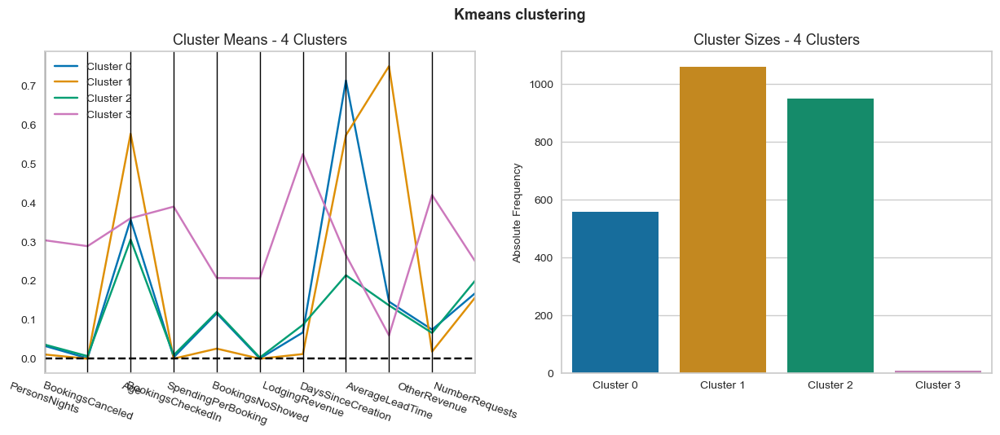

In [147]:
# profilling each cluster only considering the outliers classified

cluster_profiles(
    data = df_km_4_scaled_outliers[metric_features + ['KmLabels']], 
    label_columns = ['KmLabels'], 
    figsize = (15, 5), 
    compar_titles = ['Kmeans clustering']
)